# Week2 Fifa Dataset

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

In [2]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense,Dropout
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder,StandardScaler


2024-08-02 09:56:43.677150: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-08-02 09:56:43.811090: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-08-02 09:56:44.367200: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


In [3]:
df = pd.read_csv('fifa_19.csv',encoding = 'latin1')
df.head()

,Unnamed: 0,ID,Name,Age,Photo,Nationality,Flag,Overall,Potential,Club,...,Composure,Marking,StandingTackle,SlidingTackle,GKDiving,GKHandling,GKKicking,GKPositioning,GKReflexes,Release Clause
0,0,158023,L. Messi,31.0,https://cdn.sofifa.org/players/4/19/158023.png,Argentina,https://cdn.sofifa.org/flags/52.png,94.0,94,FC Barcelona,...,96.0,33.0,28.0,26.0,6.0,11.0,15.0,14.0,8.0,226.5M
1,1,20801,Cristiano Ronaldo,33.0,https://cdn.sofifa.org/players/4/19/20801.png,Portugal,https://cdn.sofifa.org/flags/38.png,94.0,94,Juventus,...,95.0,28.0,31.0,23.0,7.0,11.0,15.0,14.0,11.0,127.1M
2,2,190871,Neymar Jr,26.0,https://cdn.sofifa.org/players/4/19/190871.png,Brazil,https://cdn.sofifa.org/flags/54.png,92.0,93,Paris Saint-Germain,...,94.0,27.0,24.0,33.0,9.0,9.0,15.0,15.0,11.0,228.1M
3,3,193080,De Gea,27.0,https://cdn.sofifa.org/players/4/19/193080.png,Spain,https://cdn.sofifa.org/flags/45.png,91.0,93,Manchester United,...,68.0,15.0,21.0,13.0,90.0,85.0,87.0,88.0,94.0,138.6M
4,4,192985,K. De Bruyne,27.0,https://cdn.sofifa.org/players/4/19/192985.png,Belgium,https://cdn.sofifa.org/flags/7.png,91.0,92,Manchester City,...,88.0,68.0,58.0,51.0,15.0,13.0,5.0,10.0,13.0,196.4M


# Data Preprocessing

In [4]:
df.describe()

,Unnamed: 0,ID,Age,Overall,Potential,Special,International Reputation,Weak Foot,Skill Moves,Jersey Number,...,Penalties,Composure,Marking,StandingTackle,SlidingTackle,GKDiving,GKHandling,GKKicking,GKPositioning,GKReflexes
count,18207.000000,18207.000000,18206.000000,18206.000000,18207.000000,18207.000000,18159.000000,18159.000000,18159.000000,18147.000000,...,18159.000000,18159.000000,18159.000000,18159.000000,18159.000000,18159.000000,18159.000000,18159.000000,18159.000000,18159.000000
mean,9103.000000,214298.338606,25.122048,66.237449,71.307299,1597.809908,1.113222,2.947299,2.361308,19.546096,...,48.548598,58.648274,47.281623,47.697836,45.661435,16.616223,16.391596,16.232061,16.388898,16.710887
std,5256.052511,29965.244204,4.670022,6.907059,6.136496,272.586016,0.394031,0.660456,0.756164,15.947765,...,15.704053,11.436133,19.904397,21.664004,21.289135,17.695349,16.906900,16.502864,17.034669,17.955119
min,0.000000,16.000000,16.000000,46.000000,48.000000,731.000000,1.000000,1.000000,1.000000,1.000000,...,5.000000,3.000000,3.000000,2.000000,3.000000,1.000000,1.000000,1.000000,1.000000,1.000000
25%,4551.500000,200315.500000,21.000000,62.000000,67.000000,1457.000000,1.000000,3.000000,2.000000,8.000000,...,39.000000,51.000000,30.000000,27.000000,24.000000,8.000000,8.000000,8.000000,8.000000,8.000000
50%,9103.000000,221759.000000,25.000000,66.000000,71.000000,1635.000000,1.000000,3.000000,2.000000,17.000000,...,49.000000,60.000000,53.000000,55.000000,52.000000,11.000000,11.000000,11.000000,11.000000,11.000000
75%,13654.500000,236529.500000,28.000000,71.000000,75.000000,1787.000000,1.000000,3.000000,3.000000,26.000000,...,60.000000,67.000000,64.000000,66.000000,64.000000,14.000000,14.000000,14.000000,14.000000,14.000000
max,18206.000000,246620.000000,45.000000,94.000000,95.000000,2346.000000,5.000000,5.000000,5.000000,99.000000,...,92.000000,96.000000,94.000000,93.000000,91.000000,90.000000,92.000000,91.000000,90.000000,94.000000


In [5]:
df.columns

Index(['Unnamed: 0', 'ID', 'Name', 'Age', 'Photo', 'Nationality', 'Flag',
       'Overall', 'Potential', 'Club', 'Club Logo', 'Value', 'Wage', 'Special',
       'Preferred Foot', 'International Reputation', 'Weak Foot',
       'Skill Moves', 'Work Rate', 'Body Type', 'Real Face', 'Position',
       'Jersey Number', 'Joined', 'Loaned From', 'Contract Valid Until',
       'Height', 'Weight', 'LS', 'ST', 'RS', 'LW', 'LF', 'CF', 'RF', 'RW',
       'LAM', 'CAM', 'RAM', 'LM', 'LCM', 'CM', 'RCM', 'RM', 'LWB', 'LDM',
       'CDM', 'RDM', 'RWB', 'LB', 'LCB', 'CB', 'RCB', 'RB', 'Crossing',
       'Finishing', 'HeadingAccuracy', 'ShortPassing', 'Volleys', 'Dribbling',
       'Curve', 'FKAccuracy', 'LongPassing', 'BallControl', 'Acceleration',
       'SprintSpeed', 'Agility', 'Reactions', 'Balance', 'ShotPower',
       'Jumping', 'Stamina', 'Strength', 'LongShots', 'Aggression',
       'Interceptions', 'Positioning', 'Vision', 'Penalties', 'Composure',
       'Marking', 'StandingTackle', 'SlidingT

Preprocessing

In [6]:
df.isnull().sum()

Unnamed: 0           0
ID                   0
Name                 0
Age                  1
Photo                0
                  ... 
GKHandling          48
GKKicking           48
GKPositioning       48
GKReflexes          48
Release Clause    1564
Length: 89, dtype: int64

### Taking only Required Features along with position target variable

In [7]:
data_df = df[['Finishing', 'HeadingAccuracy', 'ShortPassing', 'Volleys', 'Dribbling', 'Curve', 'FKAccuracy',
'LongPassing', 'BallControl', 'Acceleration', 'SprintSpeed', 'Agility', 'Reactions', 'Balance',
'ShotPower', 'Jumping', 'Stamina', 'Strength', 'LongShots', 'Aggression','Interceptions',
'Positioning', 'Vision', 'Penalties', 'Composure', 'Marking', 'StandingTackle', 'SlidingTackle',
'GKDiving', 'GKHandling', 'GKKicking', 'GKPositioning', 'GKReflexes','Position']]
data_df.head()

,Finishing,HeadingAccuracy,ShortPassing,Volleys,Dribbling,Curve,FKAccuracy,LongPassing,BallControl,Acceleration,...,Composure,Marking,StandingTackle,SlidingTackle,GKDiving,GKHandling,GKKicking,GKPositioning,GKReflexes,Position
0,95.0,70.0,90.0,86.0,97.0,93.0,94.0,87.0,96.0,91.0,...,96.0,33.0,28.0,26.0,6.0,11.0,15.0,14.0,8.0,RF
1,94.0,89.0,81.0,87.0,88.0,81.0,76.0,77.0,94.0,89.0,...,95.0,28.0,31.0,23.0,7.0,11.0,15.0,14.0,11.0,ST
2,87.0,62.0,84.0,84.0,96.0,88.0,87.0,78.0,95.0,94.0,...,94.0,27.0,24.0,33.0,9.0,9.0,15.0,15.0,11.0,LW
3,13.0,21.0,50.0,13.0,18.0,21.0,19.0,51.0,42.0,57.0,...,68.0,15.0,21.0,13.0,90.0,85.0,87.0,88.0,94.0,GK
4,82.0,55.0,92.0,82.0,86.0,85.0,83.0,91.0,91.0,78.0,...,88.0,68.0,58.0,51.0,15.0,13.0,5.0,10.0,13.0,RCM


In [8]:
data_df.describe()

,Finishing,HeadingAccuracy,ShortPassing,Volleys,Dribbling,Curve,FKAccuracy,LongPassing,BallControl,Acceleration,...,Penalties,Composure,Marking,StandingTackle,SlidingTackle,GKDiving,GKHandling,GKKicking,GKPositioning,GKReflexes
count,18159.000000,18159.000000,18159.000000,18159.000000,18159.000000,18159.000000,18159.000000,18159.000000,18159.000000,18159.000000,...,18159.000000,18159.000000,18159.000000,18159.000000,18159.000000,18159.000000,18159.000000,18159.000000,18159.000000,18159.000000
mean,45.550911,52.298144,58.686712,42.909026,55.371001,47.170824,42.863153,52.711933,58.369459,64.614076,...,48.548598,58.648274,47.281623,47.697836,45.661435,16.616223,16.391596,16.232061,16.388898,16.710887
std,19.525820,17.379909,14.699495,17.694408,18.910371,18.395264,17.478763,15.327870,16.686595,14.927780,...,15.704053,11.436133,19.904397,21.664004,21.289135,17.695349,16.906900,16.502864,17.034669,17.955119
min,2.000000,4.000000,7.000000,4.000000,4.000000,6.000000,3.000000,9.000000,5.000000,12.000000,...,5.000000,3.000000,3.000000,2.000000,3.000000,1.000000,1.000000,1.000000,1.000000,1.000000
25%,30.000000,44.000000,54.000000,30.000000,49.000000,34.000000,31.000000,43.000000,54.000000,57.000000,...,39.000000,51.000000,30.000000,27.000000,24.000000,8.000000,8.000000,8.000000,8.000000,8.000000
50%,49.000000,56.000000,62.000000,44.000000,61.000000,48.000000,41.000000,56.000000,63.000000,67.000000,...,49.000000,60.000000,53.000000,55.000000,52.000000,11.000000,11.000000,11.000000,11.000000,11.000000
75%,62.000000,64.000000,68.000000,57.000000,68.000000,62.000000,57.000000,64.000000,69.000000,75.000000,...,60.000000,67.000000,64.000000,66.000000,64.000000,14.000000,14.000000,14.000000,14.000000,14.000000
max,95.000000,94.000000,93.000000,90.000000,97.000000,94.000000,94.000000,93.000000,96.000000,97.000000,...,92.000000,96.000000,94.000000,93.000000,91.000000,90.000000,92.000000,91.000000,90.000000,94.000000


In [9]:
data_df.isnull().sum()

Finishing          48
HeadingAccuracy    48
ShortPassing       48
Volleys            48
Dribbling          48
Curve              48
FKAccuracy         48
LongPassing        48
BallControl        48
Acceleration       48
SprintSpeed        48
Agility            48
Reactions          48
Balance            48
ShotPower          48
Jumping            48
Stamina            48
Strength           48
LongShots          48
Aggression         48
Interceptions      48
Positioning        48
Vision             48
Penalties          48
Composure          48
Marking            48
StandingTackle     48
SlidingTackle      48
GKDiving           48
GKHandling         48
GKKicking          48
GKPositioning      48
GKReflexes         48
Position           60
dtype: int64

In [10]:
data_df.shape

(18207, 34)

Since 18k rows dropping 60 rows wont make much difference

In [11]:
data_df = data_df.dropna()
data_df.isnull().sum()

Finishing          0
HeadingAccuracy    0
ShortPassing       0
Volleys            0
Dribbling          0
Curve              0
FKAccuracy         0
LongPassing        0
BallControl        0
Acceleration       0
SprintSpeed        0
Agility            0
Reactions          0
Balance            0
ShotPower          0
Jumping            0
Stamina            0
Strength           0
LongShots          0
Aggression         0
Interceptions      0
Positioning        0
Vision             0
Penalties          0
Composure          0
Marking            0
StandingTackle     0
SlidingTackle      0
GKDiving           0
GKHandling         0
GKKicking          0
GKPositioning      0
GKReflexes         0
Position           0
dtype: int64

In [12]:
data_df['Position'].dtype

dtype('O')

In [13]:
data_df['Position'].value_counts()

Position
ST     2152
GK     2025
CB     1778
CM     1394
LB     1322
RB     1291
RM     1124
LM     1095
CAM     958
CDM     948
RCB     662
LCB     648
LCM     395
RCM     391
LW      381
RW      370
RDM     248
LDM     243
LS      207
RS      203
RWB      87
LWB      78
CF       74
LAM      21
RAM      21
RF       16
LF       15
Name: count, dtype: int64

### Mapping the target variable to 4 classes

In [14]:
Goalkeeper = ["GK"]
Forward_Player = ["ST", "LW", "RW", "LF", "RF", "RS","LS", "CF"]
Midfielder_Player = ["CM", "RCM", "LCM", "CDM", "RDM", "LDM", "CAM", "LAM",
"RAM", "RM", "LM"]
Defender_Player = ["CB", "RCB", "LCB", "LWB", "RWB", "LB", "RB"]
def target_variable_changing(x:str):
    x = x.upper()
    if x in Goalkeeper:
        return "Goalkeeper"
    elif x in Forward_Player:
        return "Forward"
    elif x in Midfielder_Player:
        return "Midfielder"
    elif x in Defender_Player:
        return "Defender"

In [15]:
# applying the function
data_df['Position'] = data_df['Position'].apply(target_variable_changing)
data_df.head()

,Finishing,HeadingAccuracy,ShortPassing,Volleys,Dribbling,Curve,FKAccuracy,LongPassing,BallControl,Acceleration,...,Composure,Marking,StandingTackle,SlidingTackle,GKDiving,GKHandling,GKKicking,GKPositioning,GKReflexes,Position
0,95.0,70.0,90.0,86.0,97.0,93.0,94.0,87.0,96.0,91.0,...,96.0,33.0,28.0,26.0,6.0,11.0,15.0,14.0,8.0,Forward
1,94.0,89.0,81.0,87.0,88.0,81.0,76.0,77.0,94.0,89.0,...,95.0,28.0,31.0,23.0,7.0,11.0,15.0,14.0,11.0,Forward
2,87.0,62.0,84.0,84.0,96.0,88.0,87.0,78.0,95.0,94.0,...,94.0,27.0,24.0,33.0,9.0,9.0,15.0,15.0,11.0,Forward
3,13.0,21.0,50.0,13.0,18.0,21.0,19.0,51.0,42.0,57.0,...,68.0,15.0,21.0,13.0,90.0,85.0,87.0,88.0,94.0,Goalkeeper
4,82.0,55.0,92.0,82.0,86.0,85.0,83.0,91.0,91.0,78.0,...,88.0,68.0,58.0,51.0,15.0,13.0,5.0,10.0,13.0,Midfielder


In [16]:
data_df['Position'].value_counts()

Position
Midfielder    6838
Defender      5866
Forward       3418
Goalkeeper    2025
Name: count, dtype: int64

#### One Hot Encoding the target variable

In [17]:
# one hot Encoding the target variable for multiclass classification and storing it in a new data frame
from sklearn.preprocessing import OneHotEncoder
one_hot_encoder = OneHotEncoder()
one_hot_encoded_target = one_hot_encoder.fit_transform(data_df[['Position']])
one_hot_encoded_target_df = pd.DataFrame(one_hot_encoded_target.toarray(), columns=one_hot_encoder.get_feature_names_out(['Position']))
one_hot_encoded_target_df.head()

,Position_Defender,Position_Forward,Position_Goalkeeper,Position_Midfielder
0,0.0,1.0,0.0,0.0
1,0.0,1.0,0.0,0.0
2,0.0,1.0,0.0,0.0
3,0.0,0.0,1.0,0.0
4,0.0,0.0,0.0,1.0


In [18]:
one_hot_encoded_target_df.shape

(18147, 4)

In [19]:
data_df.shape

(18147, 34)

### Train and Test Split

In [20]:
# Splitting the Dataset into Train and test
X = data_df.drop('Position', axis=1)
y = one_hot_encoded_target_df
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=42)

In [21]:
X_train

,Finishing,HeadingAccuracy,ShortPassing,Volleys,Dribbling,Curve,FKAccuracy,LongPassing,BallControl,Acceleration,...,Penalties,Composure,Marking,StandingTackle,SlidingTackle,GKDiving,GKHandling,GKKicking,GKPositioning,GKReflexes
2152,45.0,68.0,70.0,41.0,61.0,45.0,46.0,69.0,69.0,71.0,...,51.0,68.0,78.0,77.0,71.0,13.0,9.0,1.0,13.0,7.0
5023,59.0,58.0,67.0,67.0,77.0,77.0,73.0,63.0,75.0,68.0,...,65.0,73.0,41.0,30.0,32.0,10.0,11.0,7.0,11.0,6.0
17179,18.0,50.0,43.0,21.0,49.0,29.0,19.0,37.0,42.0,61.0,...,33.0,42.0,50.0,60.0,56.0,11.0,11.0,12.0,14.0,6.0
9748,10.0,10.0,11.0,11.0,19.0,16.0,12.0,11.0,23.0,13.0,...,21.0,63.0,18.0,19.0,11.0,70.0,62.0,51.0,59.0,74.0
12829,29.0,49.0,36.0,32.0,63.0,39.0,37.0,33.0,58.0,71.0,...,49.0,59.0,62.0,66.0,70.0,8.0,7.0,10.0,13.0,8.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11289,32.0,51.0,61.0,51.0,65.0,58.0,47.0,57.0,63.0,77.0,...,45.0,58.0,64.0,57.0,59.0,14.0,14.0,11.0,11.0,7.0
11969,13.0,19.0,20.0,18.0,15.0,17.0,17.0,25.0,17.0,35.0,...,17.0,60.0,11.0,11.0,11.0,64.0,61.0,62.0,64.0,65.0
5391,47.0,67.0,69.0,47.0,65.0,53.0,55.0,69.0,59.0,49.0,...,58.0,62.0,65.0,71.0,64.0,13.0,16.0,9.0,16.0,12.0
860,73.0,59.0,81.0,58.0,77.0,80.0,76.0,80.0,80.0,55.0,...,73.0,71.0,58.0,76.0,62.0,11.0,14.0,7.0,12.0,14.0


In [22]:
y_train

,Position_Defender,Position_Forward,Position_Goalkeeper,Position_Midfielder
2152,1.0,0.0,0.0,0.0
5022,0.0,0.0,0.0,1.0
17122,1.0,0.0,0.0,0.0
9745,0.0,0.0,1.0,0.0
12824,1.0,0.0,0.0,0.0
...,...,...,...,...
11284,1.0,0.0,0.0,0.0
11964,0.0,0.0,1.0,0.0
5390,0.0,0.0,0.0,1.0
860,0.0,0.0,0.0,1.0


#### Scaling the DataSet

In [23]:
#Scaling the Dataset
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

In [24]:
X_train

array([[-0.028944  ,  0.90119949,  0.7714331 , ..., -0.92258731,
        -0.19797352, -0.54027688],
       [ 0.68721093,  0.32569812,  0.56740549, ..., -0.55876951,
        -0.31548623, -0.59600416],
       [-1.41009993, -0.13470298, -1.06481546, ..., -0.25558802,
        -0.13921716, -0.59600416],
       ...,
       [ 0.07336385,  0.84364936,  0.7034239 , ..., -0.43749691,
        -0.02170445, -0.26164047],
       [ 1.40336585,  0.38324826,  1.51953437, ..., -0.55876951,
        -0.25672987, -0.15018591],
       [ 0.68721093,  0.26814798, -1.20083387, ..., -0.31622432,
        -0.4917553 , -0.42882232]])

## Model Experimentation

In [25]:
import matplotlib.pyplot as plt
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Input, Dense
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.metrics import Recall, Precision

Determining the Number of neurons for the hidden layers

In [26]:
from sklearn.metrics import classification_report
hidden_layers = [1,2,3]
no_of_neurons = [256,128,64,32]
no_of_epochs = [10,20,30,50,100]
batch_size = 32
learning_rate = 0.01

performance = []#to hold wrt all the data
epochs_accuracy = []#to hold the data corresponding to the epoch vs accuracy
epochs_loss = []#to hold the data corresponding to the epoch vs loss
test_set_classification_report = []#to hold the classification report wrt to the test data
model_train_vs_validation = []#hold the train and validation data of model wrt loss
model_train_vs_validation_accuracy = []#hold the train and validation data of model wrt accuracy
model_train_vs_test_accuracy = []#hold the train and test data of model wrt accuracy

'''
trying to get the best neurons and all for the best model
'''
def model_experimentation():
  for i in hidden_layers:
      for j in no_of_neurons:
          for k in no_of_epochs:
                print(f"Hidden Layers: {i}, Neurons: {j}, Epochs: {k}, Batch Size: 32, Learning Rate: 0.01")
                print('---------------------------------------------------------------')
                # Create the model
                print('Creating the Model')
                print('---------------------------------------------------------------')
                model = Sequential()
                model.add(Dense(j,input_dim=X_train.shape[1],activation='relu'))
                for _ in range(i-1):
                    model.add(Dense(j,activation='relu'))
                model.add(Dense(y_train.shape[1],activation='softmax'))
                print(f'Model Created with Hidden Layers: {i}, Neurons: {j}, Epochs: {k}, Batch Size: 32, Learning Rate: 0.01 ')
                print('---------------------------------------------------------------')
                print('Compiling the Model')
                model.compile(loss='categorical_crossentropy',optimizer=Adam(learning_rate=learning_rate),metrics=['accuracy',Recall(name='recall'),Precision(name='precision')])
                print('Model Compile Done')
                print('---------------------------------------------------------------')
                print('Fitting the Model')
                history = model.fit(X_train,y_train,epochs=k,batch_size=batch_size,validation_split=0.1,verbose=0)
                print('Model Fit Done')
                print('---------------------------------------------------------------')
                print('Get The Training Details')
                train_loss = history.history['loss']
                val_loss = history.history['val_loss']
                train_accuracy = history.history['accuracy']
                val_accuracy = history.history['val_accuracy']
                train_recall = history.history['recall']
                val_recall = history.history['val_recall']
                train_precision = history.history['precision']
                val_precision = history.history['val_precision']
                #generate the classification report
                y_pred = model.predict(X_test)
                y_pred = np.argmax(y_pred, axis=1)
                y_true = np.argmax(y_test.values, axis=1)
                classification_report_str = classification_report(y_true, y_pred)
                print('---------------------------------------------------------------')
                print('Evaluating the Model')
                test_loss,test_accuracy,test_recall,test_precision = model.evaluate(X_test,y_test,verbose=0)
                print('Model Evaluation Done')
                print('---------------------------------------------------------------')
                print('Model Details')
                print('---------------------------------------------------------------')
                print(f'Hidden Layers: {i}, Neurons: {j}, Epochs: {k}, Batch Size: 32, Learning Rate: 0.01')
                print('---------------------------------------------------------------')
                print('---------------------------------------------------------------')
                print(f'Training Loss: {train_loss[-1]}, Validation Loss: {val_loss[-1]}')
                print(f'Training Accuracy: {train_accuracy[-1]}, Validation Accuracy: {val_accuracy[-1]}')
                print(f'Training Recall: {train_recall[-1]}, Validation Recall: {val_recall[-1]}')
                print(f'Training Precision: {train_precision[-1]}, Validation Precision: {val_precision[-1]}')
                print('---------------------------------------------------------------')
                print('---------------------------------------------------------------')
                print(f'Test Loss: {test_loss}, Test Accuracy: {test_accuracy}, Test Recall: {test_recall}, Test Precision: {test_precision}')
                print('---------------------------------------------------------------')
                #passing the data to models now
                #i-hidden layers j-neurons k-epochs m-learning rate
                performance.append([i,j,k,0.01,train_loss[-1],train_accuracy[-1],train_precision[-1],train_recall[-1],val_loss[-1],val_accuracy[-1],val_precision[-1],val_recall[-1],test_loss,test_accuracy,test_recall,test_precision])
                epochs_accuracy.append([i,j,k,0.01,train_accuracy,val_accuracy])
                epochs_loss.append([i,j,k,0.01,train_loss,val_loss])
                model_train_vs_validation.append([i,j,k,0.01,train_loss,val_loss])
                model_train_vs_validation_accuracy.append([i,j,k,0.01,train_accuracy,val_accuracy])
                model_train_vs_test_accuracy.append([i,j,k,0.01,train_accuracy,test_accuracy])
                test_set_classification_report.append([i,j,k,0.01,classification_report_str])
                print('---------------------------------------------------------------')

In [27]:
model_experimentation()

Hidden Layers: 1, Neurons: 256, Epochs: 10, Batch Size: 32, Learning Rate: 0.01
---------------------------------------------------------------
Creating the Model
---------------------------------------------------------------


2024-08-02 09:56:45.432140: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-08-02 09:56:45.502843: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-08-02 09:56:45.502959: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

Model Created with Hidden Layers: 1, Neurons: 256, Epochs: 10, Batch Size: 32, Learning Rate: 0.01 
---------------------------------------------------------------
Compiling the Model
Model Compile Done
---------------------------------------------------------------
Fitting the Model


2024-08-02 09:56:47.340050: I tensorflow/compiler/xla/stream_executor/cuda/cuda_blas.cc:606] TensorFloat-32 will be used for the matrix multiplication. This will only be logged once.
2024-08-02 09:56:47.369468: I tensorflow/compiler/xla/service/service.cc:168] XLA service 0x7fd3749240b0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2024-08-02 09:56:47.369482: I tensorflow/compiler/xla/service/service.cc:176]   StreamExecutor device (0): NVIDIA GeForce RTX 3060, Compute Capability 8.6
2024-08-02 09:56:47.387396: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:255] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2024-08-02 09:56:47.526079: I tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:432] Loaded cuDNN version 8600
2024-08-02 09:56:47.636579: I ./tensorflow/compiler/jit/device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the p

Model Fit Done
---------------------------------------------------------------
Get The Training Details
57/57 [==============================] - 0s 385us/step
---------------------------------------------------------------
Evaluating the Model
Model Evaluation Done
---------------------------------------------------------------
Model Details
---------------------------------------------------------------
Hidden Layers: 1, Neurons: 256, Epochs: 10, Batch Size: 32, Learning Rate: 0.01
---------------------------------------------------------------
---------------------------------------------------------------
Training Loss: 0.2860698997974396, Validation Loss: 0.3172537684440613
Training Accuracy: 0.8789631128311157, Validation Accuracy: 0.8739290237426758
Training Recall: 0.8777384757995605, Validation Recall: 0.8727050423622131
Training Precision: 0.8803739547729492, Validation Precision: 0.8753836750984192
---------------------------------------------------------------
--------------

# Tabulating the All model Data wrt train,validation and test

In [28]:
# making the performance dataframe
performance_df = pd.DataFrame(performance,columns=['Hidden Layers','Neurons','Epochs','Learning Rate','Training Loss','Training Accuracy','Training Precision','Training Recall','Validation Loss','Validation Accuracy','Validation Precision','Validation Recall','Test Loss','Test Accuracy','Test Recall','Test Precision'])
performance_df

,Hidden Layers,Neurons,Epochs,Learning Rate,Training Loss,Training Accuracy,Training Precision,Training Recall,Validation Loss,Validation Accuracy,Validation Precision,Validation Recall,Test Loss,Test Accuracy,Test Recall,Test Precision
0,1,256,10,0.01,0.286070,0.878963,0.880374,0.877738,0.317254,0.873929,0.875384,0.872705,0.267382,0.891460,0.890358,0.892325
1,1,256,20,0.01,0.271260,0.887604,0.888821,0.886583,0.350615,0.864749,0.865113,0.863525,0.302701,0.887052,0.885950,0.888889
2,1,256,30,0.01,0.240521,0.900395,0.900736,0.899510,0.448614,0.856181,0.856967,0.854345,0.370954,0.862259,0.861157,0.863059
3,1,256,50,0.01,0.208224,0.914002,0.914640,0.913458,0.540088,0.868421,0.870552,0.868421,0.376330,0.869972,0.868870,0.869829
4,1,256,100,0.01,0.189230,0.927065,0.927462,0.926453,1.005925,0.847613,0.848039,0.847001,0.565538,0.871074,0.869972,0.872858
5,1,128,10,0.01,0.282830,0.884134,0.885114,0.882705,0.306862,0.878825,0.879215,0.877601,0.268157,0.894215,0.894215,0.895201
6,1,128,20,0.01,0.268869,0.890257,0.891245,0.889305,0.383461,0.872093,0.875154,0.870869,0.308991,0.879890,0.878788,0.882678
7,1,128,30,0.01,0.246836,0.899306,0.900464,0.898626,0.418009,0.864749,0.864666,0.864137,0.324514,0.880441,0.880441,0.882385
8,1,128,50,0.01,0.216483,0.908627,0.909345,0.907674,0.523265,0.854345,0.854690,0.853121,0.426712,0.874380,0.874380,0.874862
9,1,128,100,0.01,0.181608,0.923935,0.924539,0.923595,0.933161,0.851897,0.852851,0.851285,0.724202,0.858953,0.858953,0.860850


### Plotting the Epochs vs loss and Epochs vs Accuracy curves for each Model

In [58]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

# Function to plot training and validation loss vs epochs
def plot_loss_vs_epochs(epochs_loss, hidden_layer, neurons, epochs):
    for record in epochs_loss:
        hl, n, epochs, lr, train_loss, val_loss = record
        if hl == hidden_layer and n == neurons and epochs == epochs:
            plt.plot(range(1, epochs + 1), train_loss, label='Training Loss')
            plt.plot(range(1, epochs + 1), val_loss, label='Validation Loss')
            plt.title(f'Loss vs Epochs (Hidden Layers: {hl}, Neurons: {n}, Learning Rate: {lr})')
            plt.xlabel('Epochs')
            plt.ylabel('Loss')
            plt.legend()
            plt.show()

# Function to plot training and validation accuracy vs epochs
def plot_accuracy_vs_epochs(epochs_accuracy, hidden_layer, neurons, epochs):
    for record in epochs_accuracy:
        hl, n, epochs, lr, train_accuracy, val_accuracy = record
        if hl == hidden_layer and n == neurons and epochs == epochs:
            plt.plot(range(1, epochs + 1), train_accuracy, label='Training Accuracy')
            plt.plot(range(1, epochs + 1), val_accuracy, label='Validation Accuracy')
            plt.title(f'Accuracy vs Epochs (Hidden Layers: {hl}, Neurons: {n}, Learning Rate: {lr})')
            plt.xlabel('Epochs')
            plt.ylabel('Accuracy')
            plt.legend()
            plt.show()

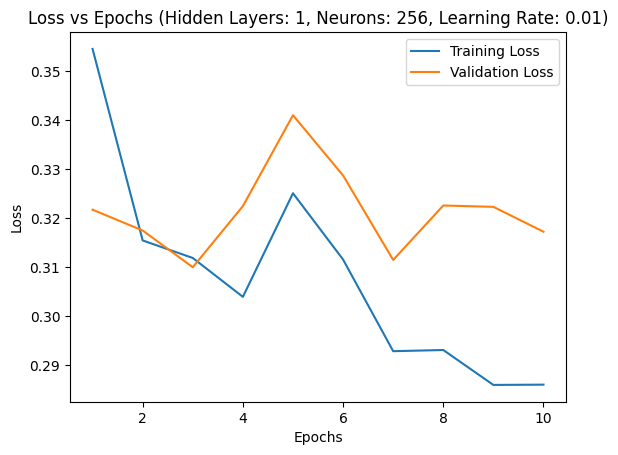

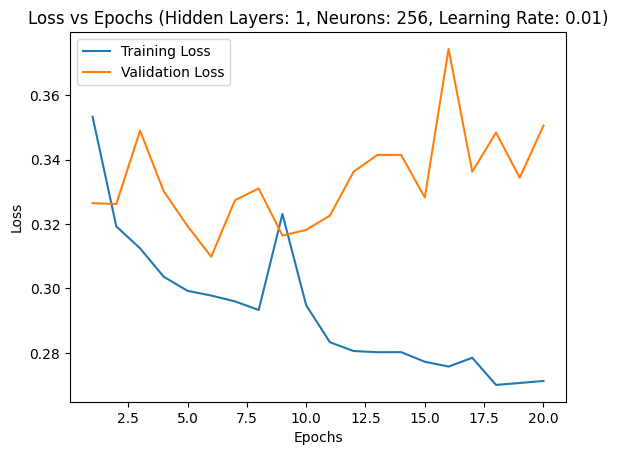

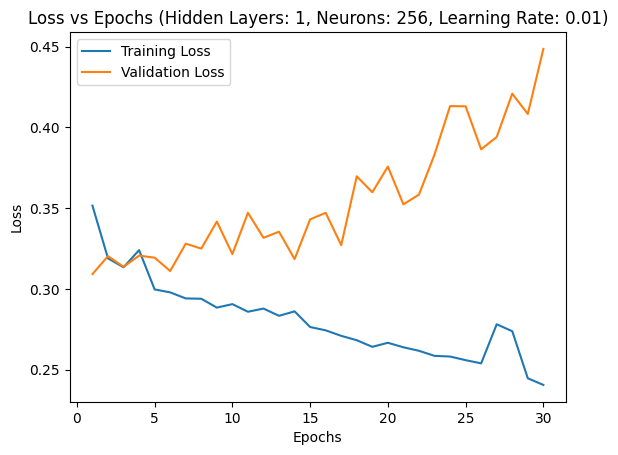

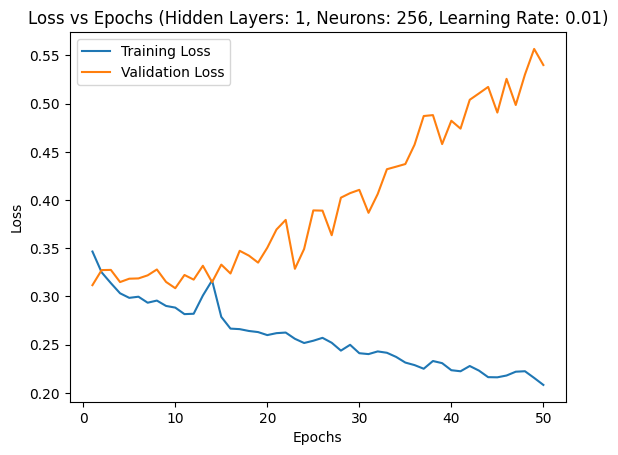

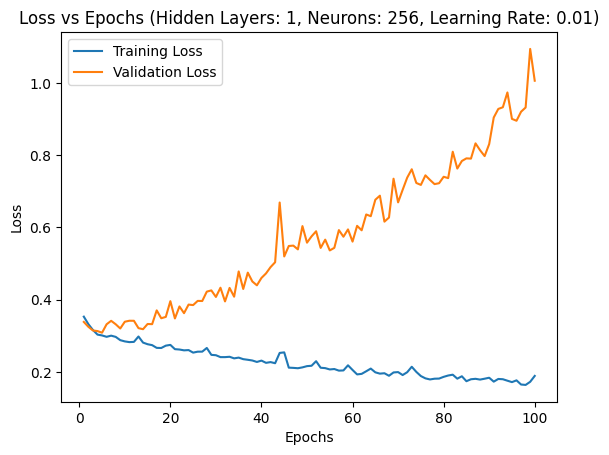

...

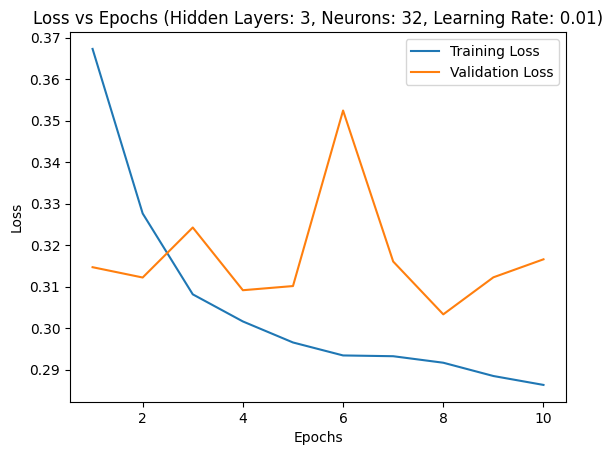

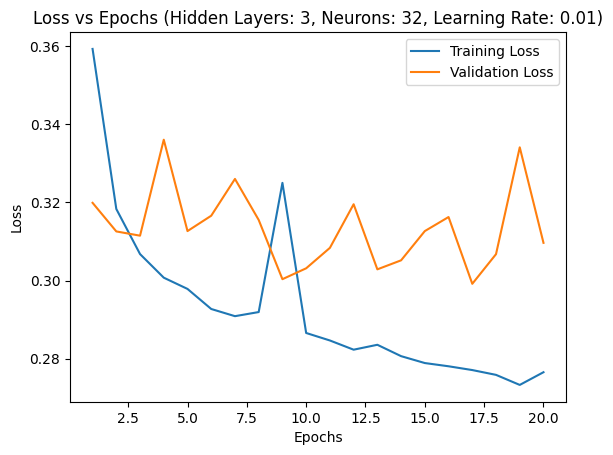

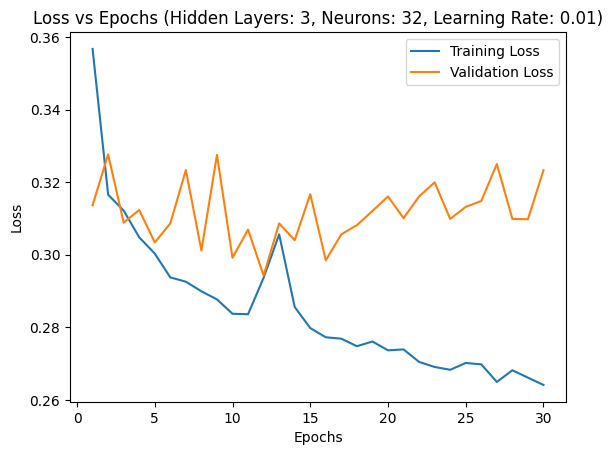

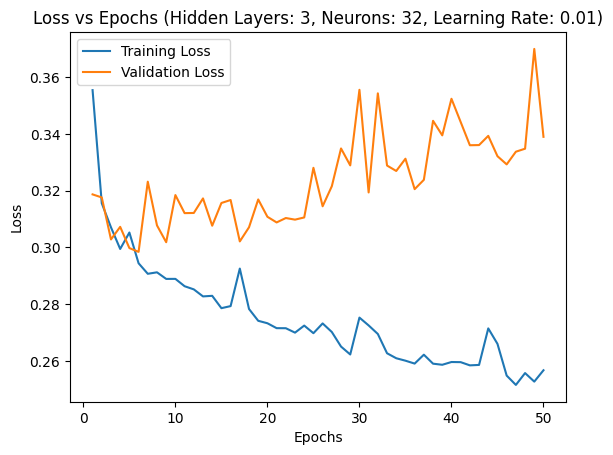

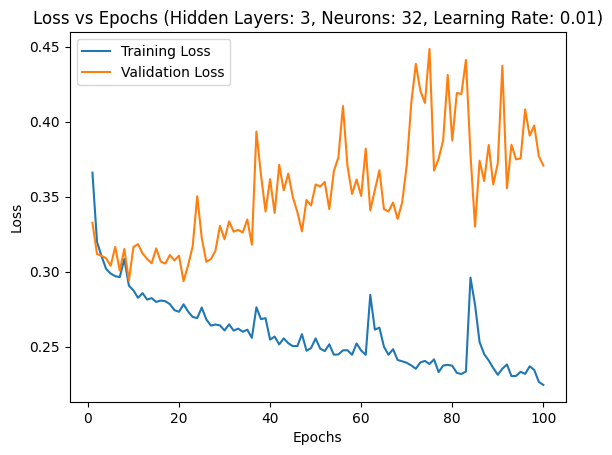

In [57]:
# plot for each layer the epochs and loss plot
hidden_layers = [1,2,3]
no_of_neurons = [256,128,64,32]
no_of_epochs = [10,20,30,50,100]
learning_rate = 0.01
for i in hidden_layers:
    for j in no_of_neurons:
        for k in no_of_epochs:
            plot_loss_vs_epochs(epochs_loss, i, j, k)

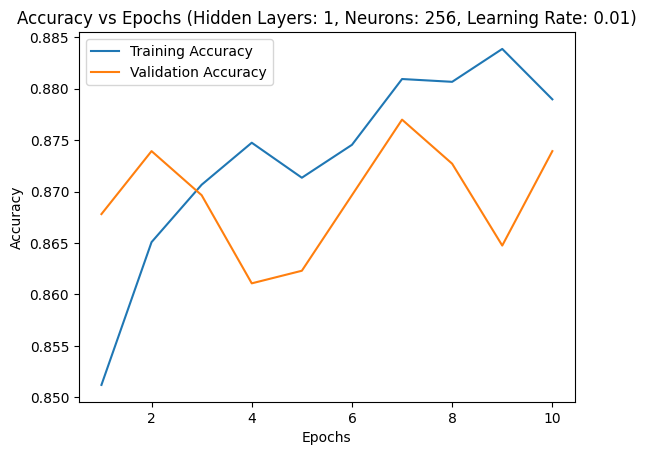

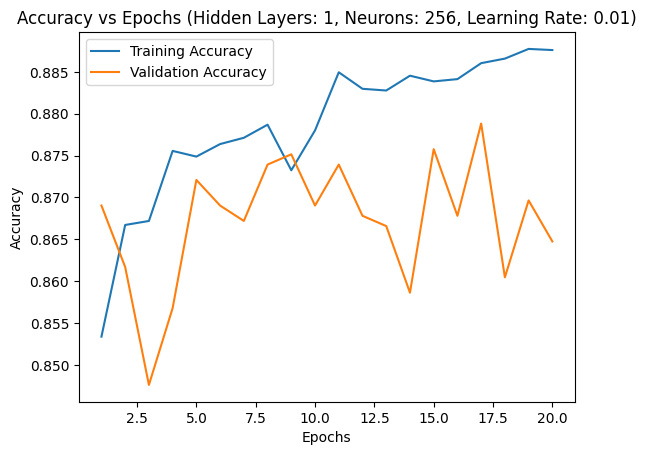

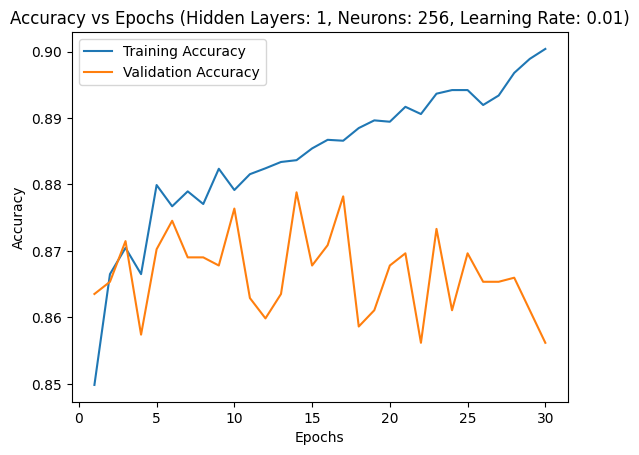

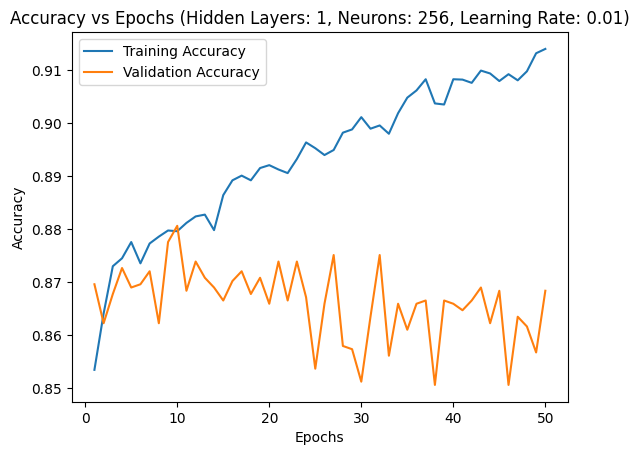

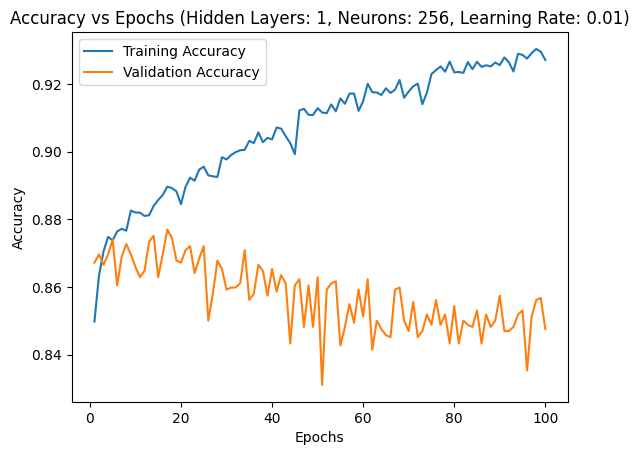

---------------------------------------------------------------


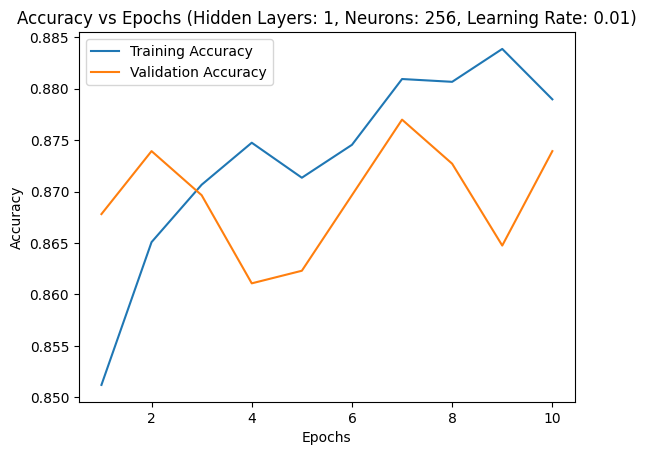

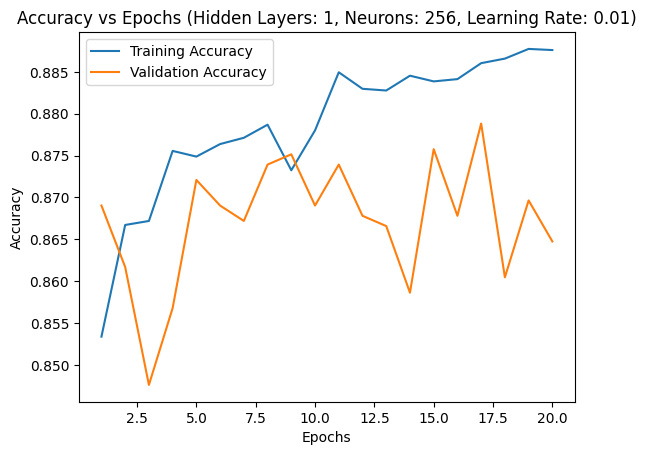

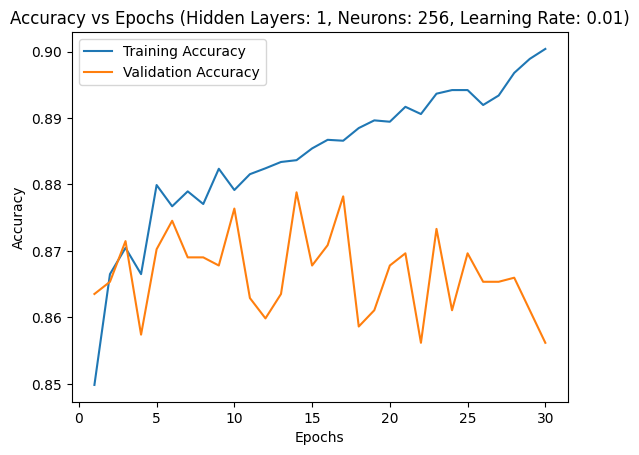

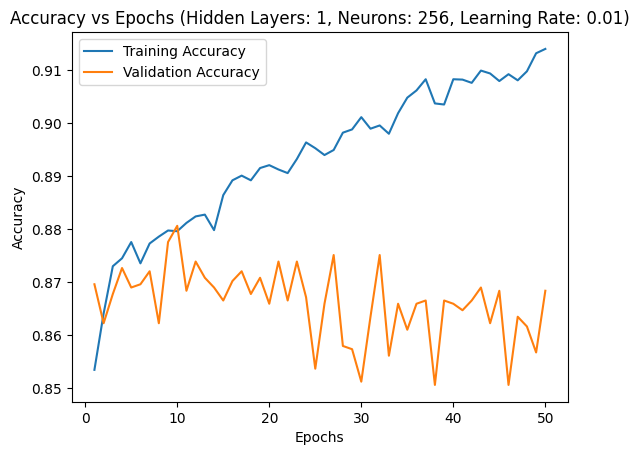

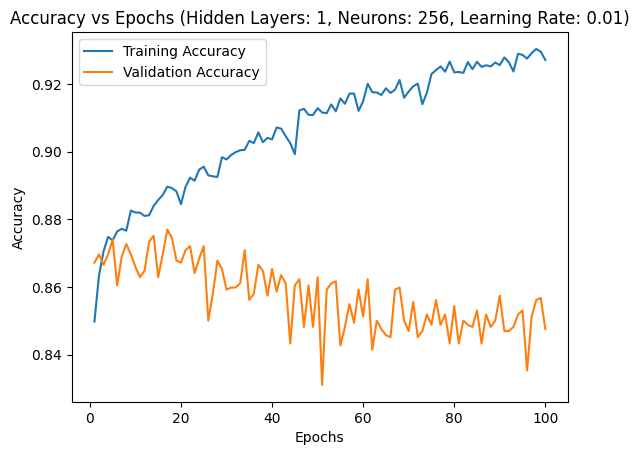

---------------------------------------------------------------


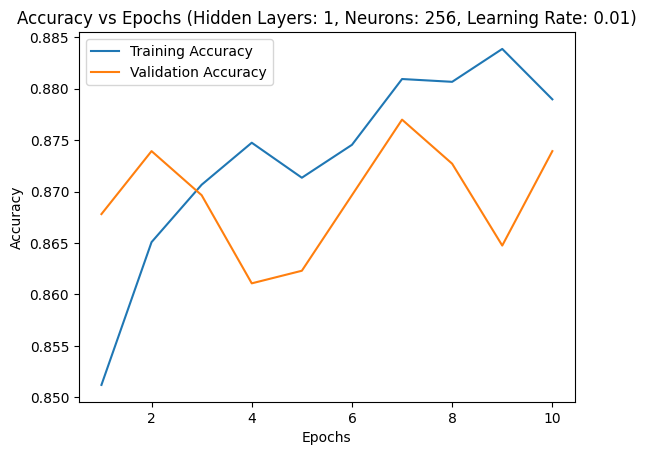

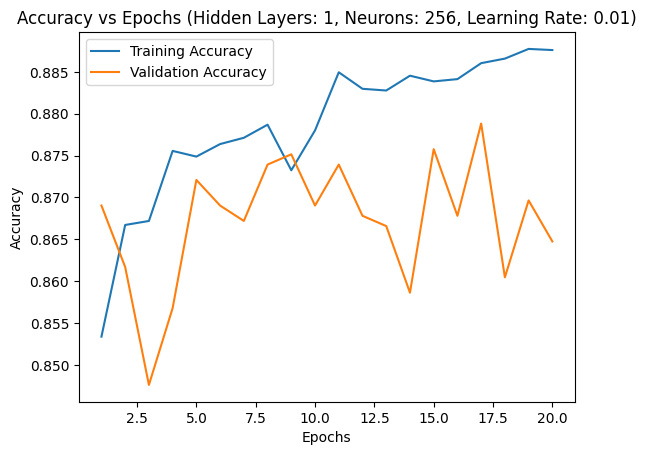

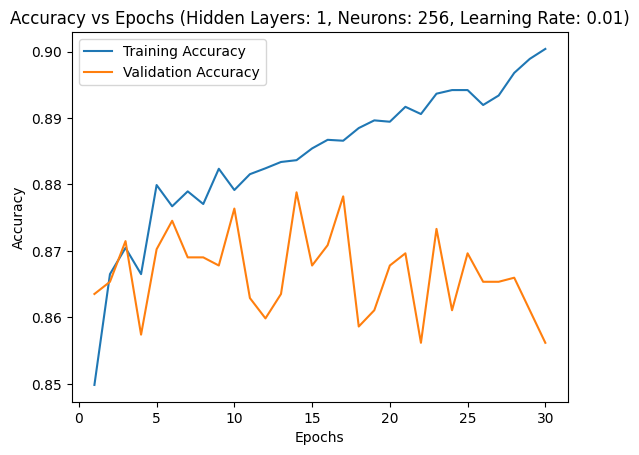

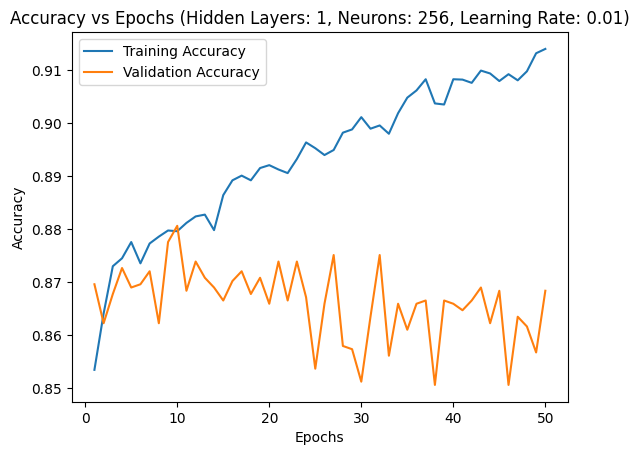

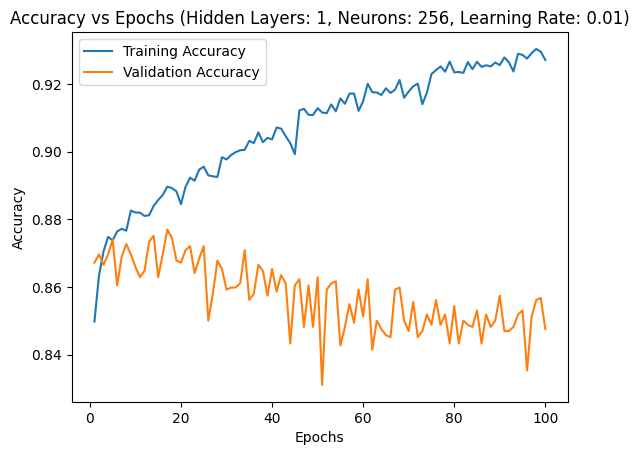

---------------------------------------------------------------


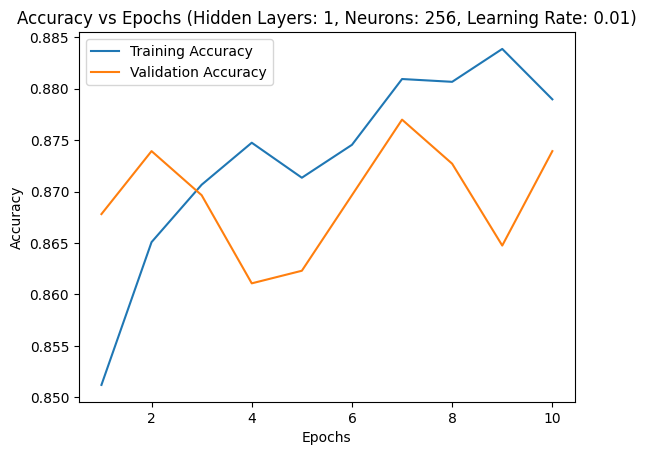

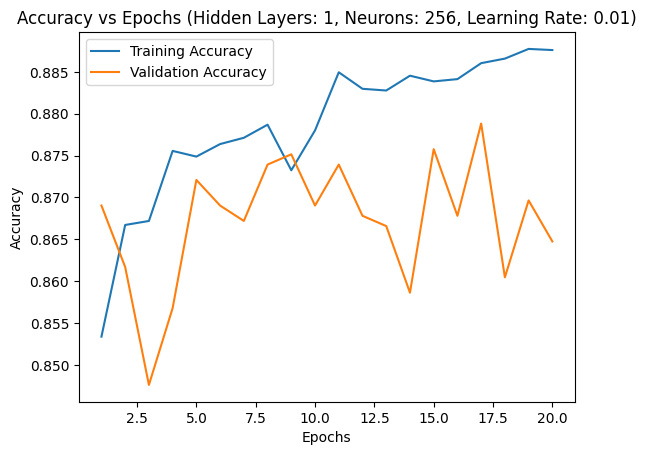

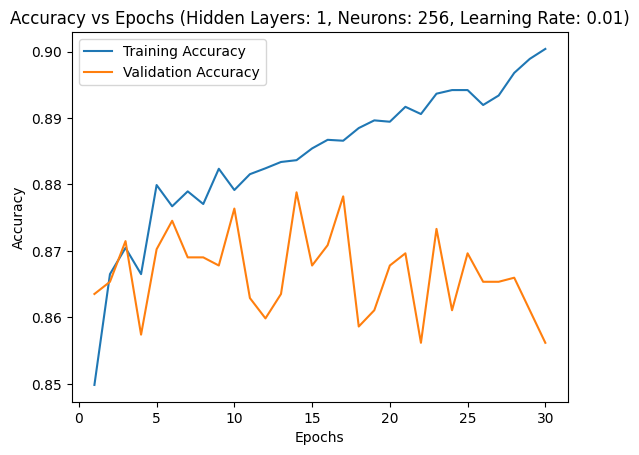

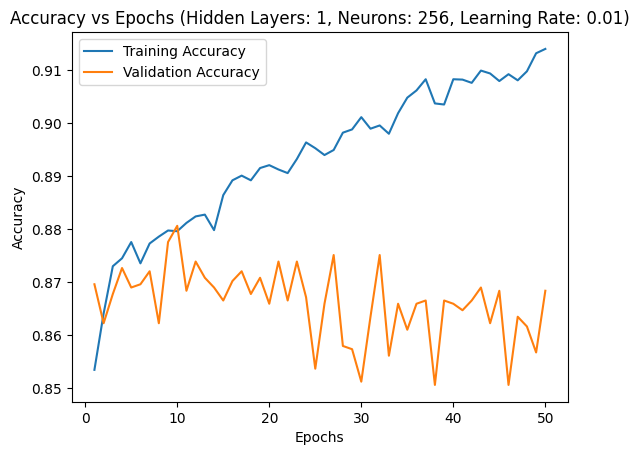

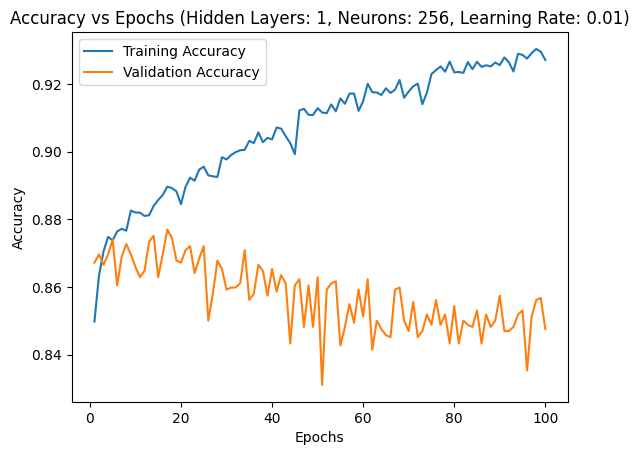

---------------------------------------------------------------


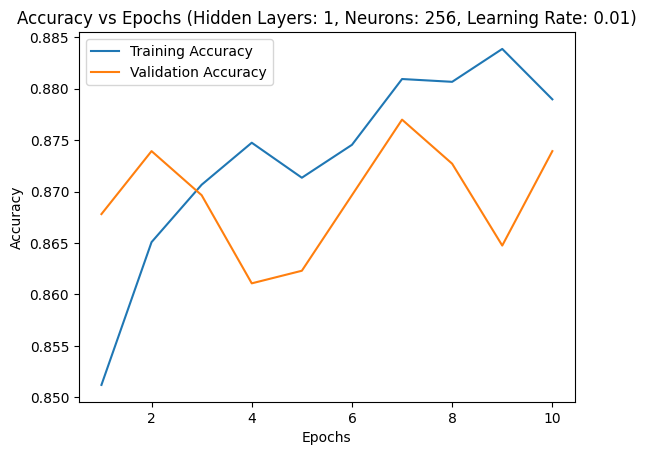

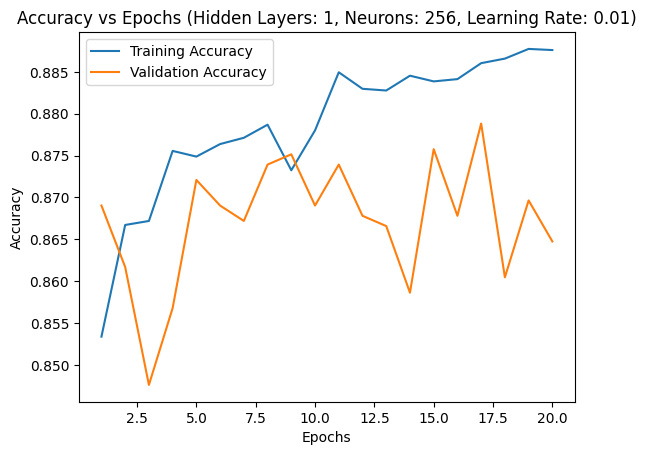

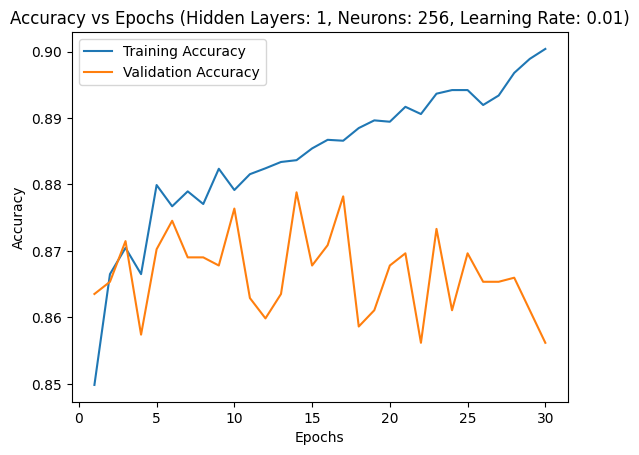

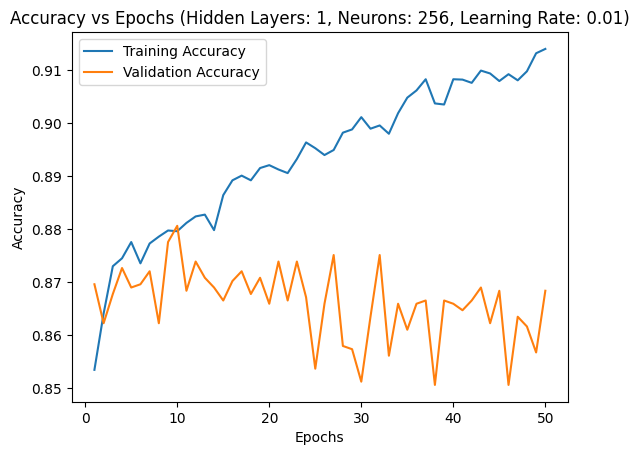

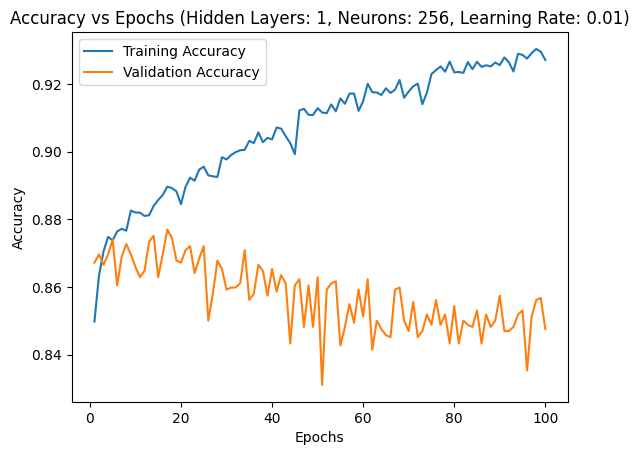

---------------------------------------------------------------


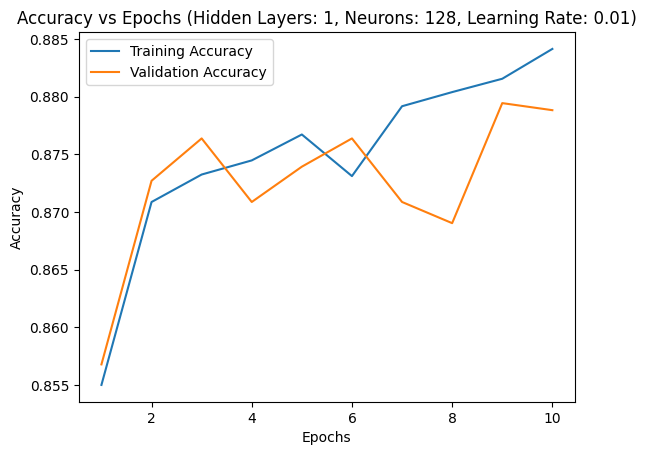

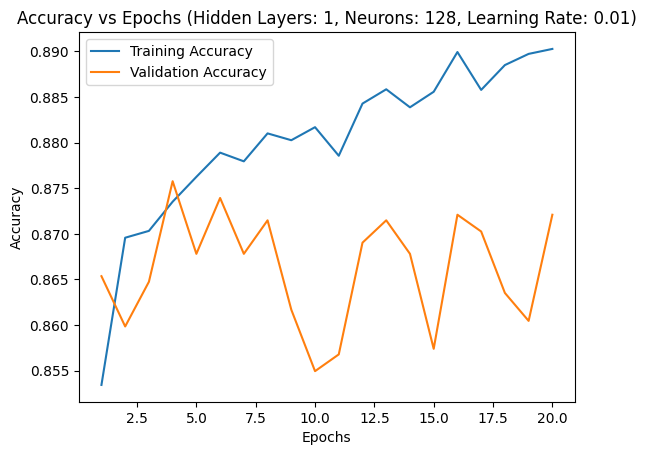

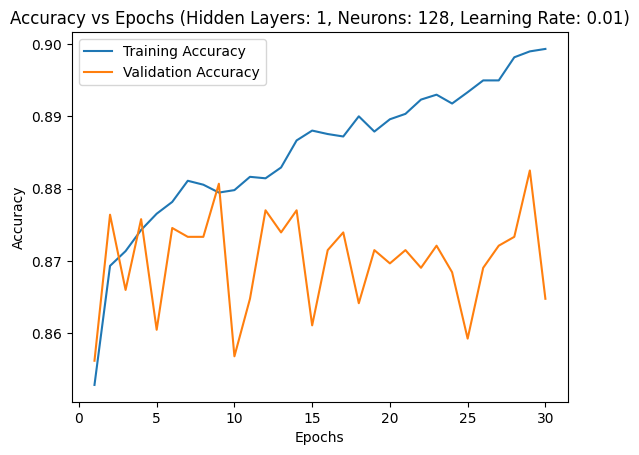

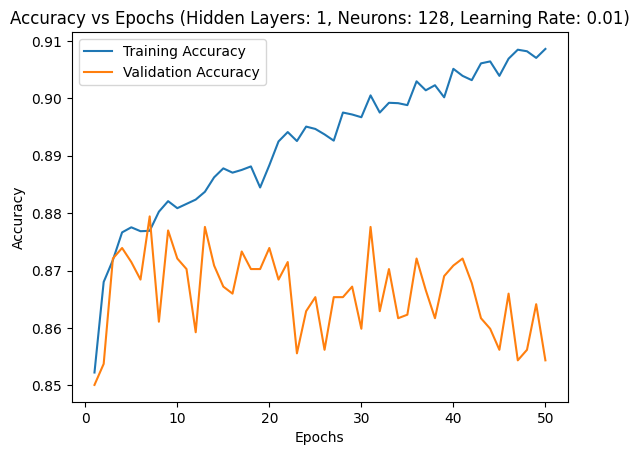

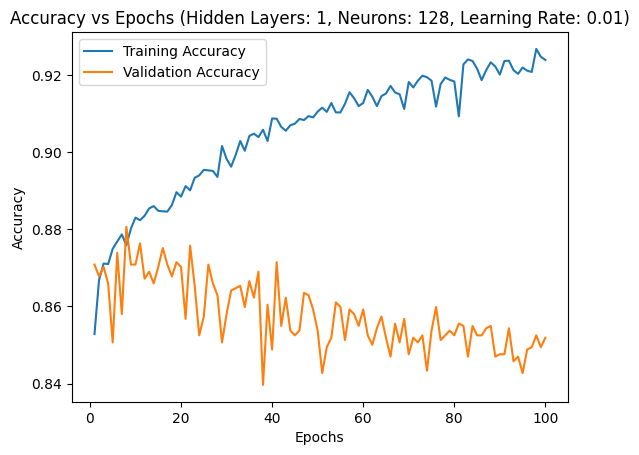

---------------------------------------------------------------


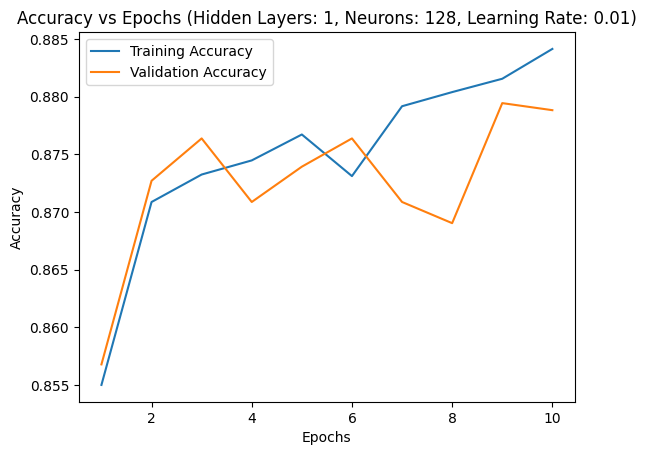

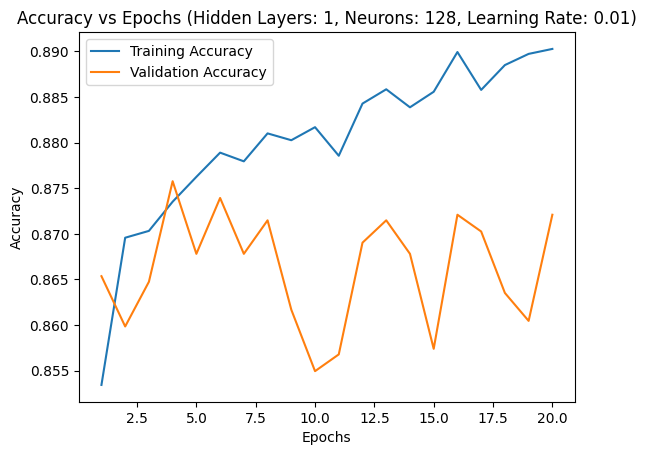

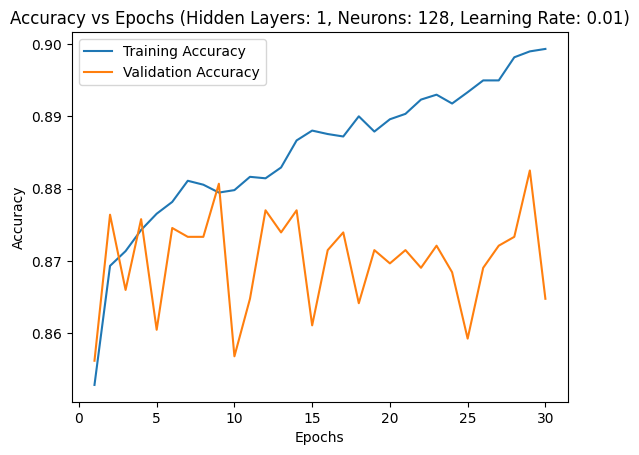

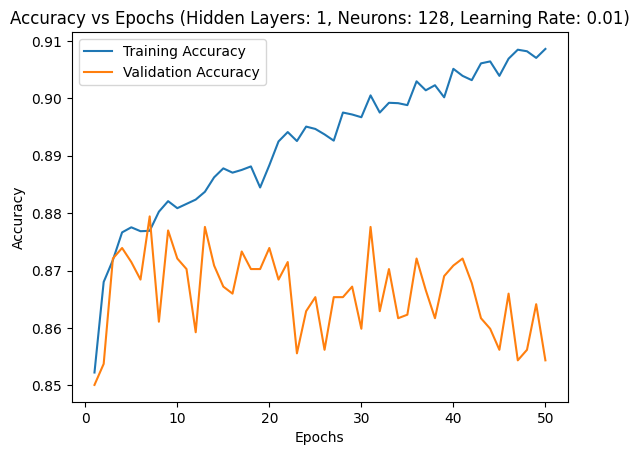

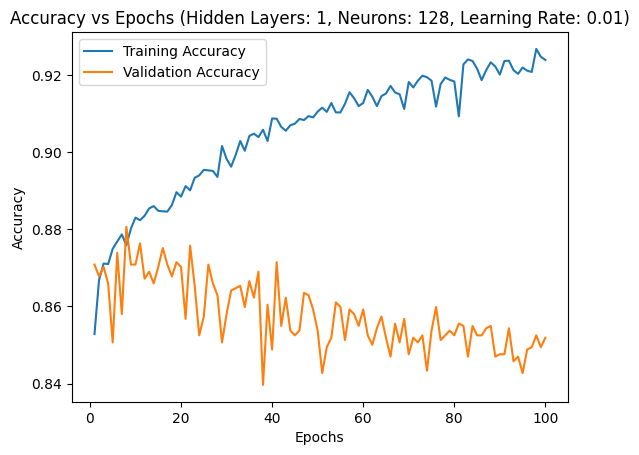

---------------------------------------------------------------


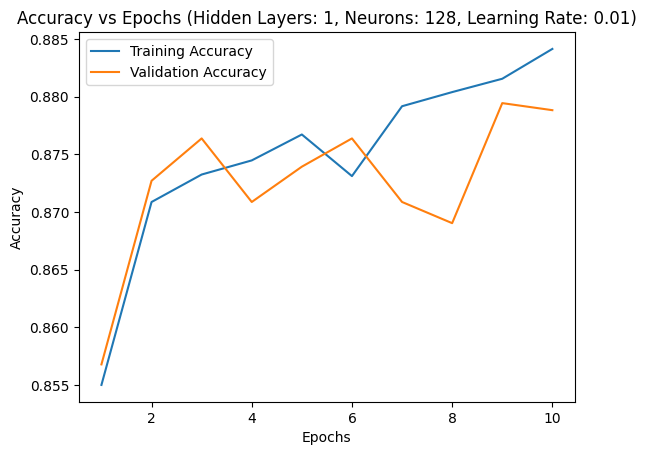

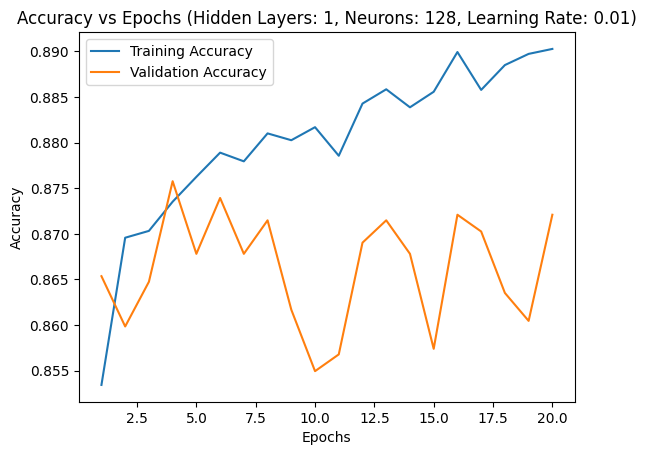

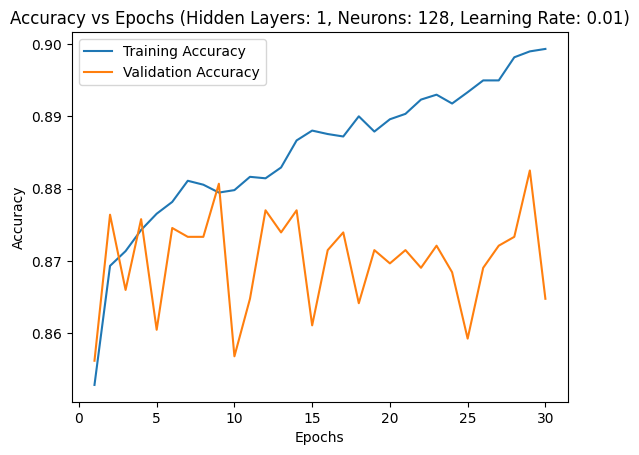

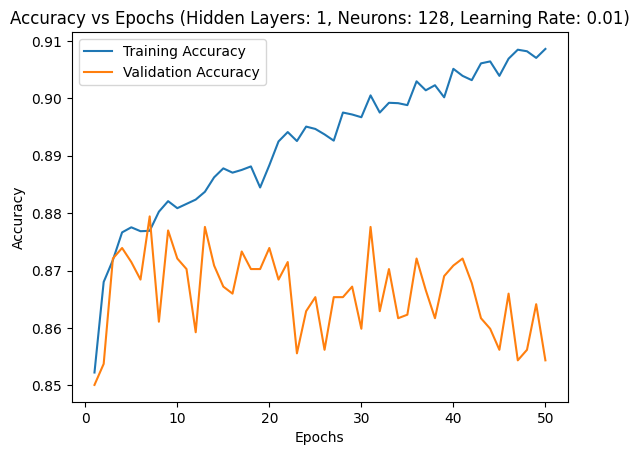

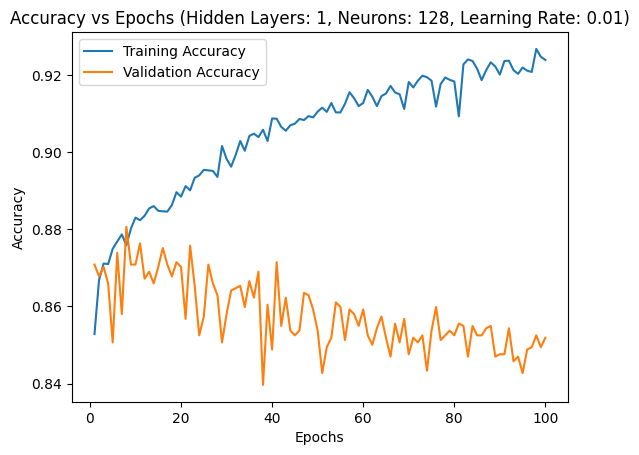

---------------------------------------------------------------


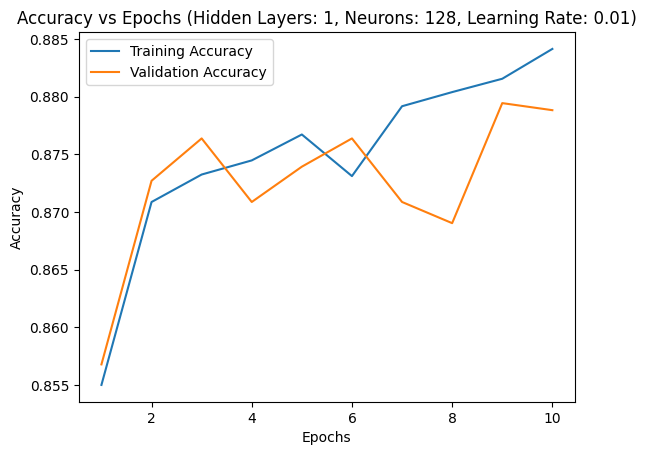

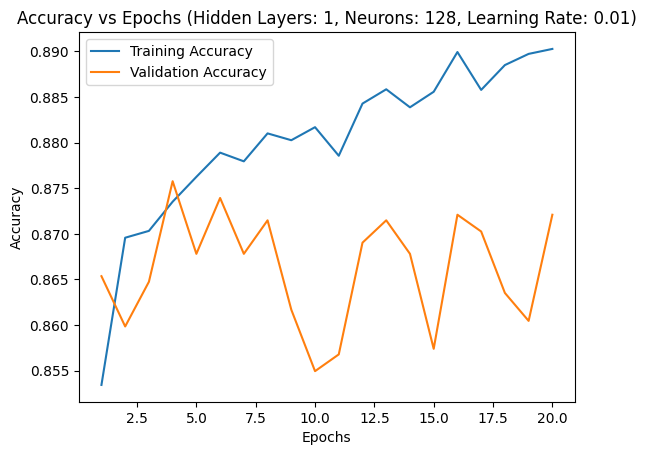

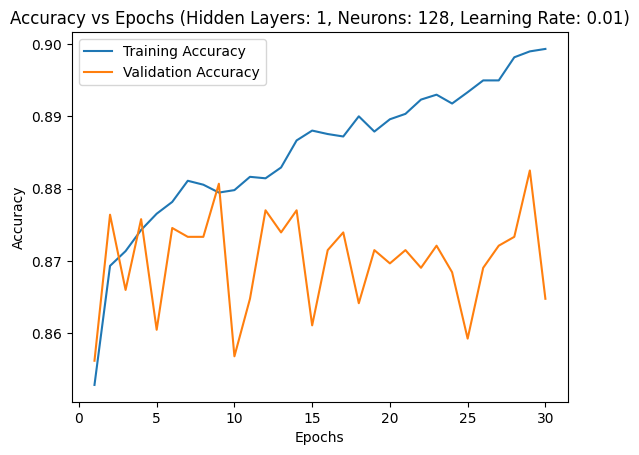

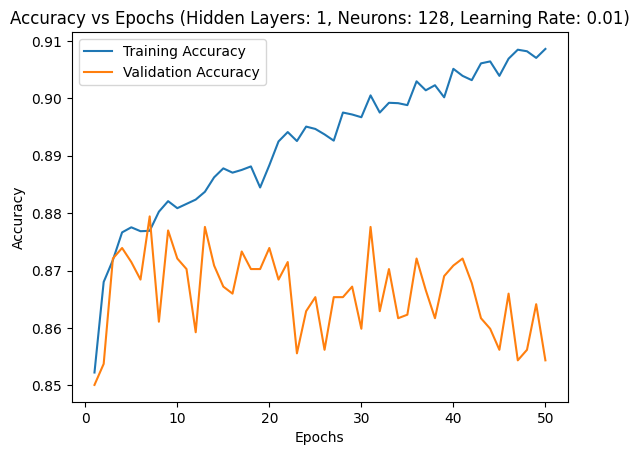

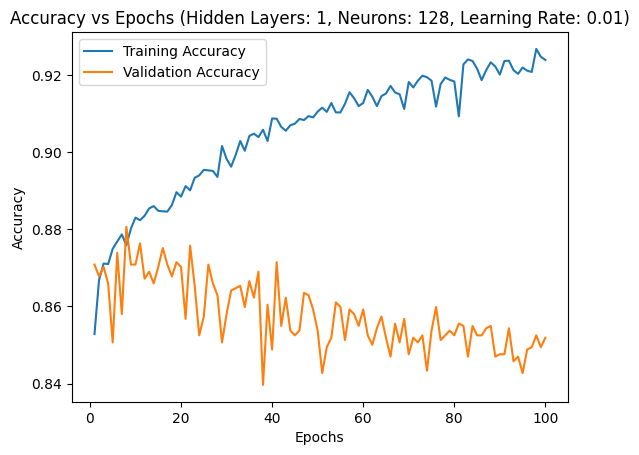

---------------------------------------------------------------


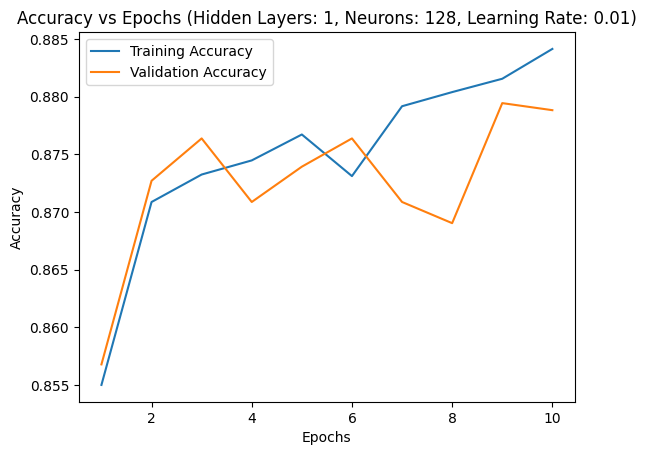

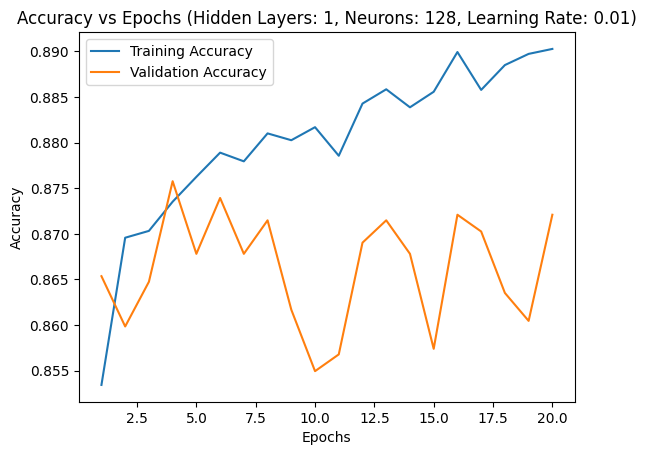

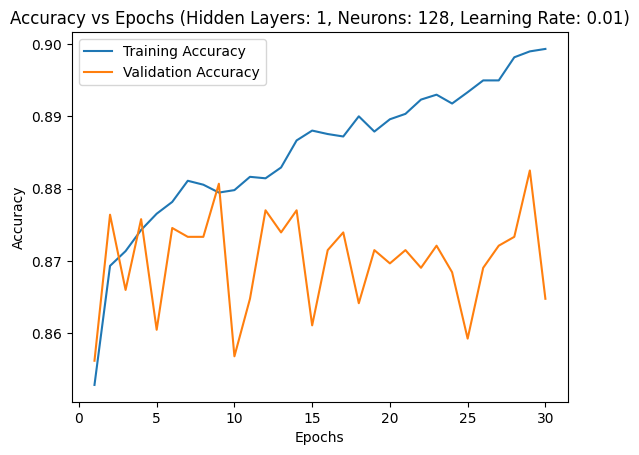

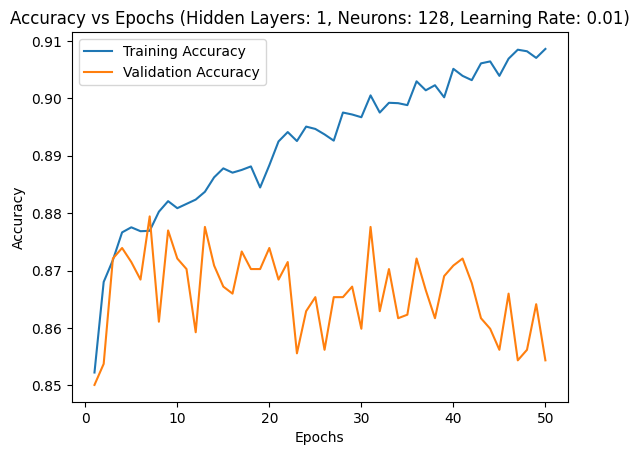

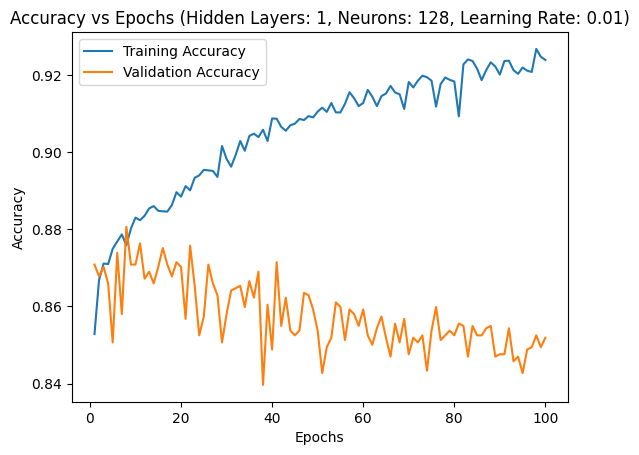

---------------------------------------------------------------


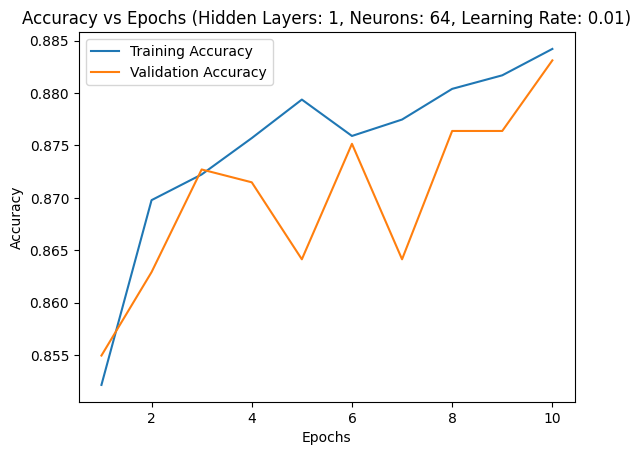

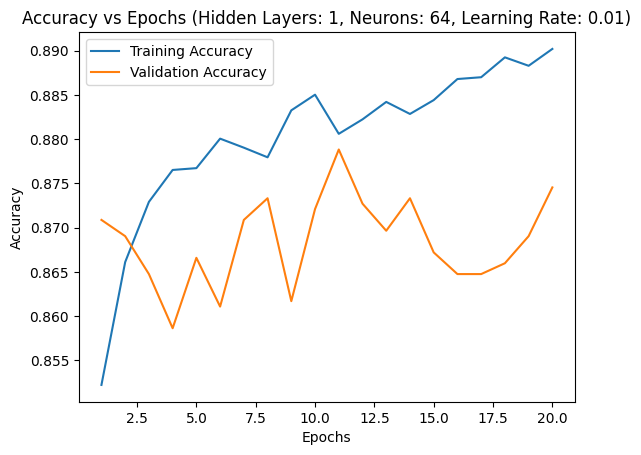

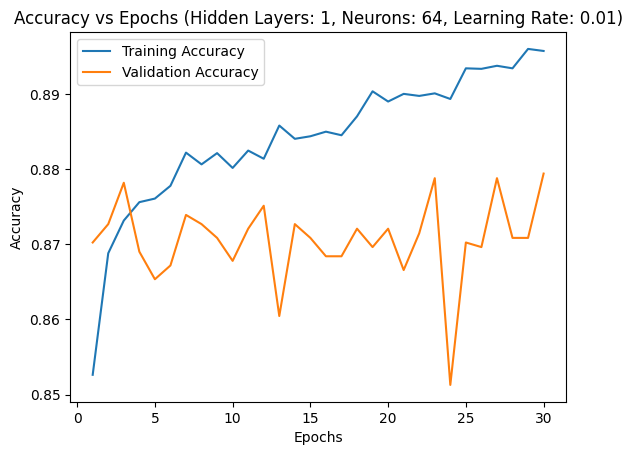

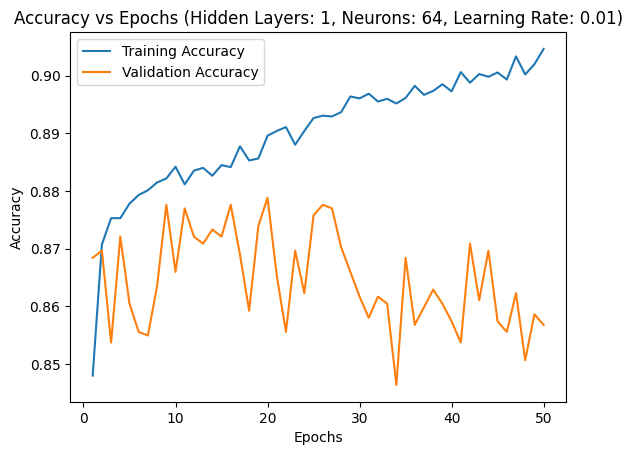

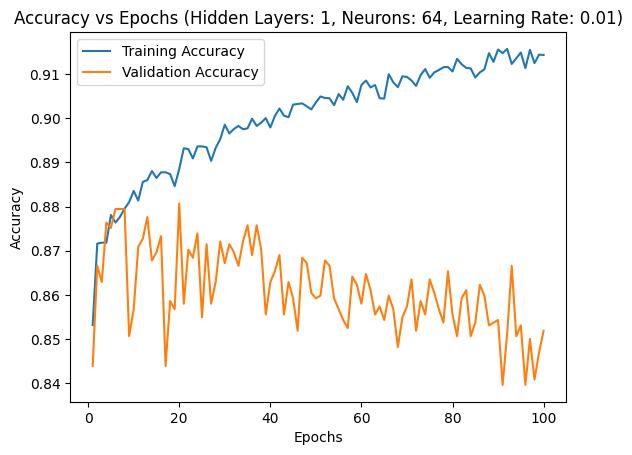

---------------------------------------------------------------


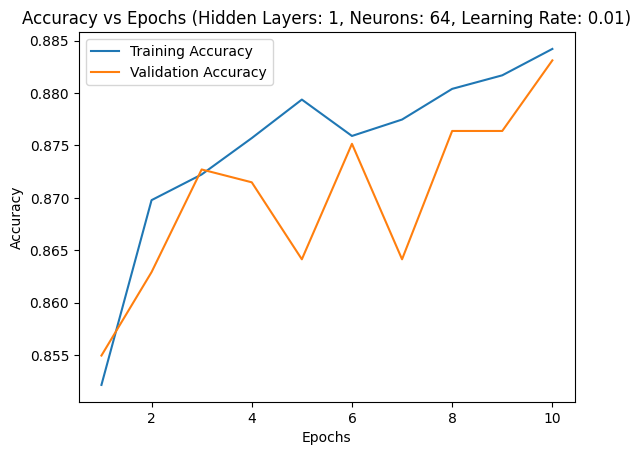

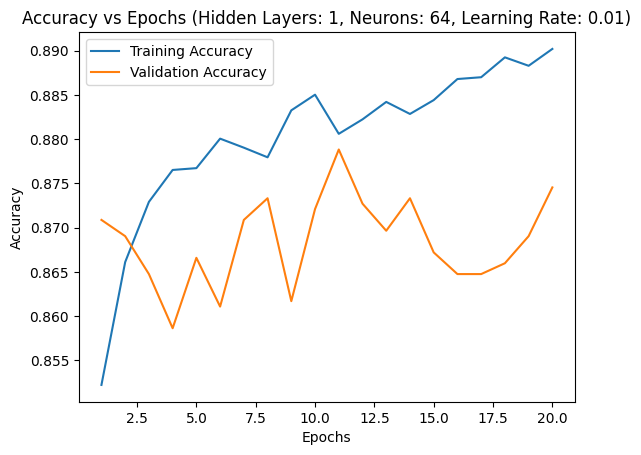

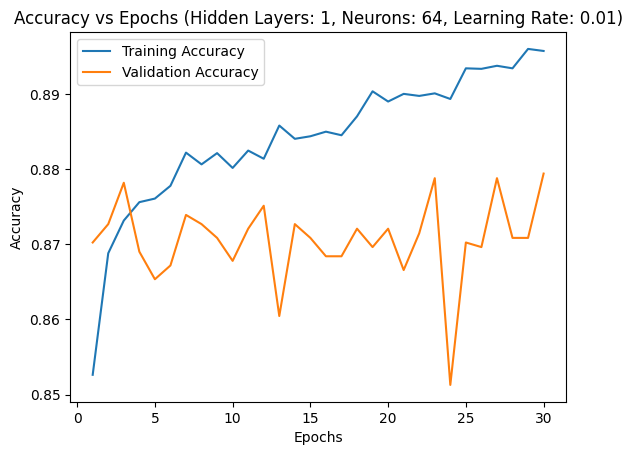

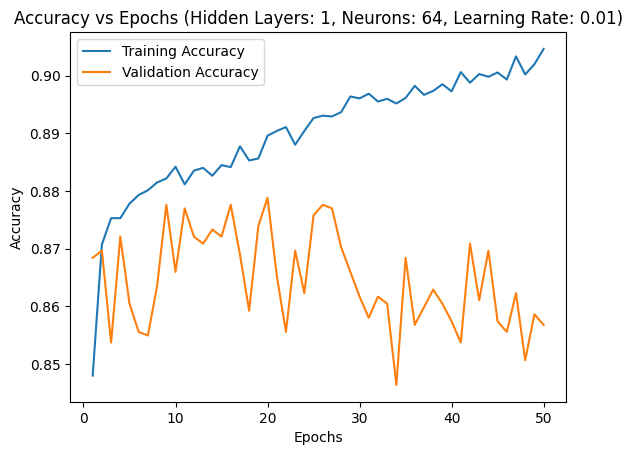

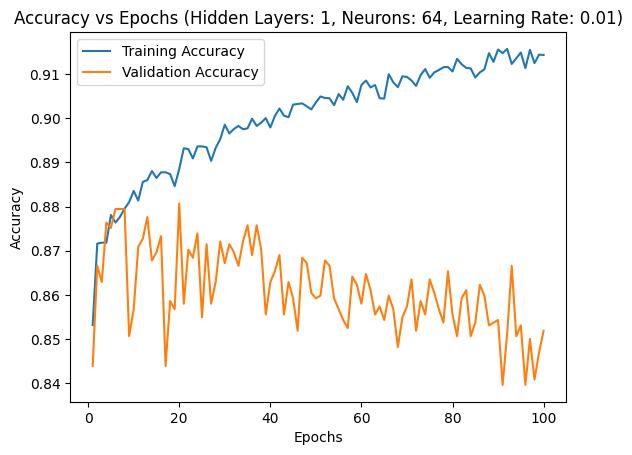

---------------------------------------------------------------


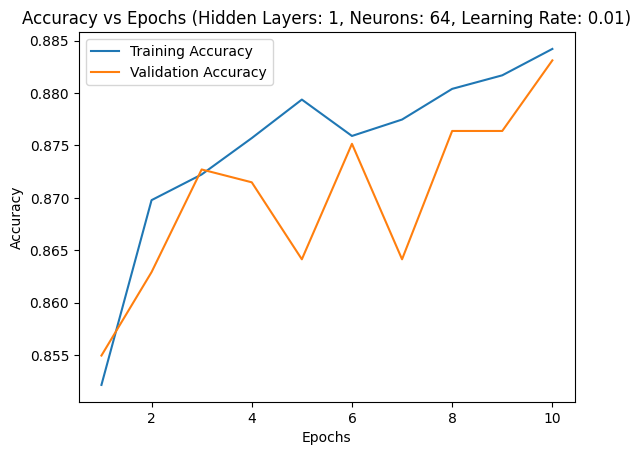

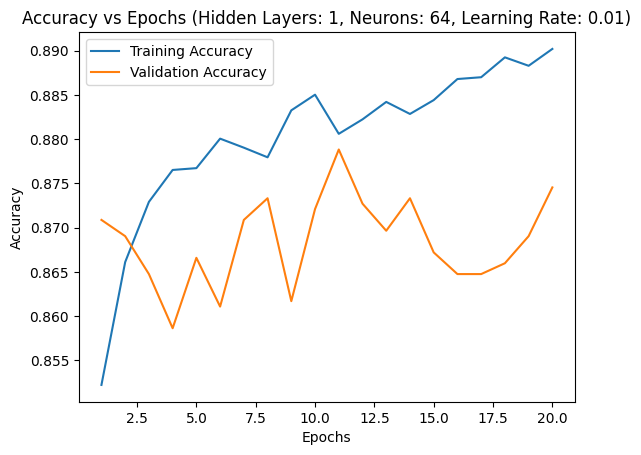

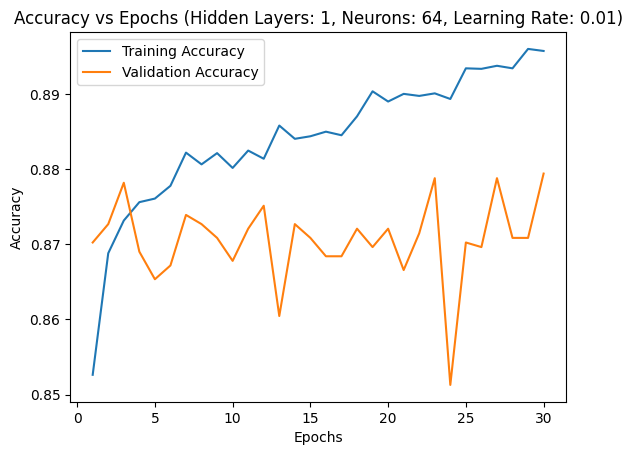

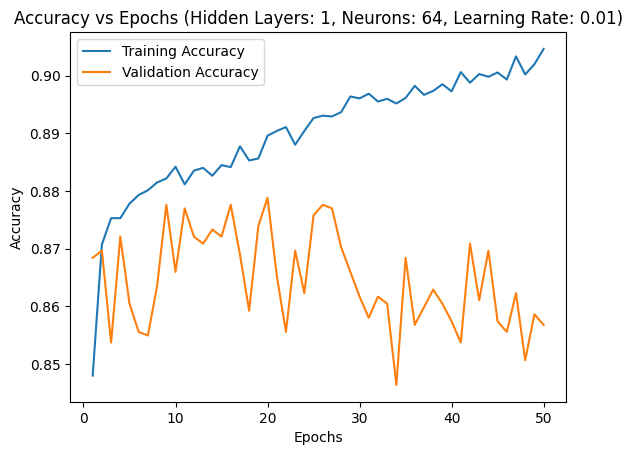

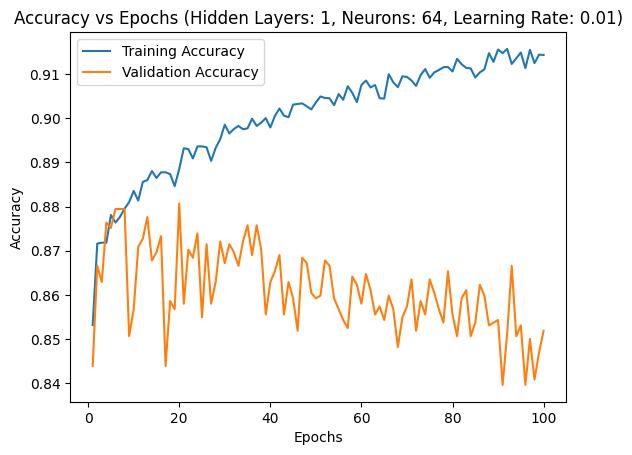

---------------------------------------------------------------


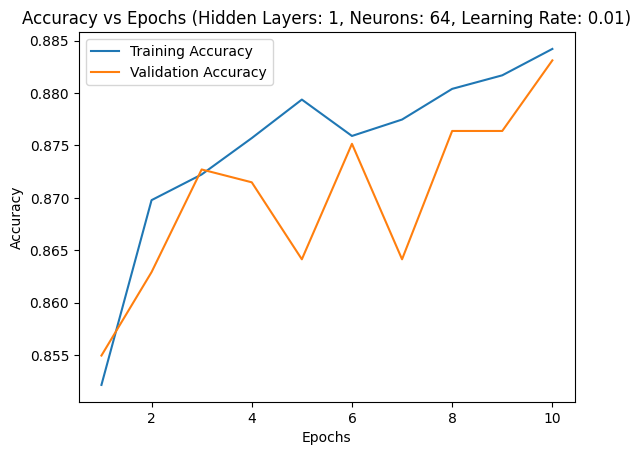

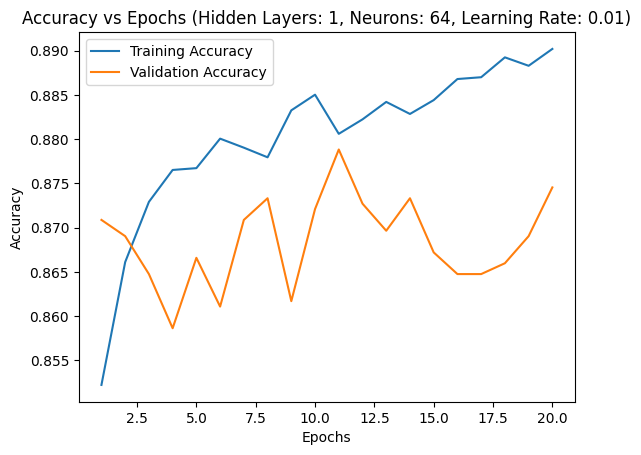

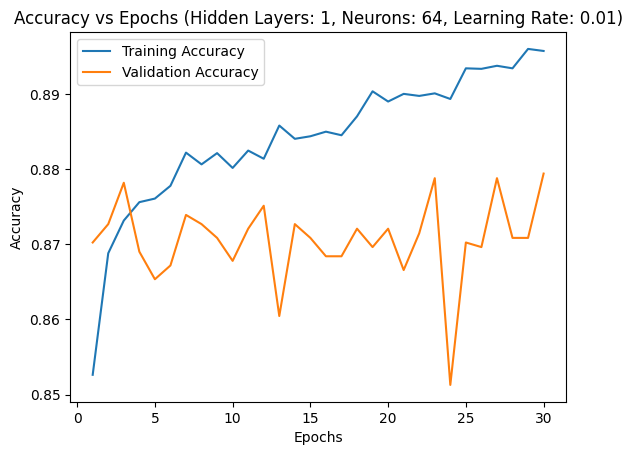

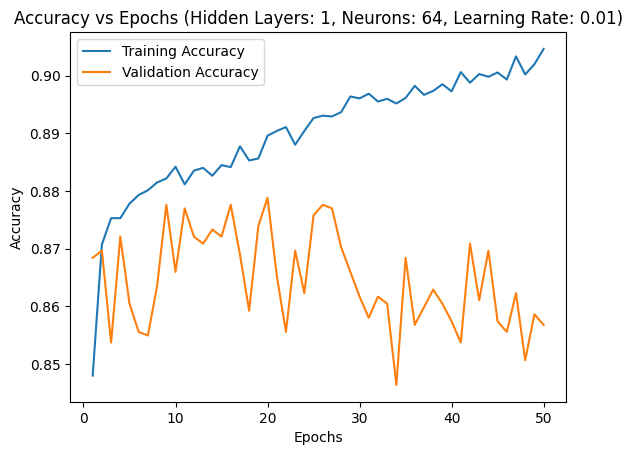

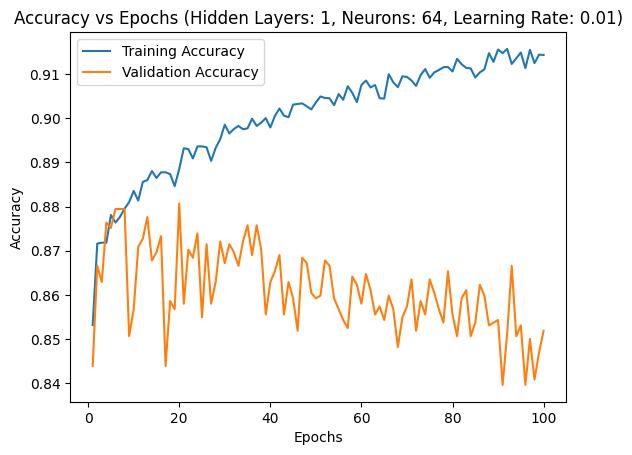

---------------------------------------------------------------


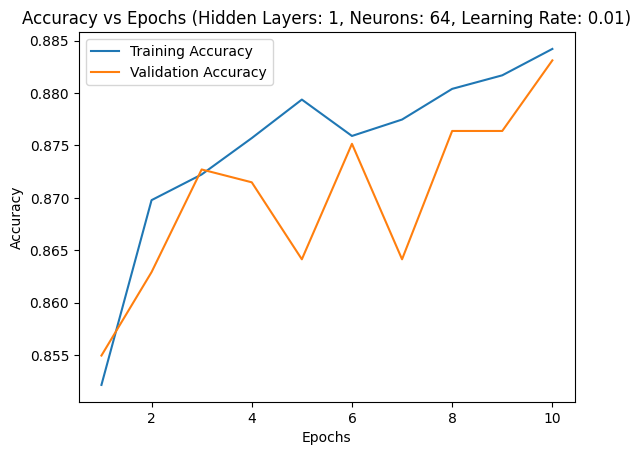

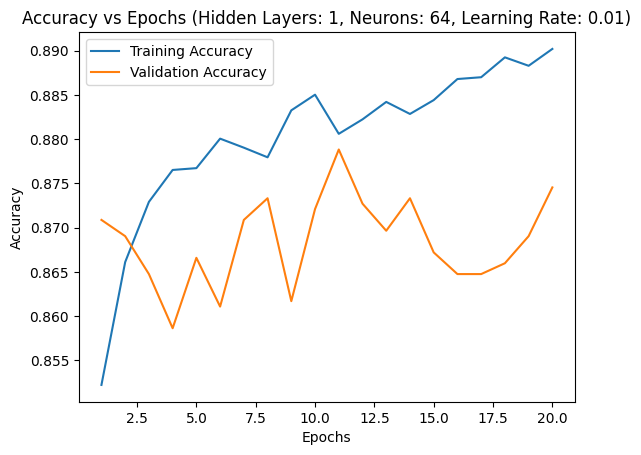

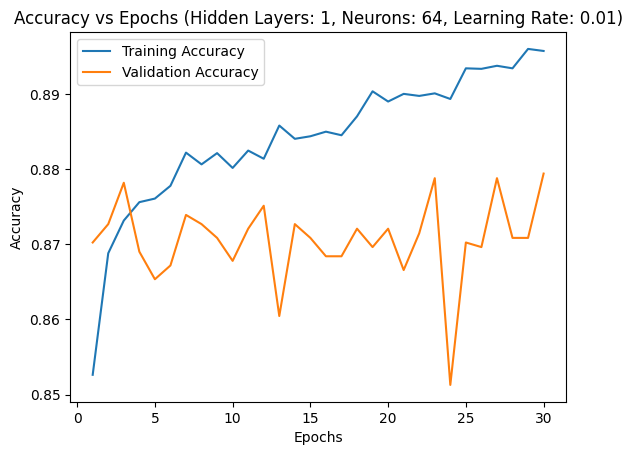

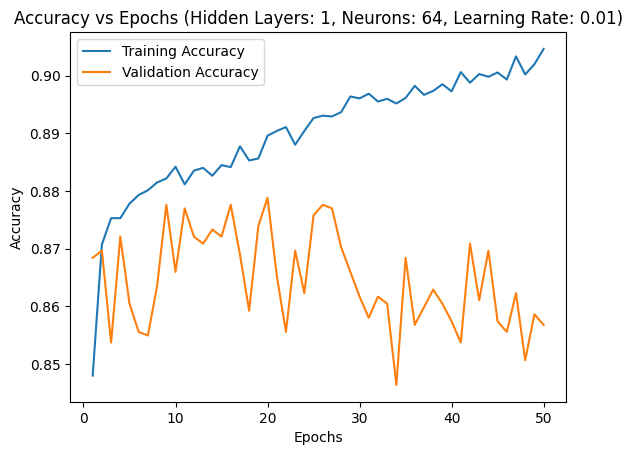

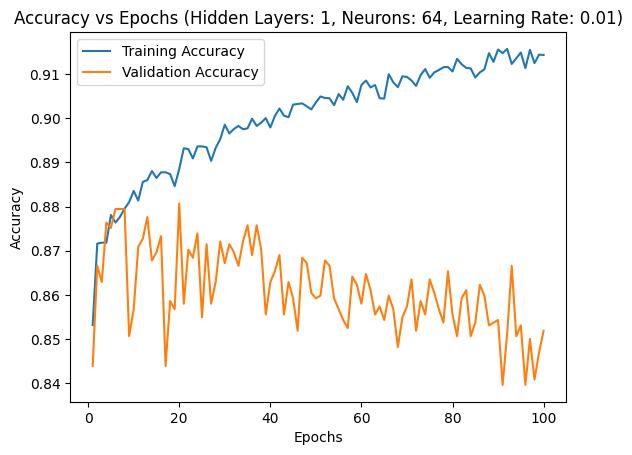

---------------------------------------------------------------


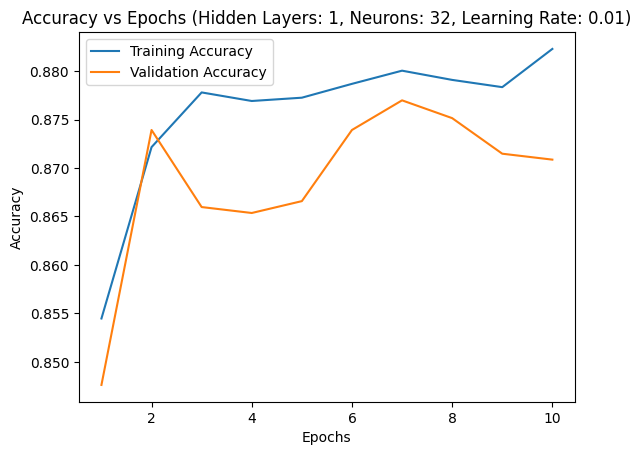

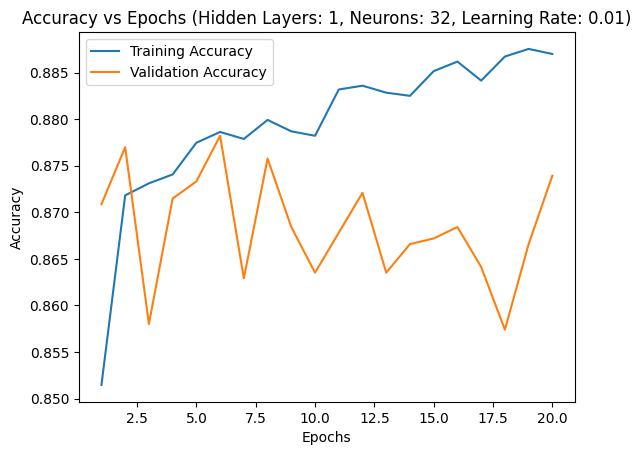

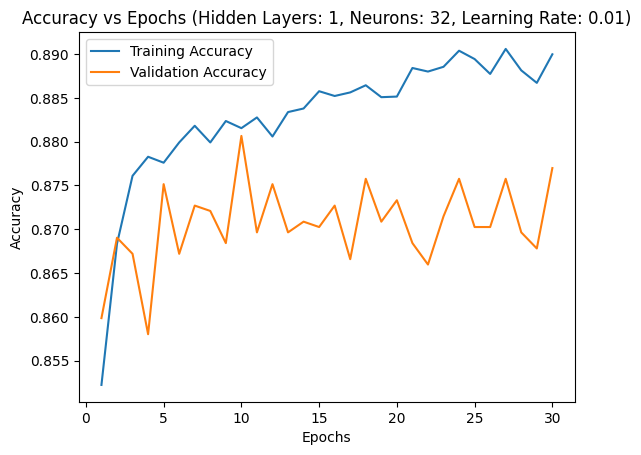

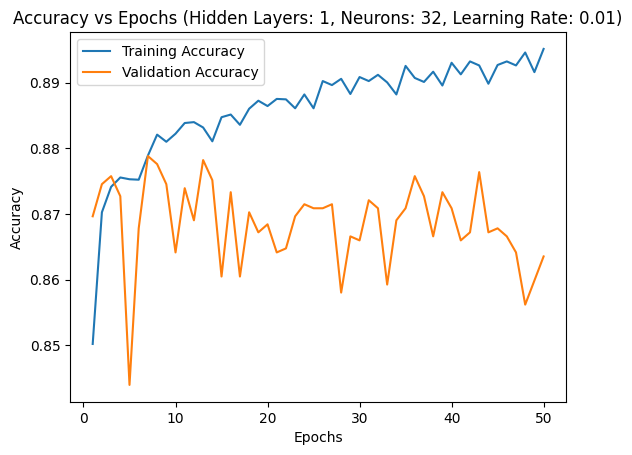

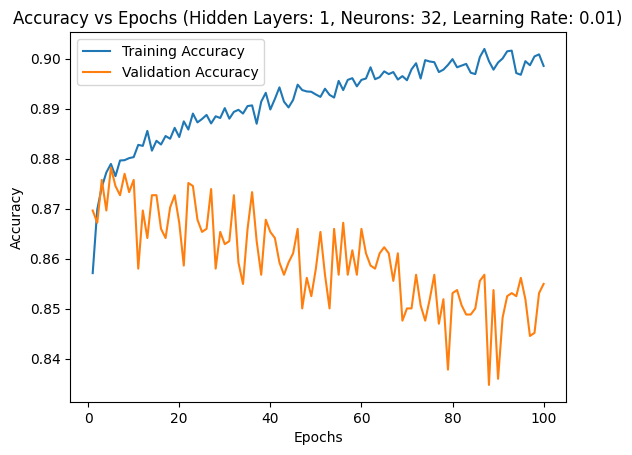

---------------------------------------------------------------


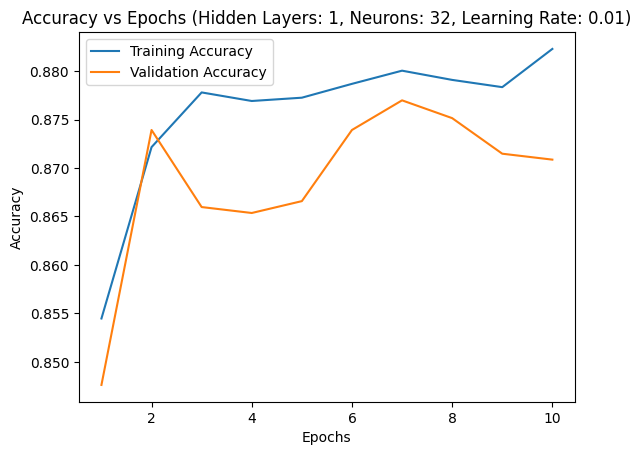

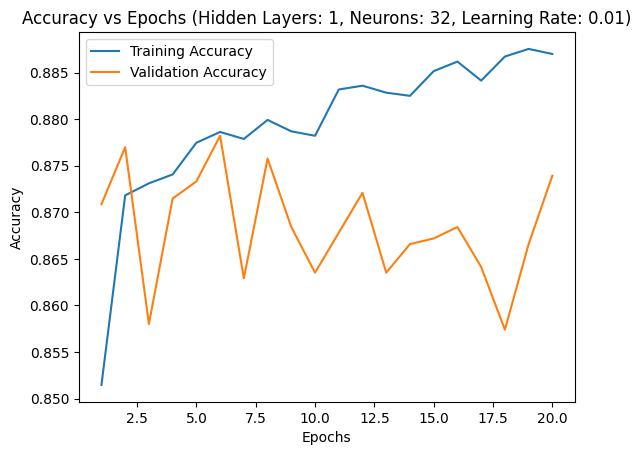

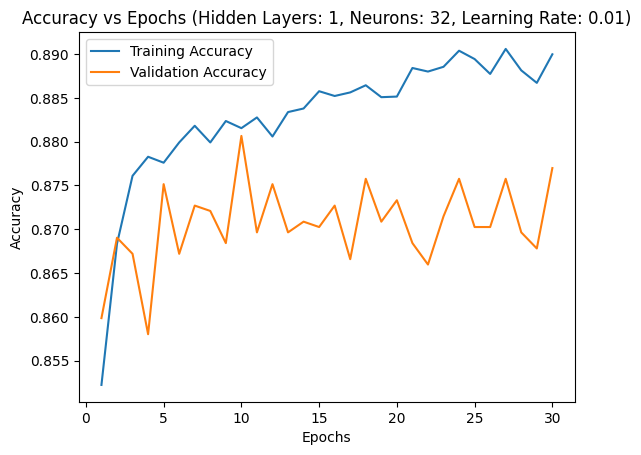

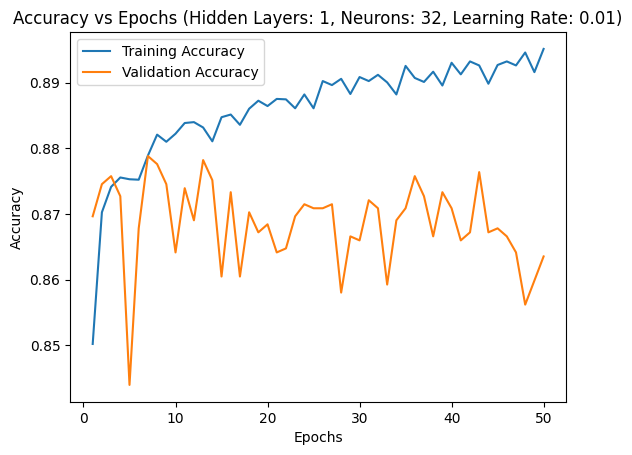

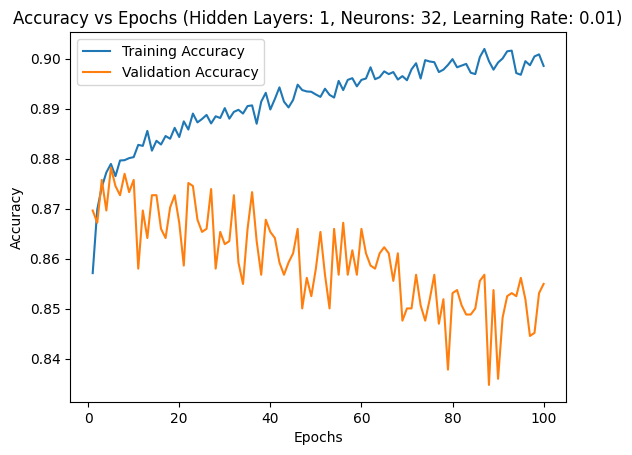

---------------------------------------------------------------


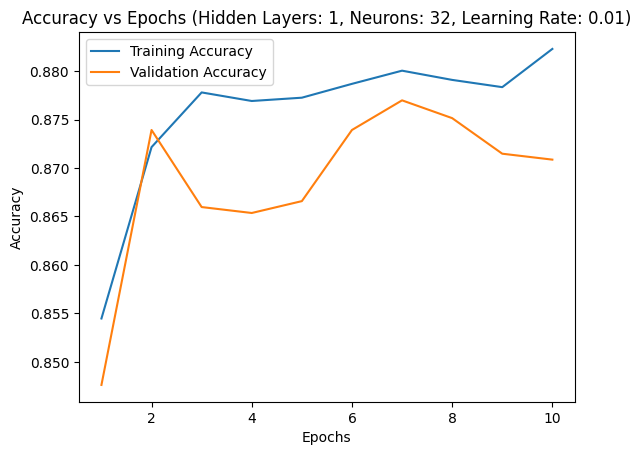

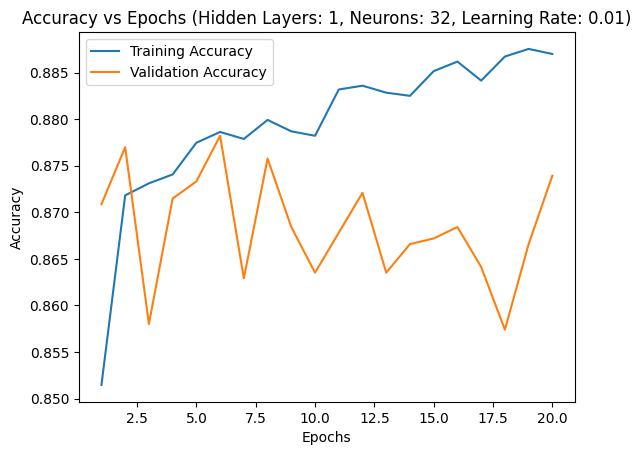

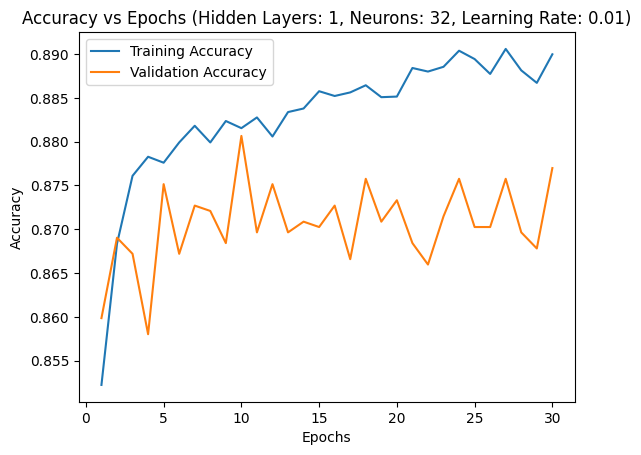

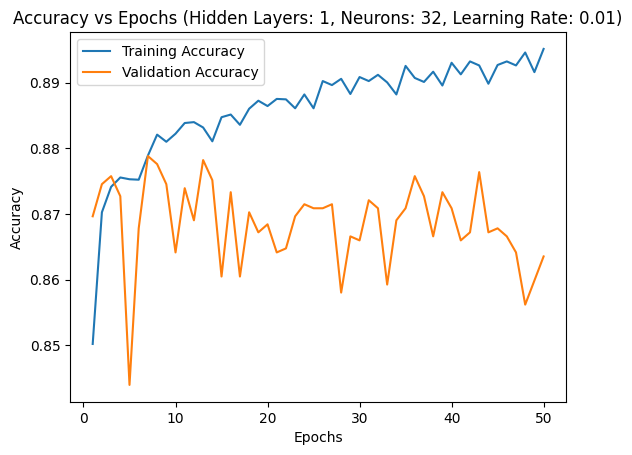

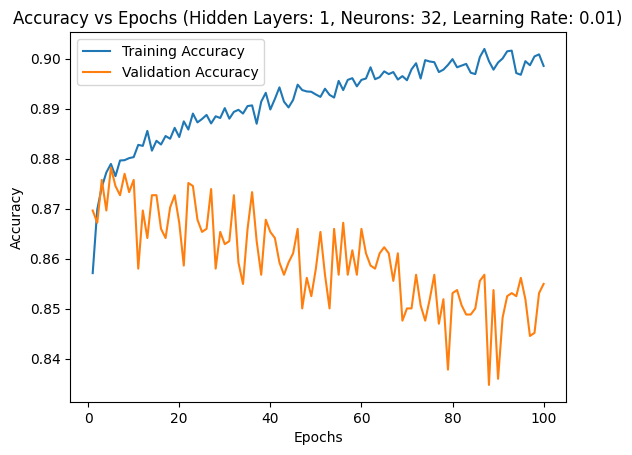

---------------------------------------------------------------


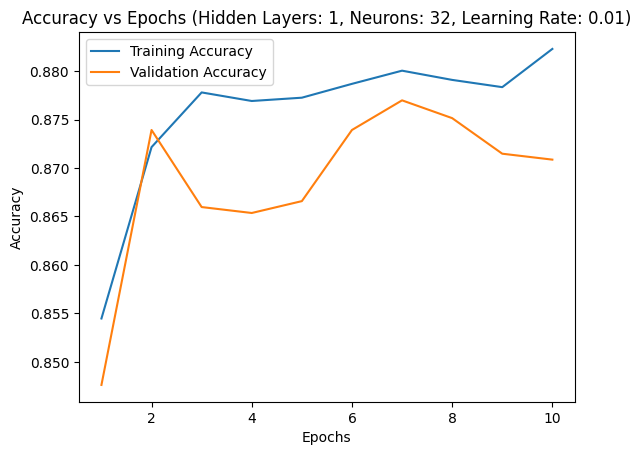

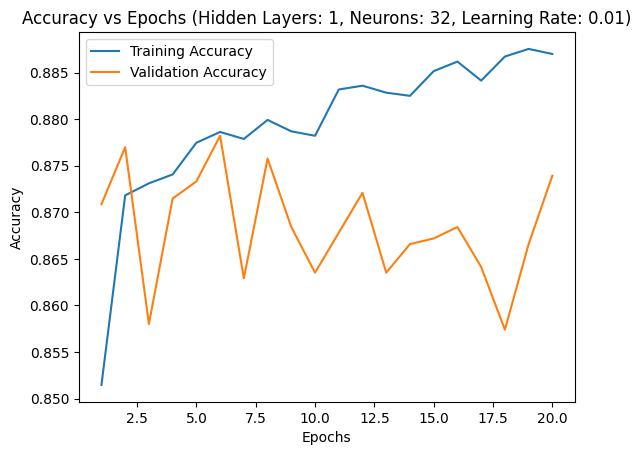

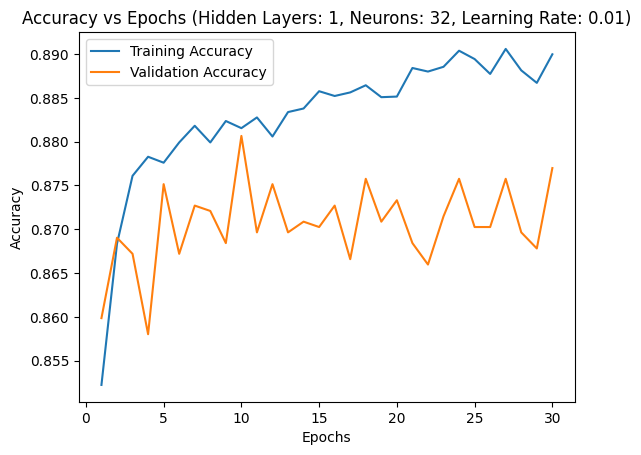

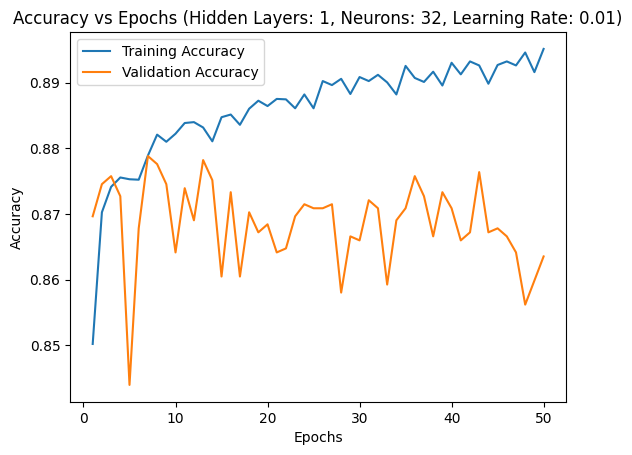

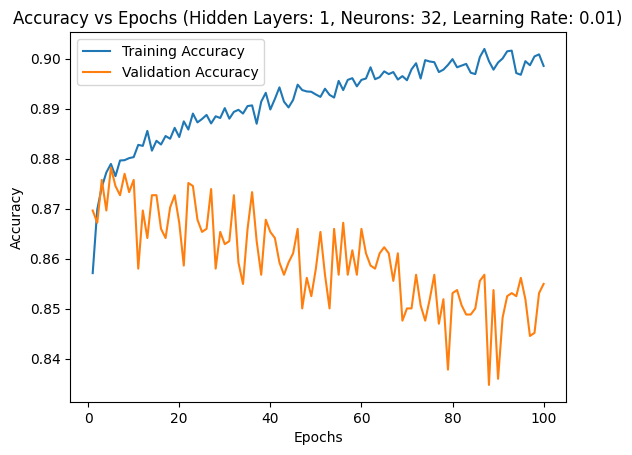

---------------------------------------------------------------


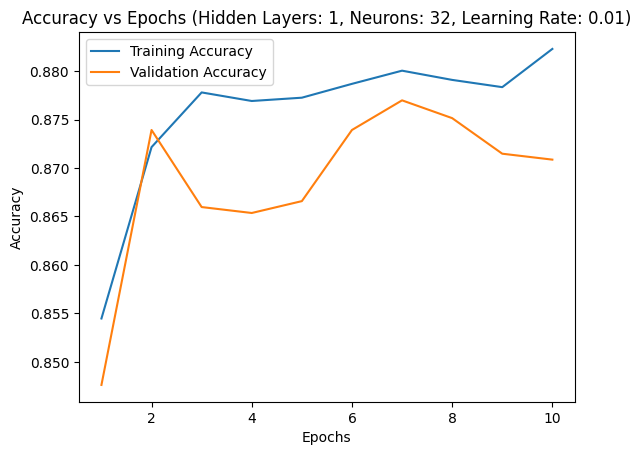

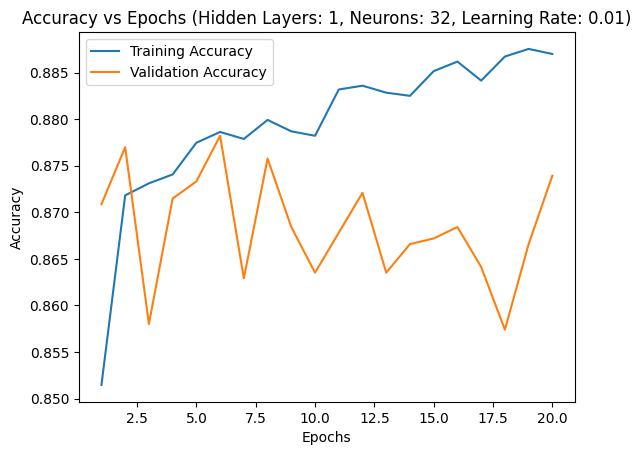

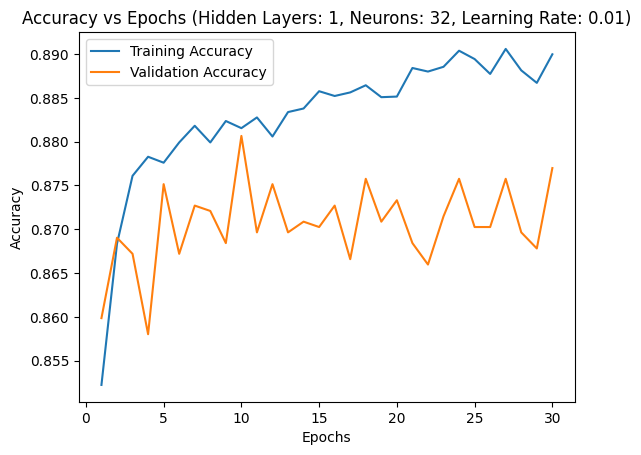

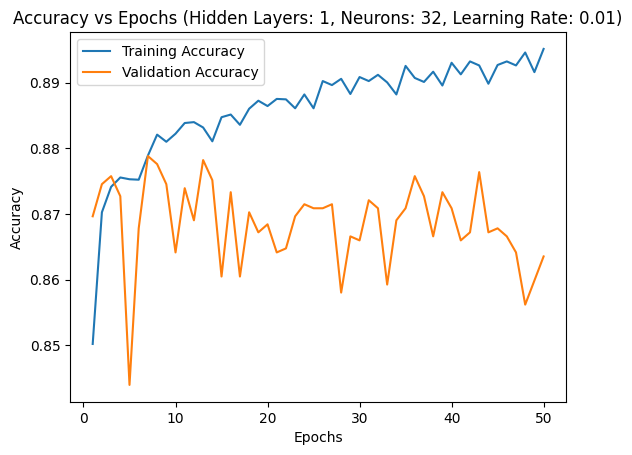

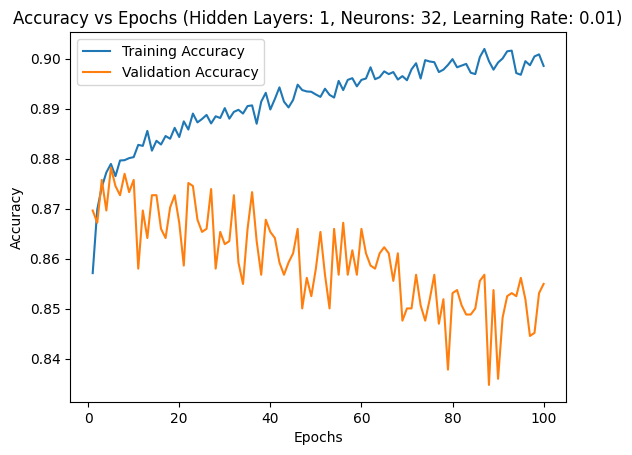

---------------------------------------------------------------


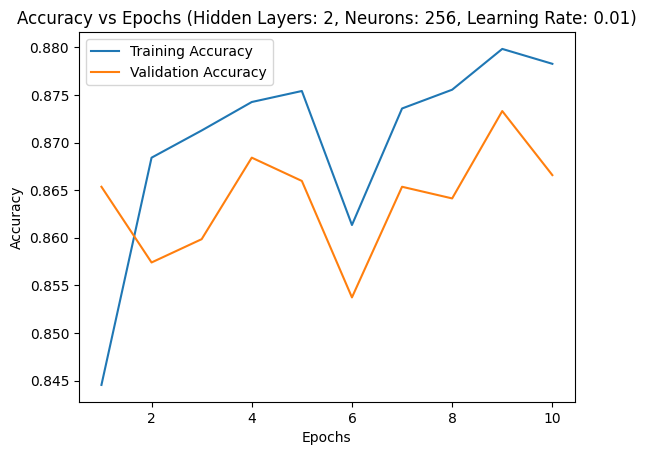

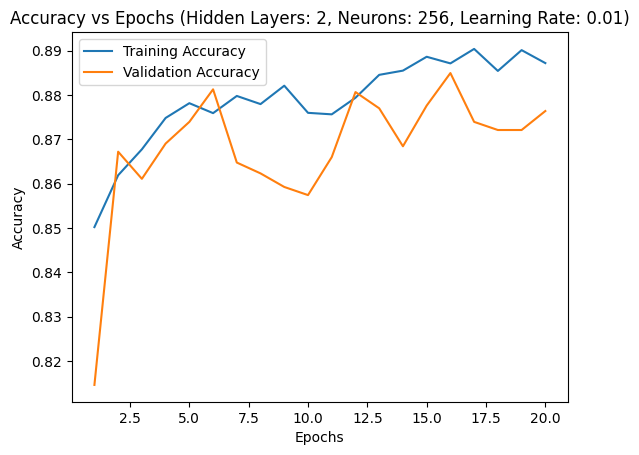

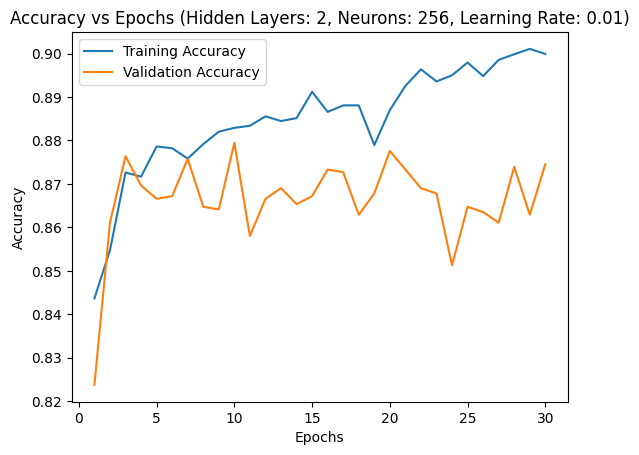

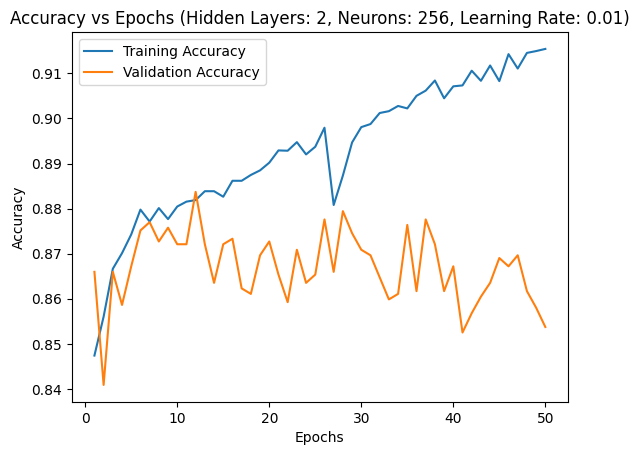

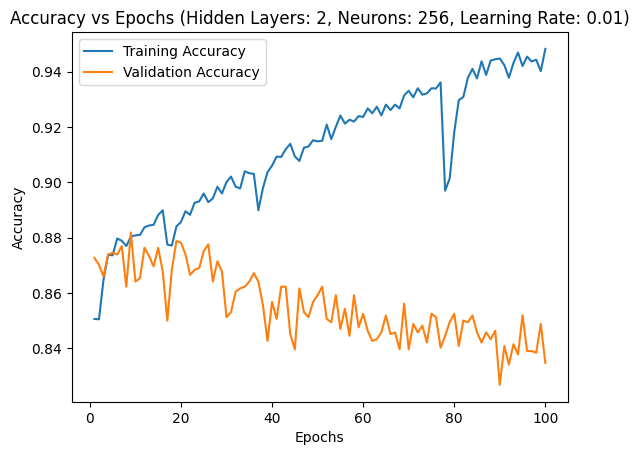

---------------------------------------------------------------


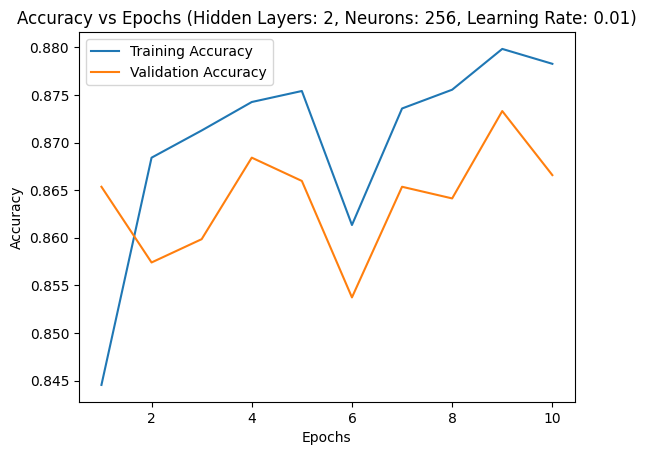

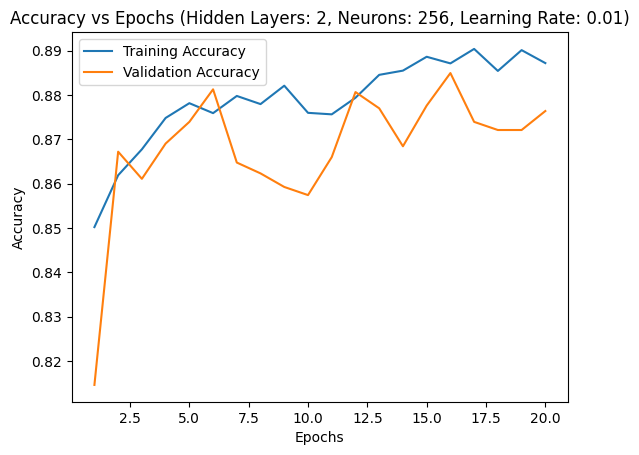

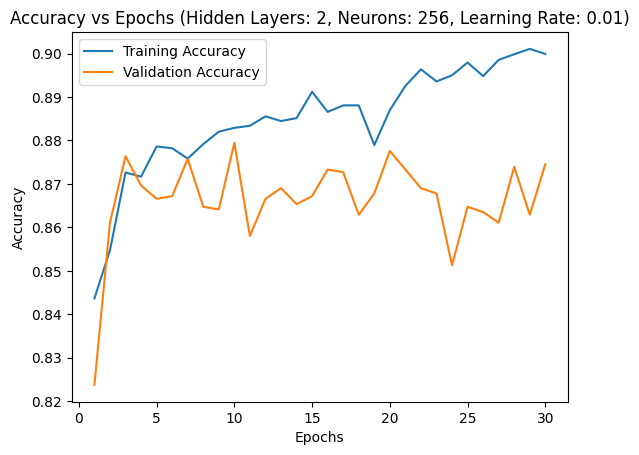

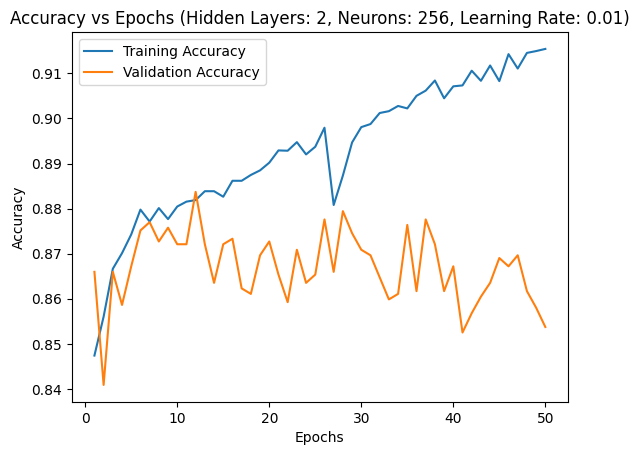

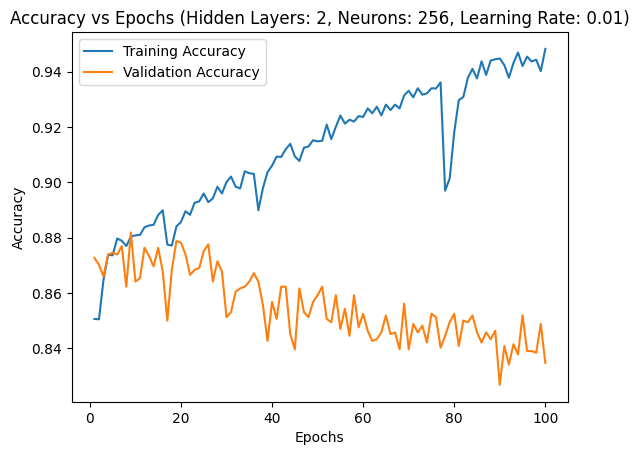

---------------------------------------------------------------


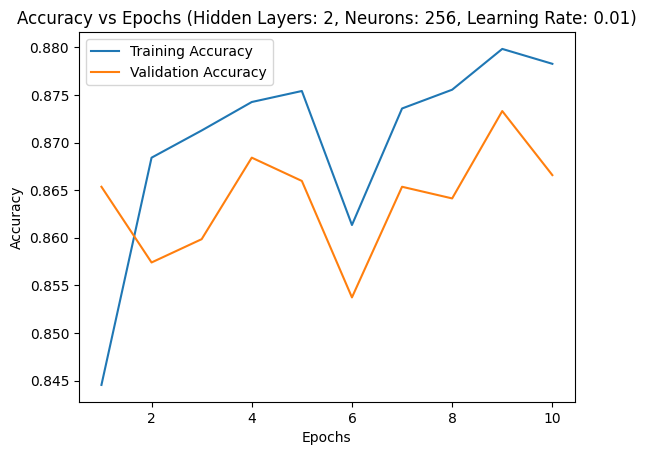

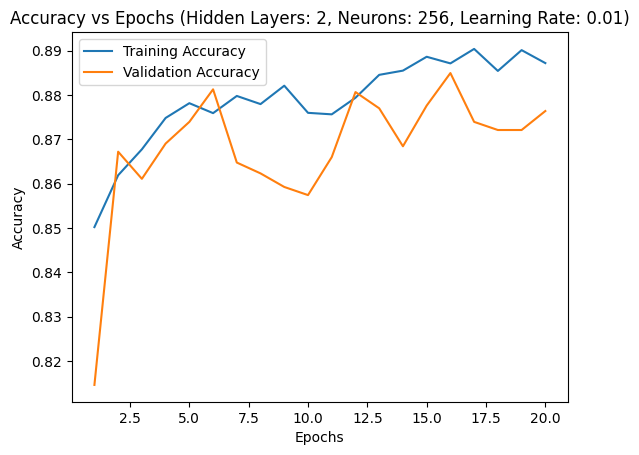

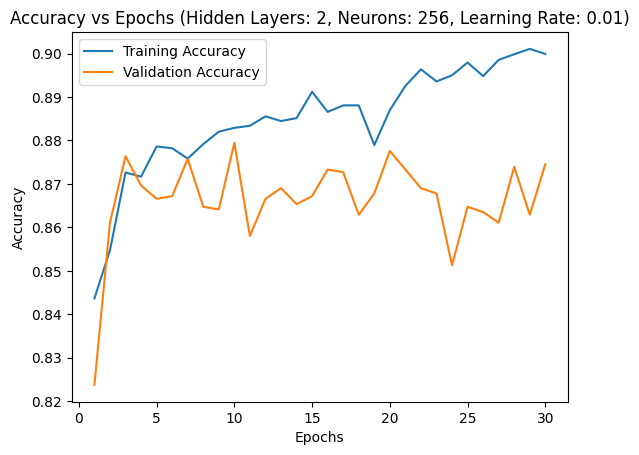

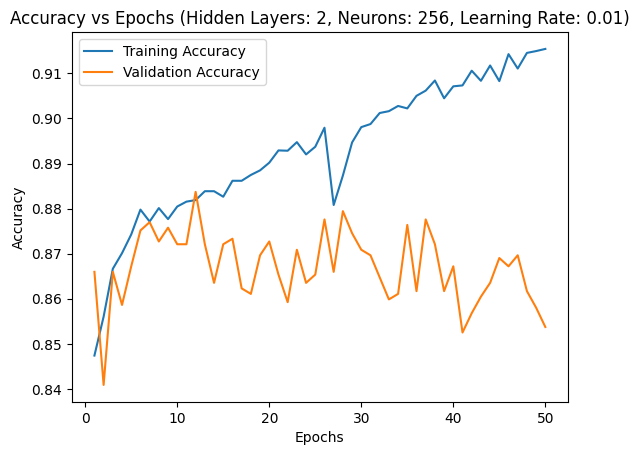

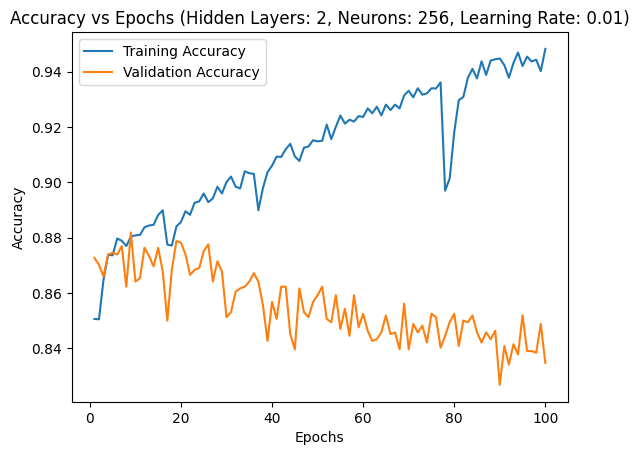

---------------------------------------------------------------


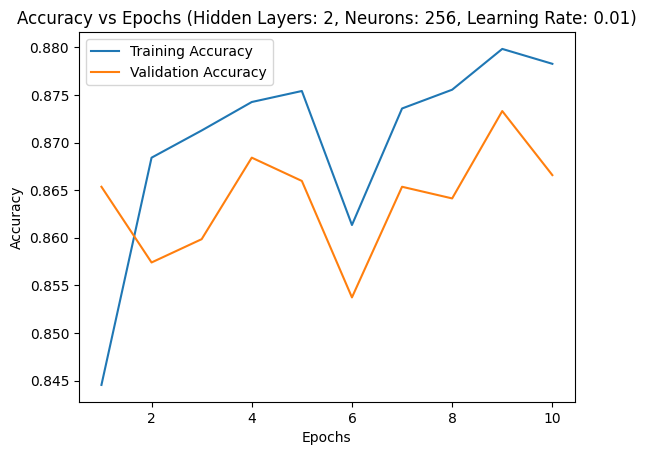

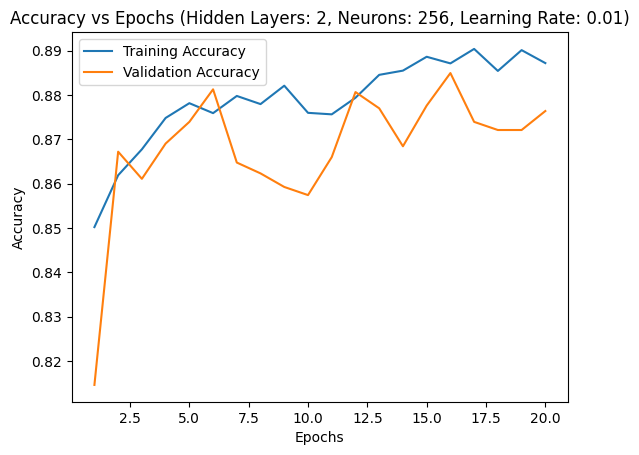

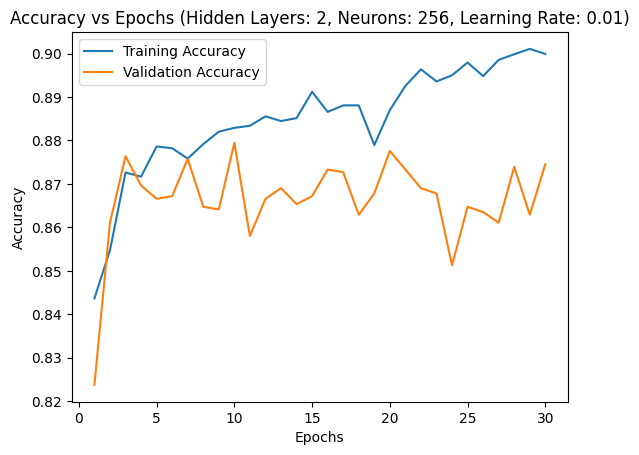

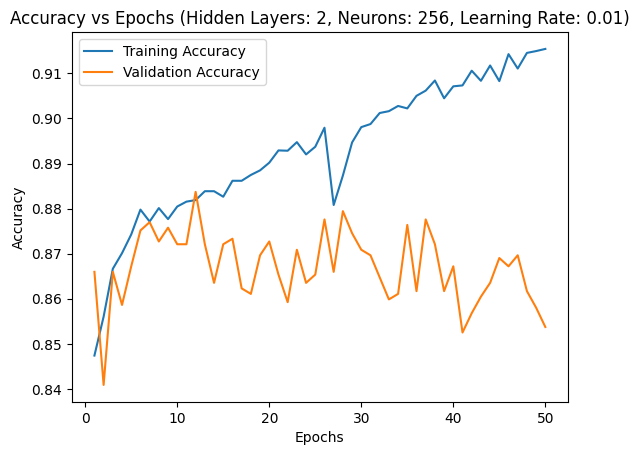

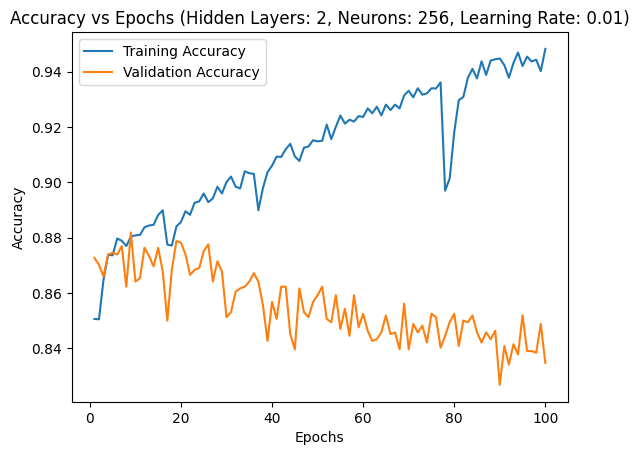

---------------------------------------------------------------


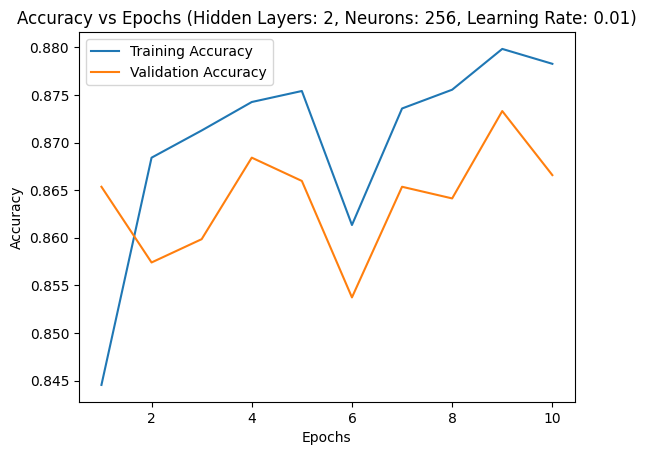

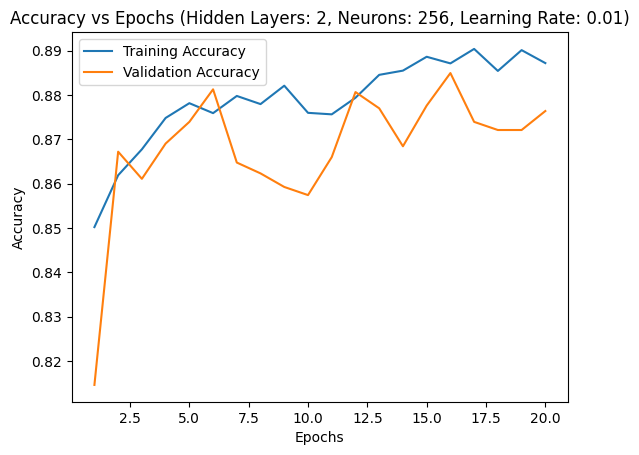

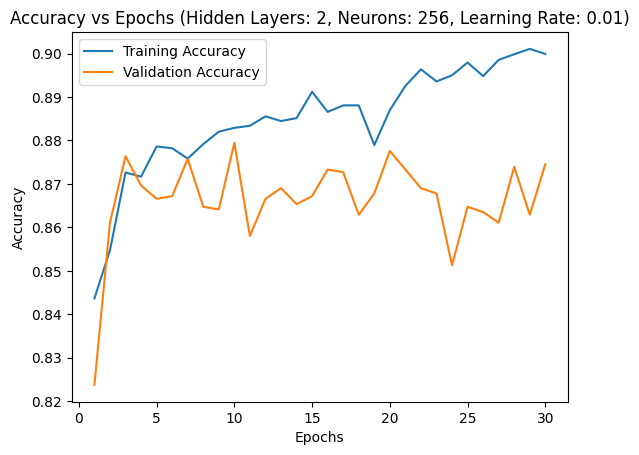

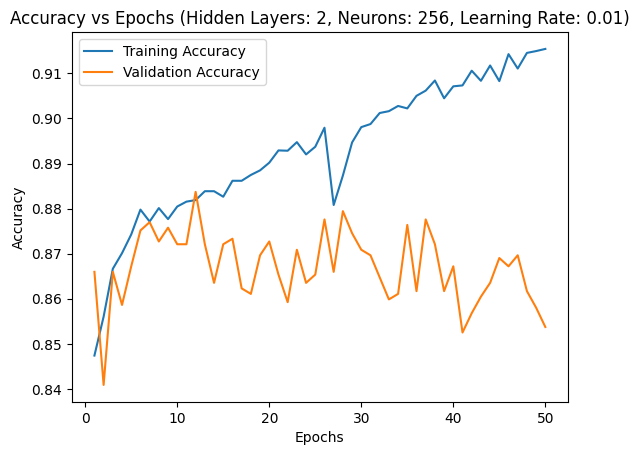

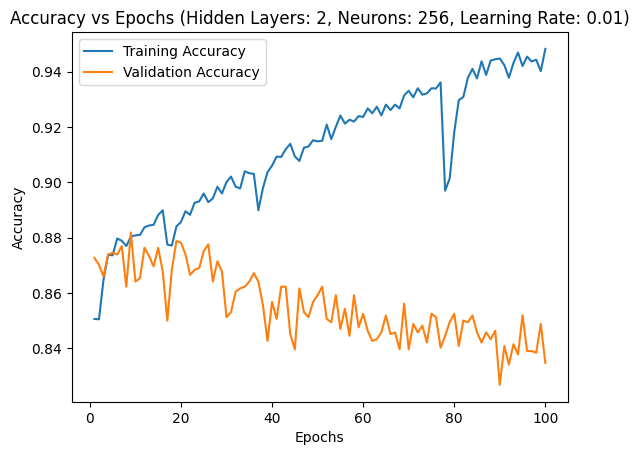

---------------------------------------------------------------


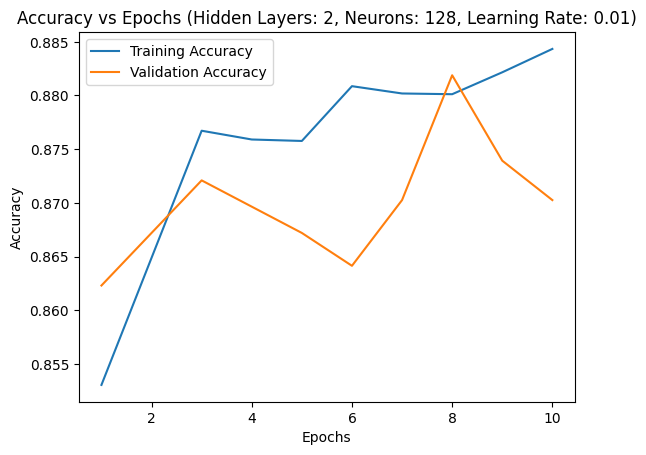

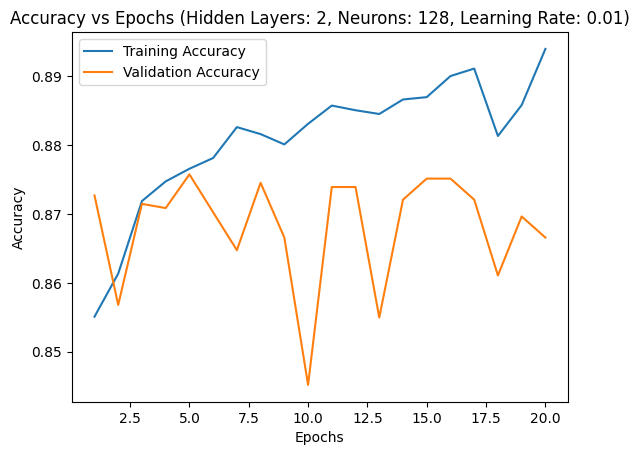

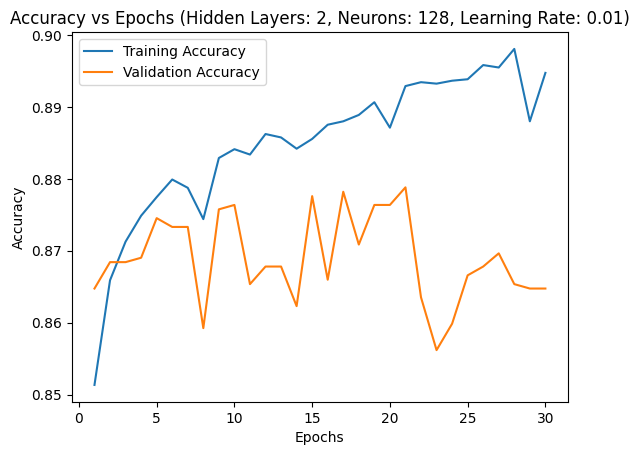

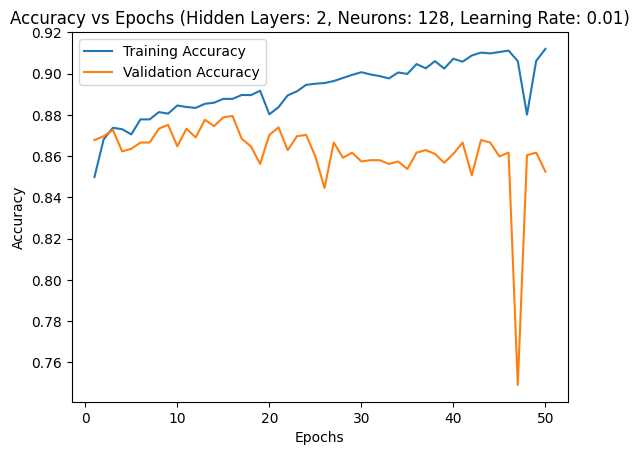

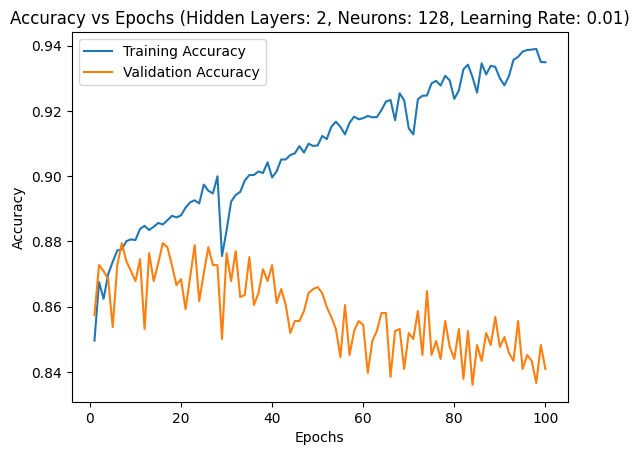

---------------------------------------------------------------


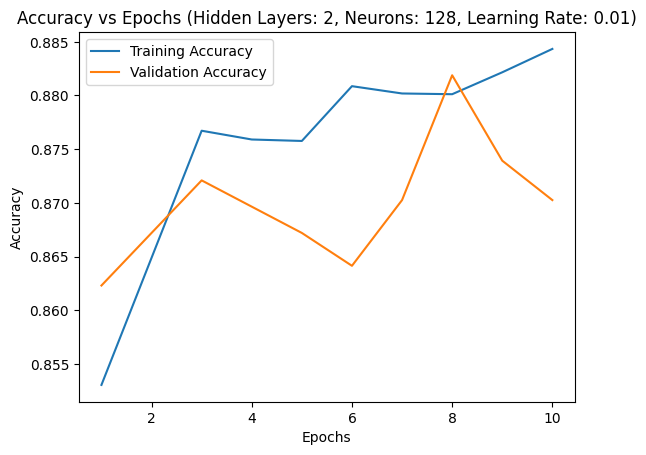

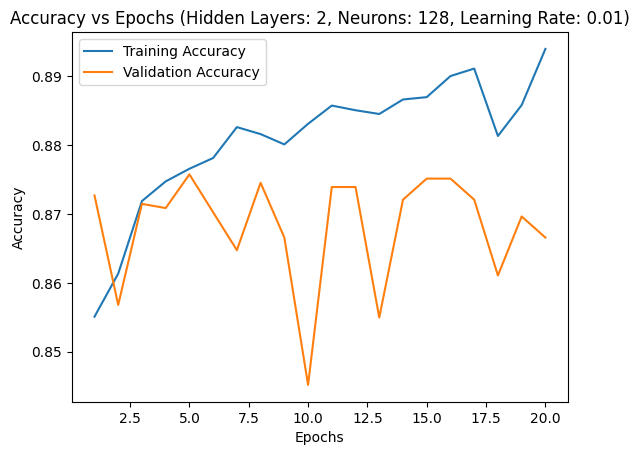

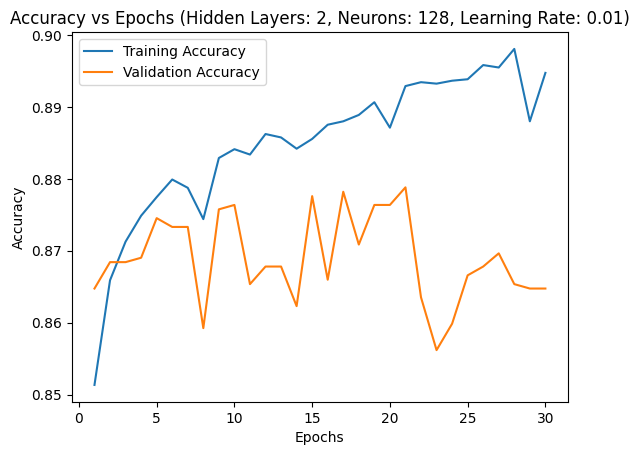

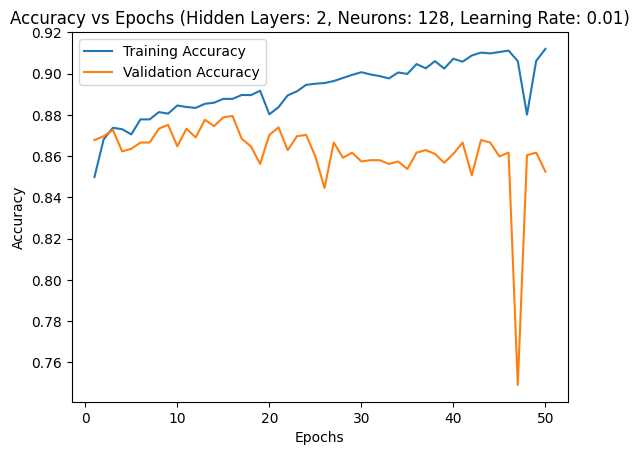

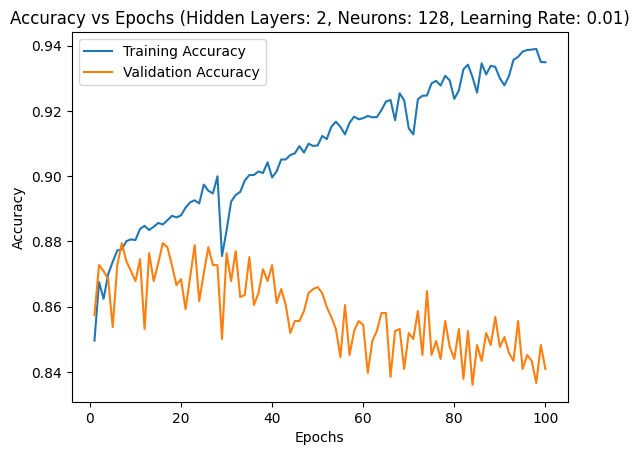

---------------------------------------------------------------


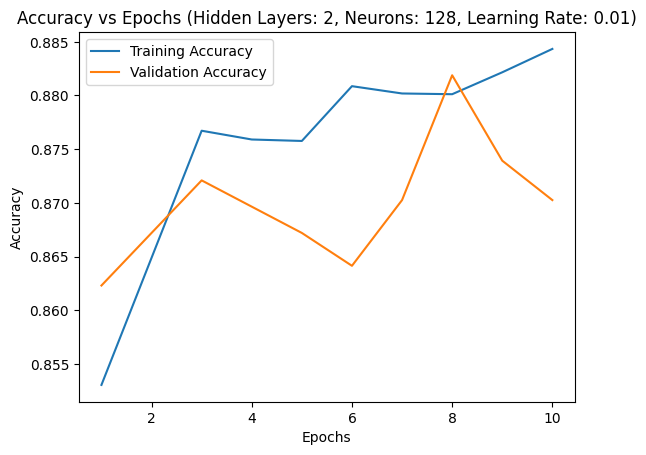

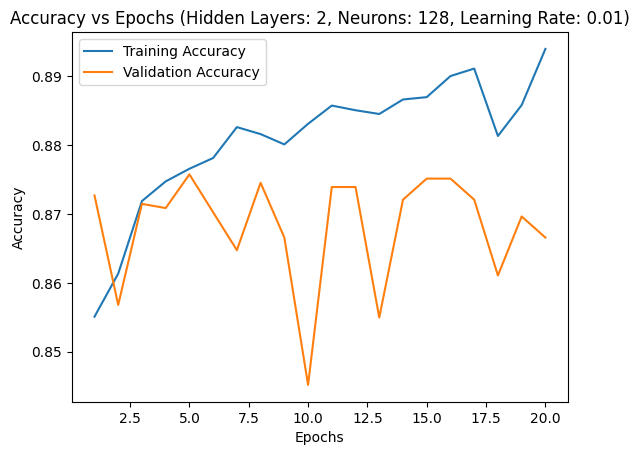

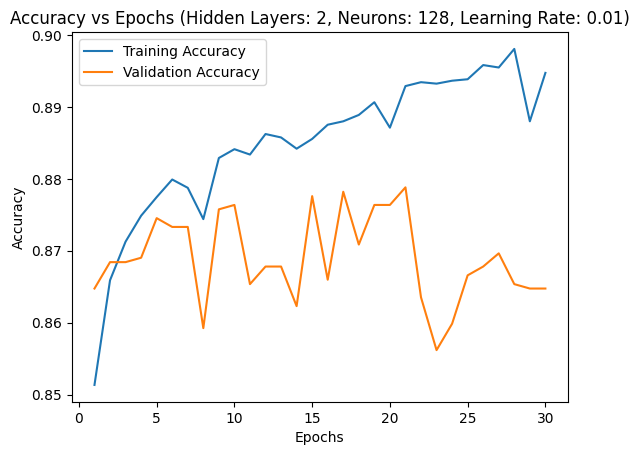

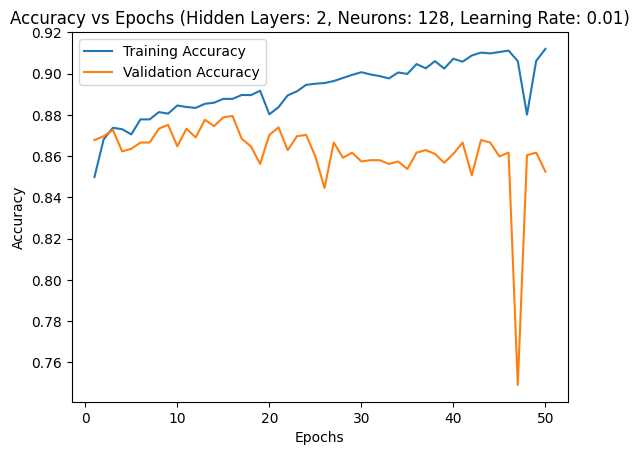

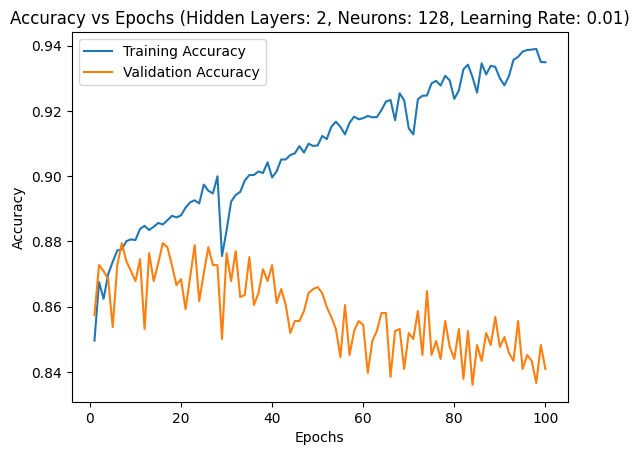

---------------------------------------------------------------


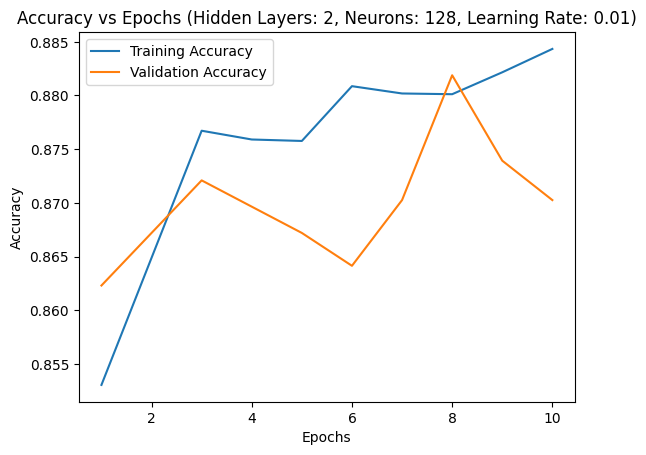

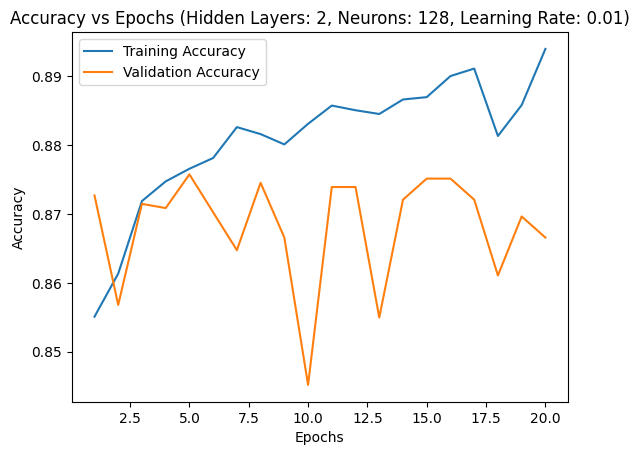

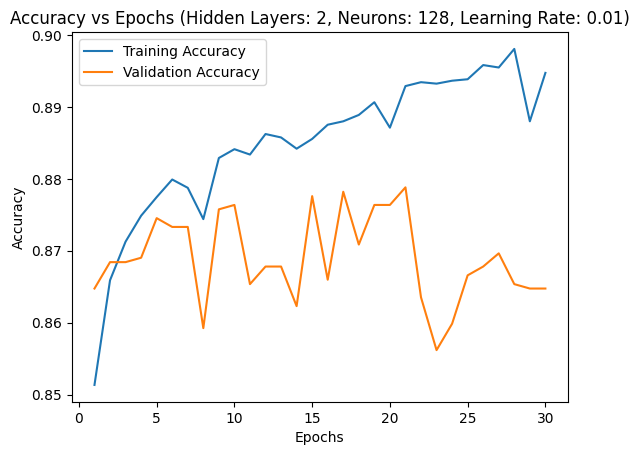

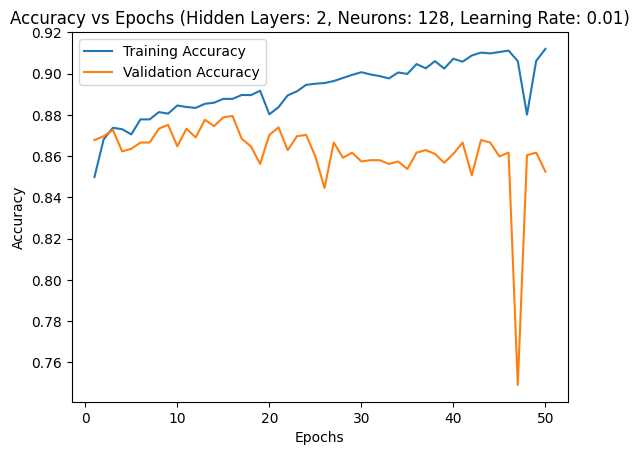

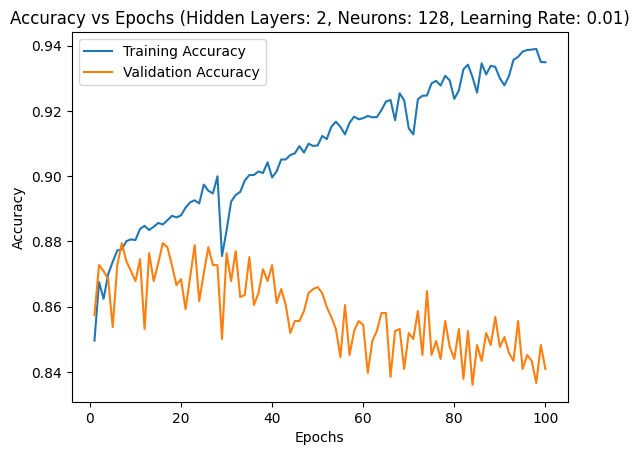

---------------------------------------------------------------


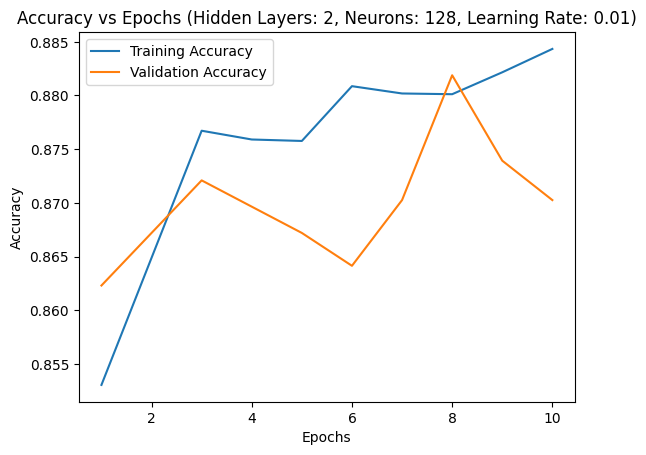

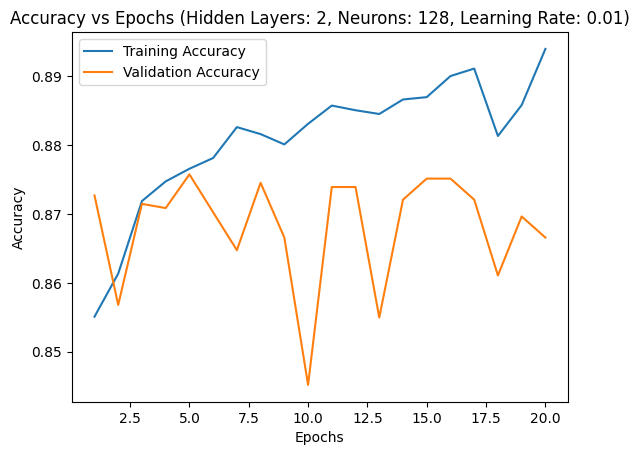

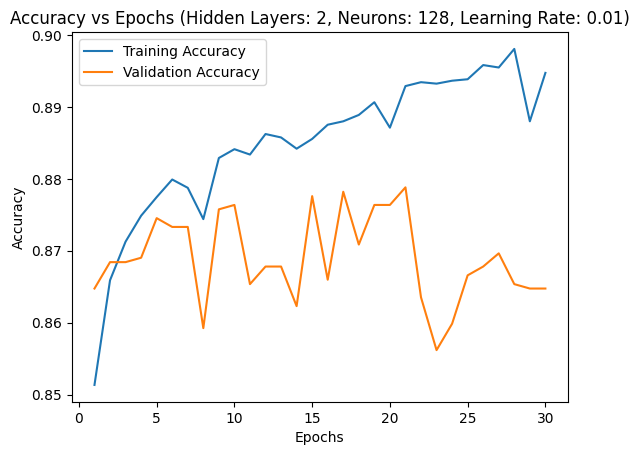

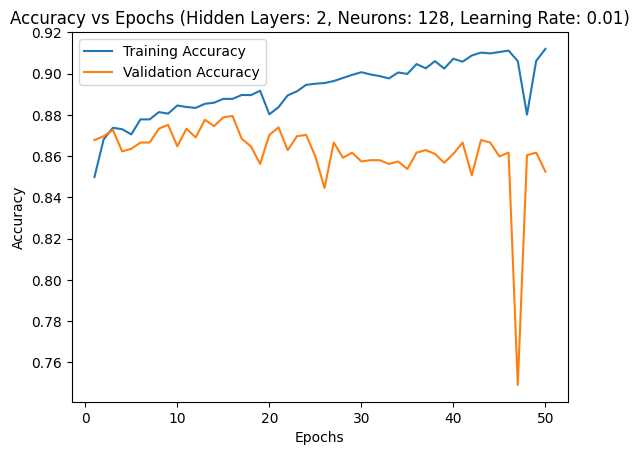

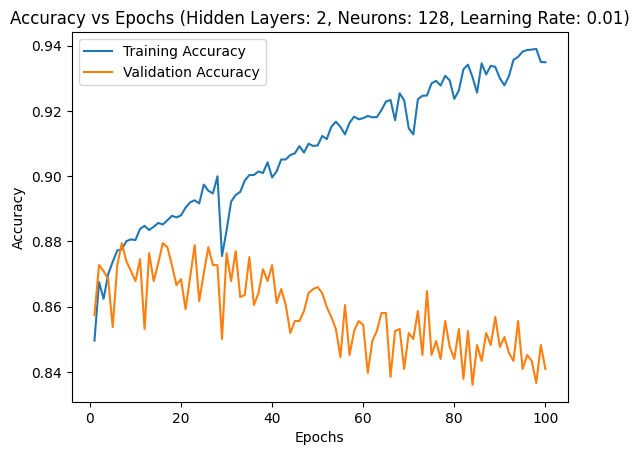

---------------------------------------------------------------


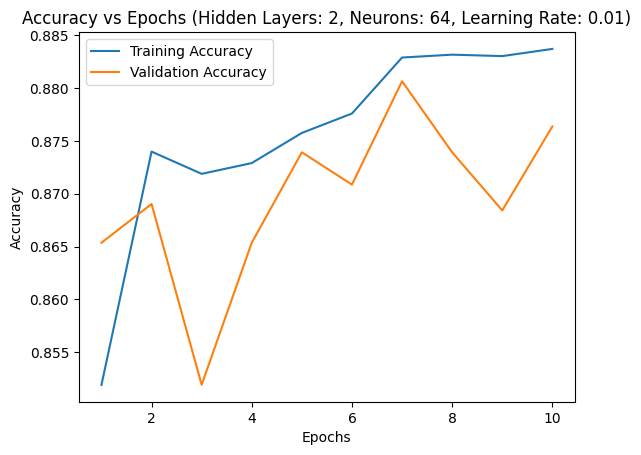

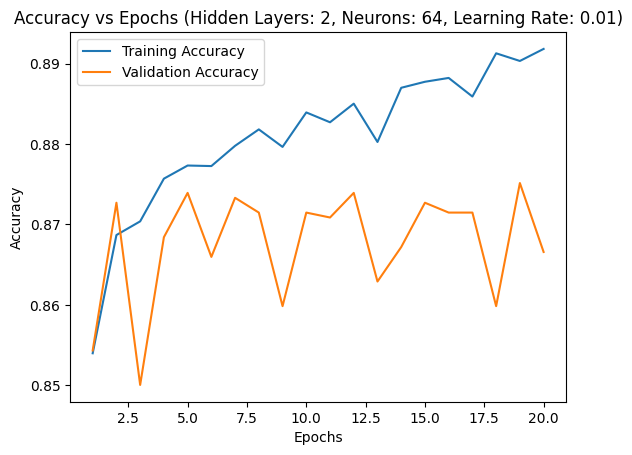

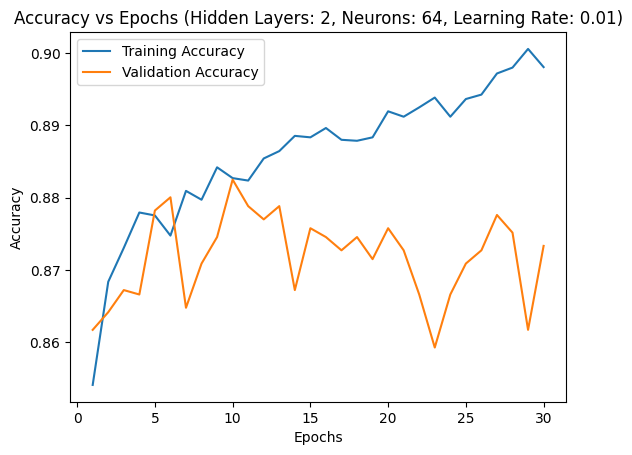

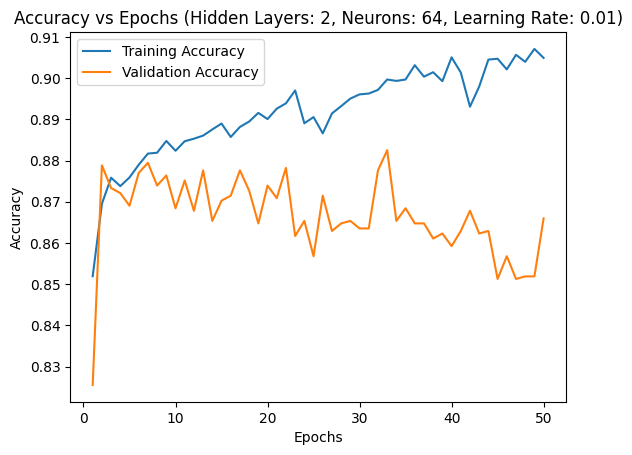

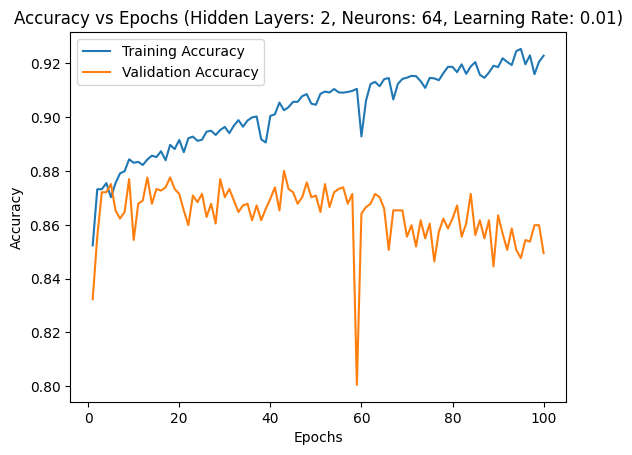

---------------------------------------------------------------


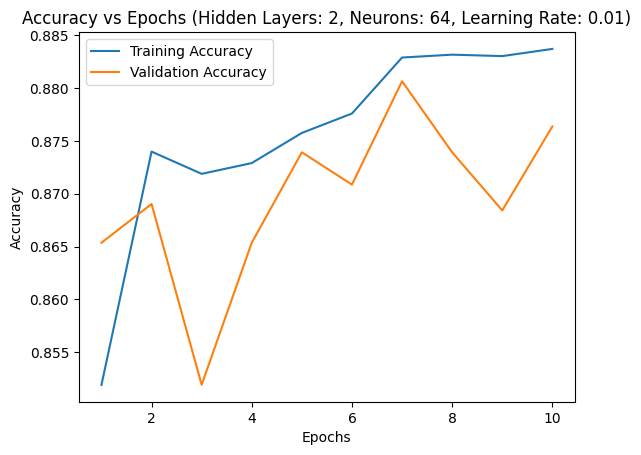

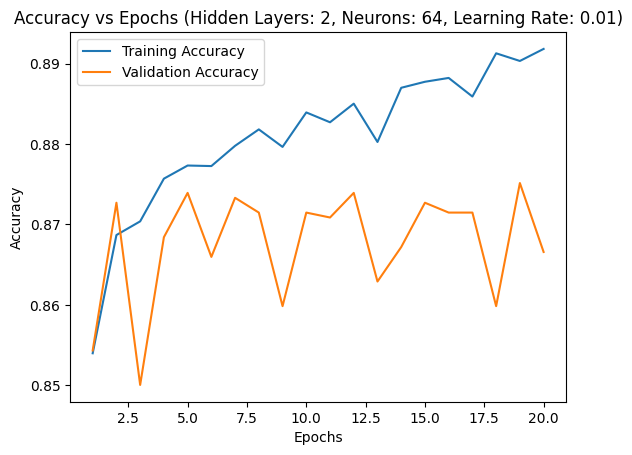

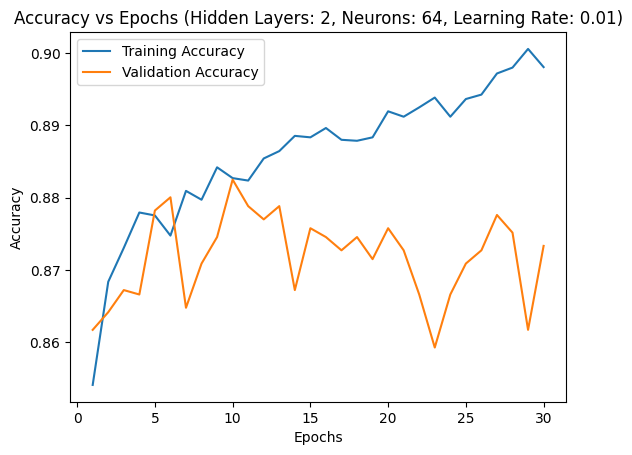

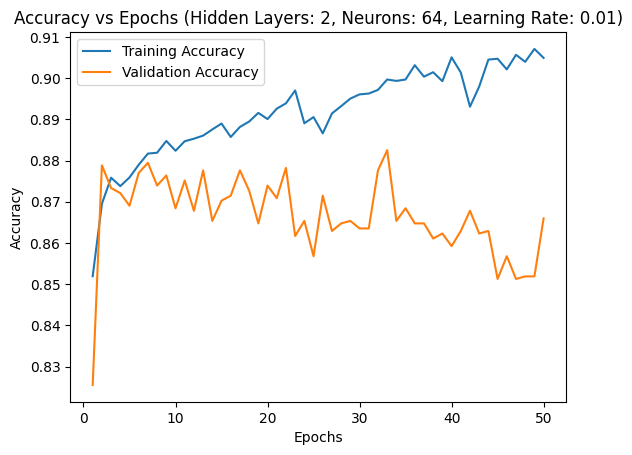

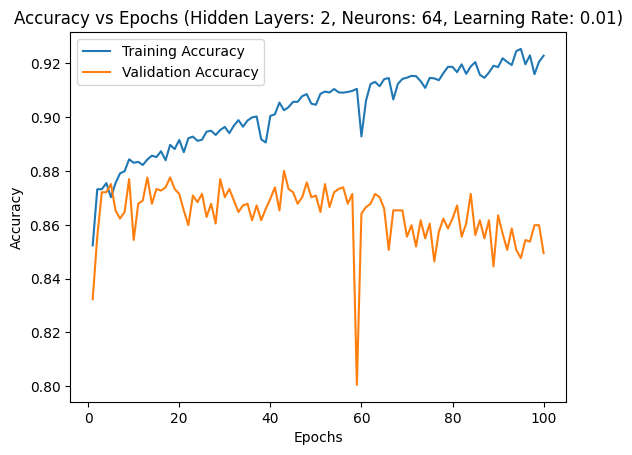

---------------------------------------------------------------


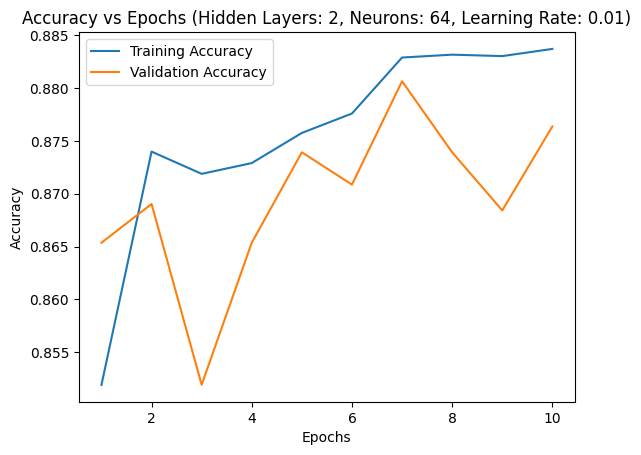

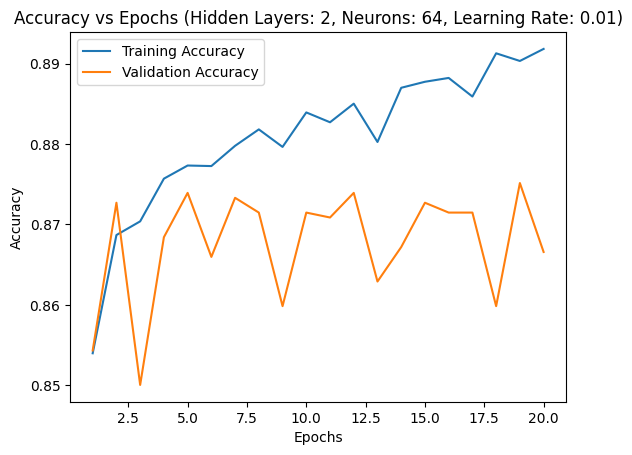

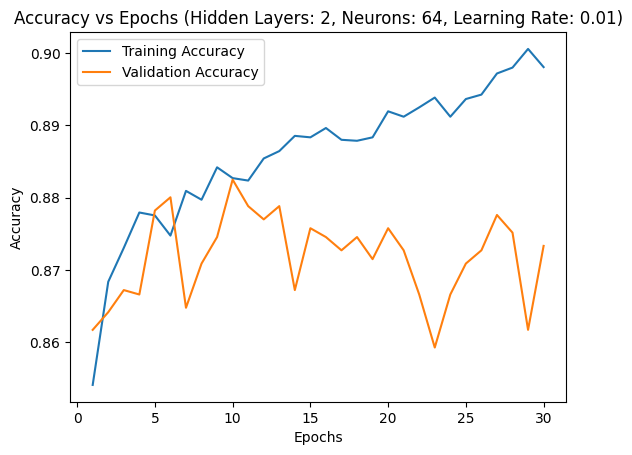

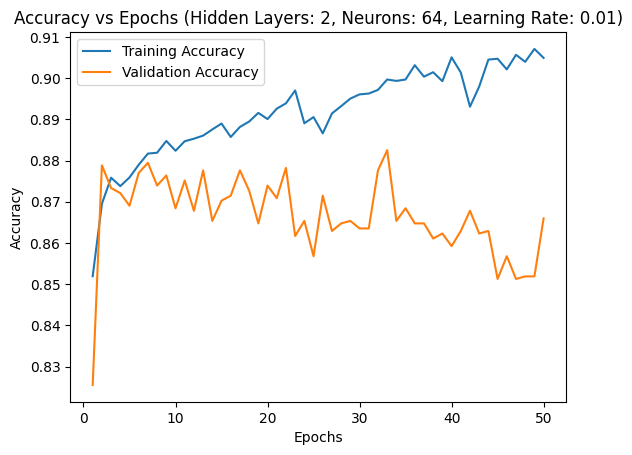

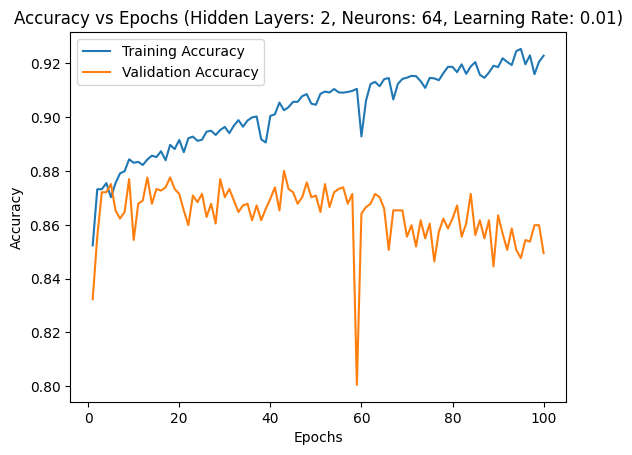

---------------------------------------------------------------


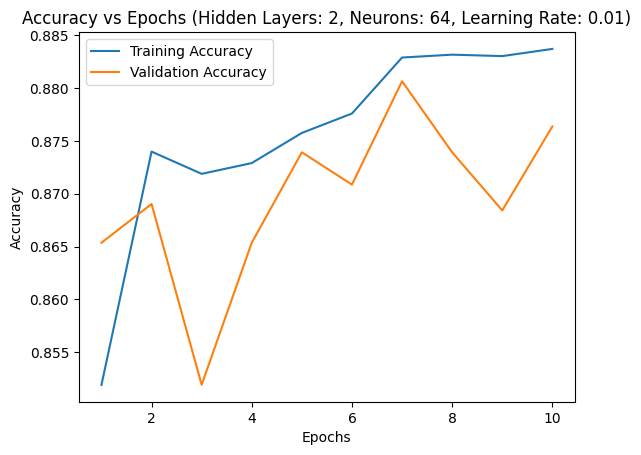

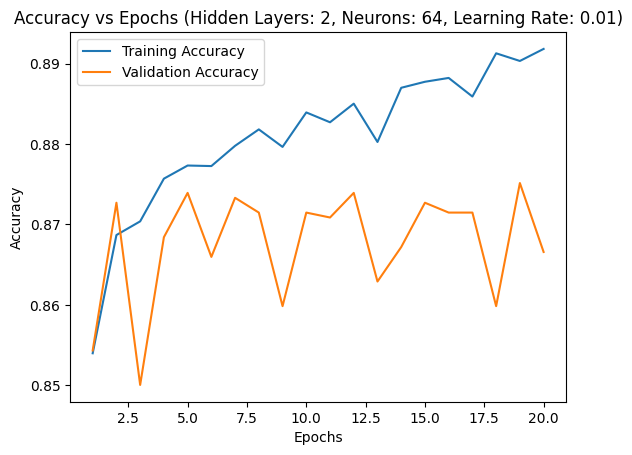

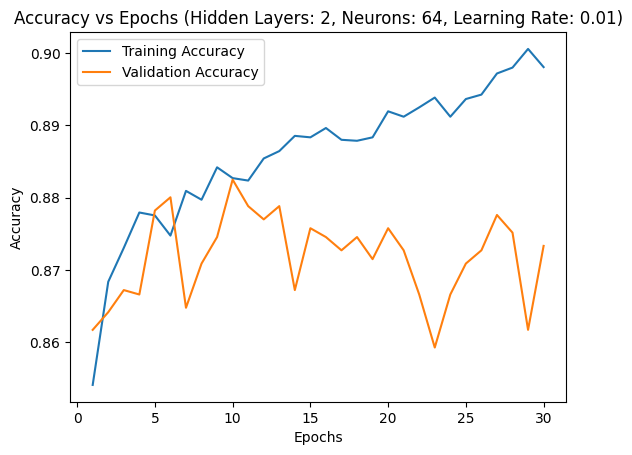

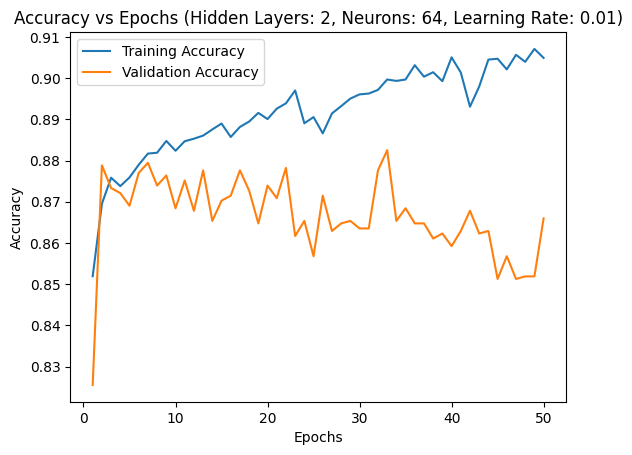

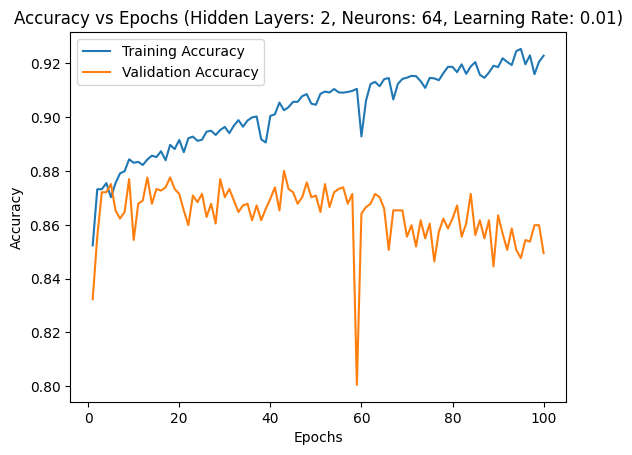

---------------------------------------------------------------


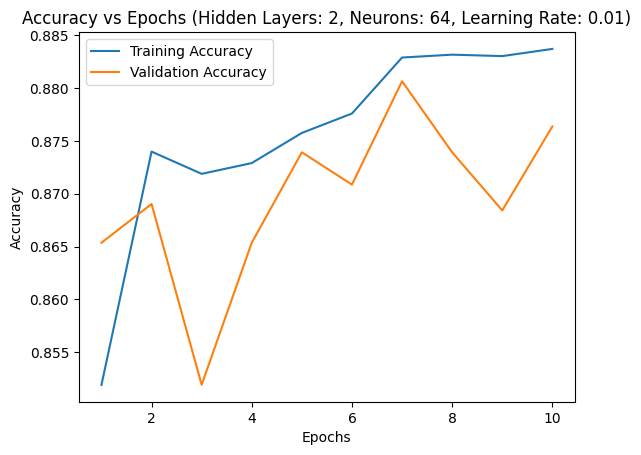

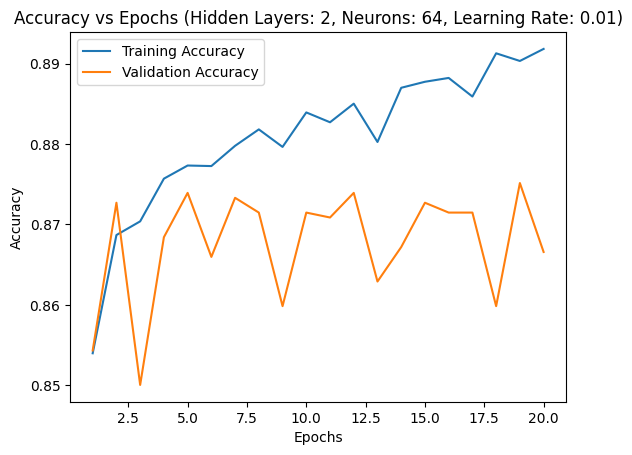

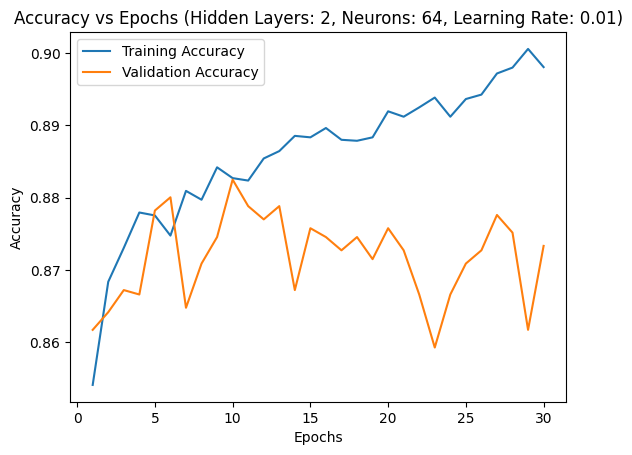

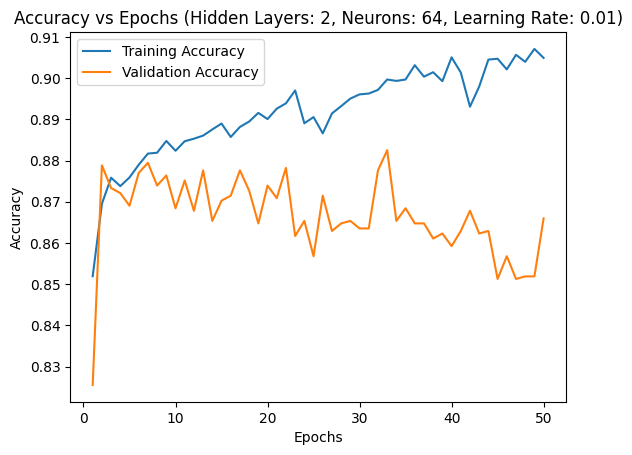

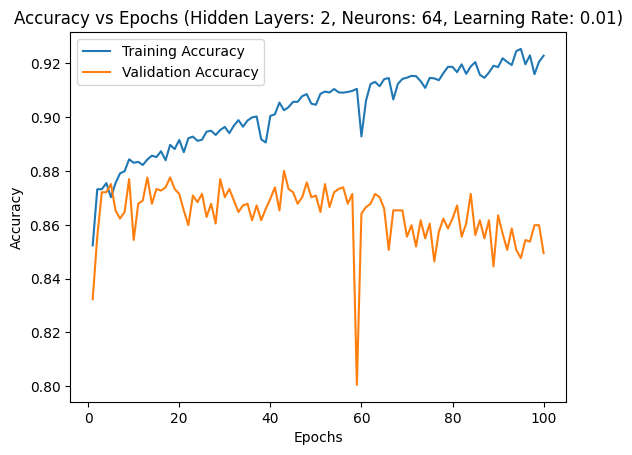

---------------------------------------------------------------


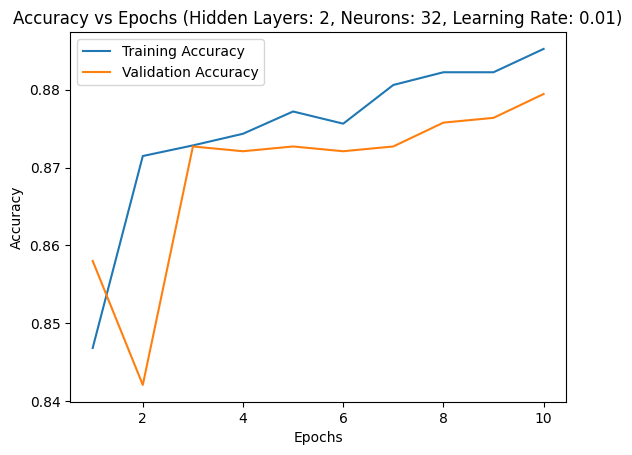

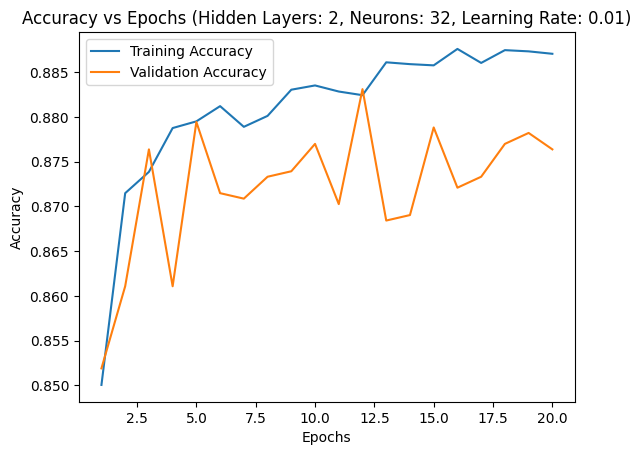

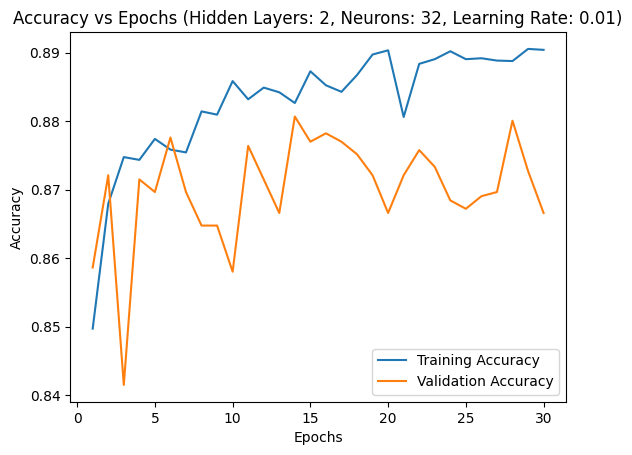

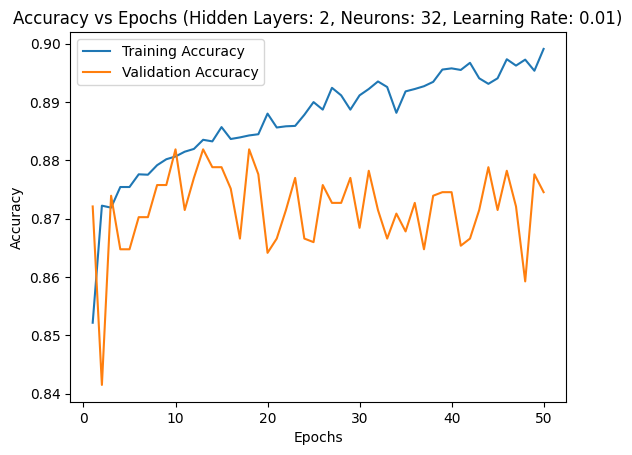

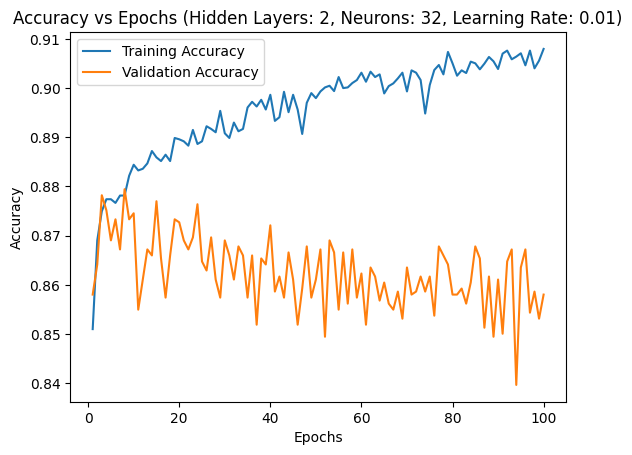

---------------------------------------------------------------


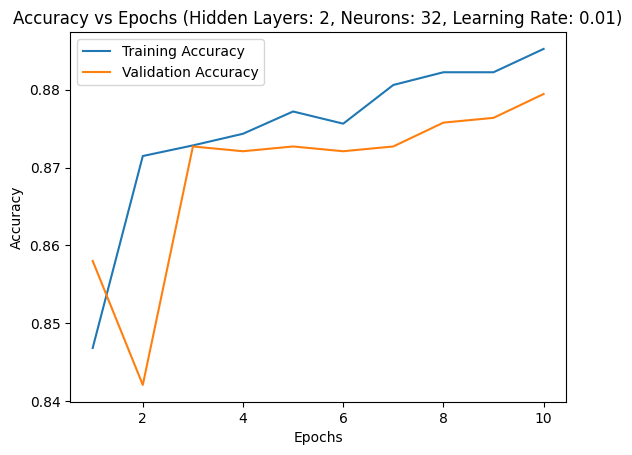

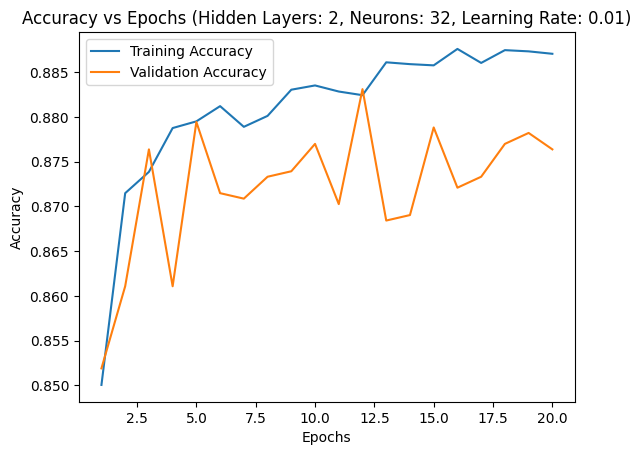

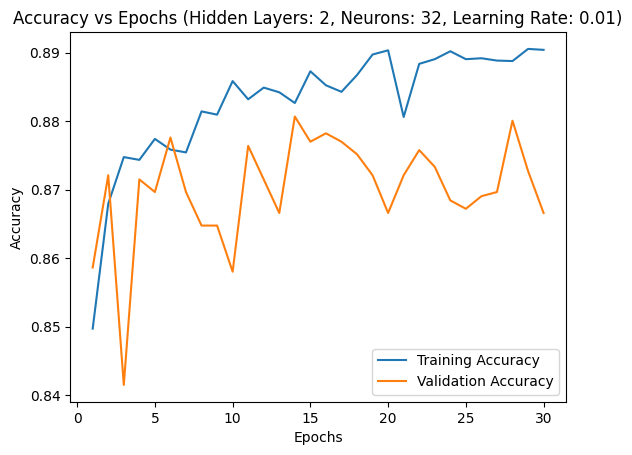

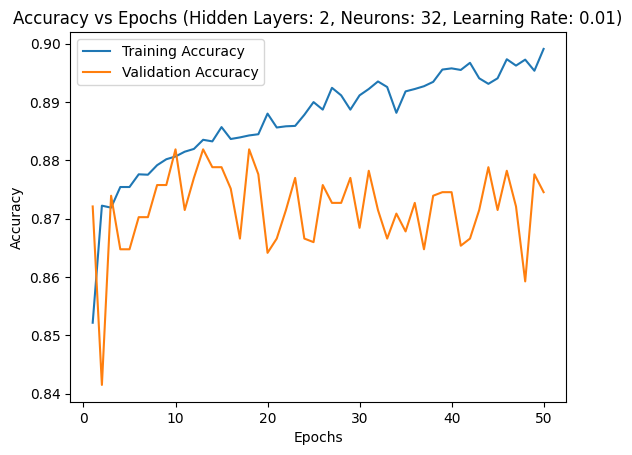

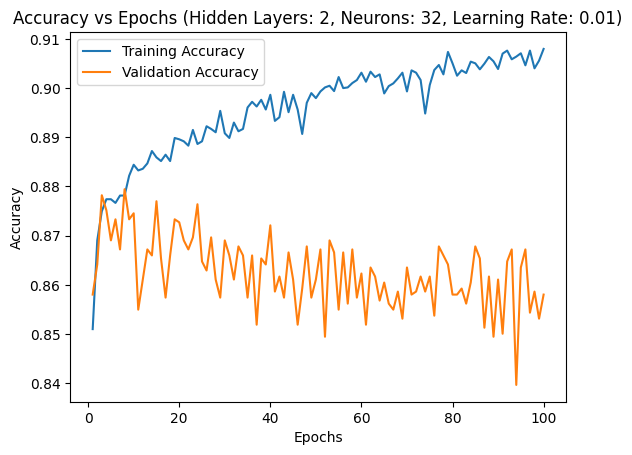

---------------------------------------------------------------


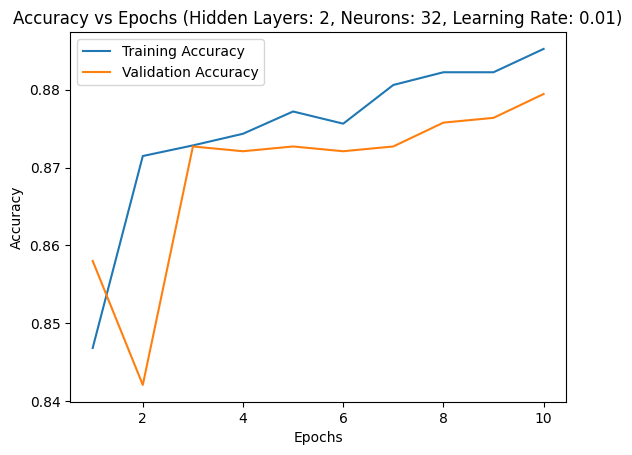

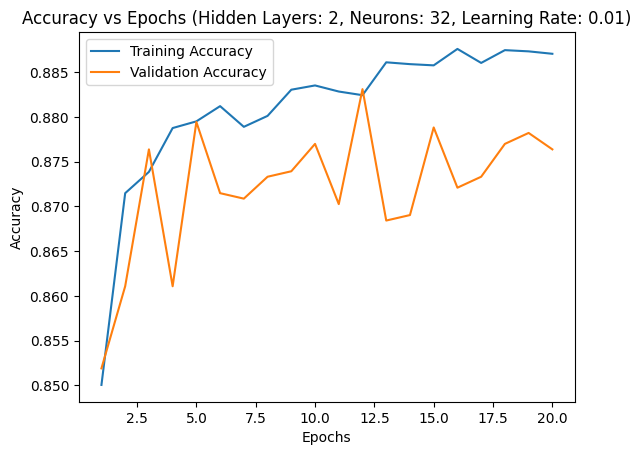

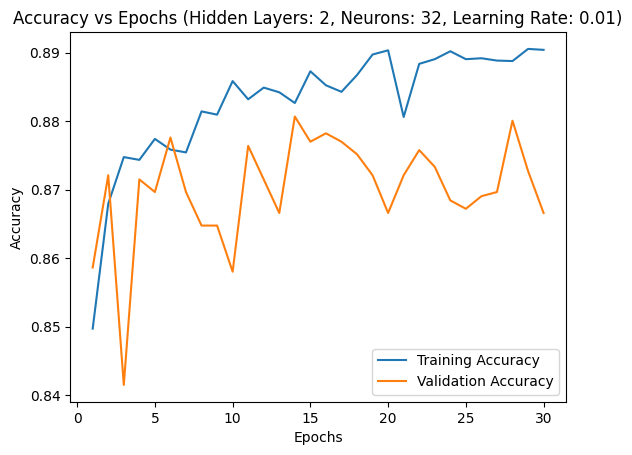

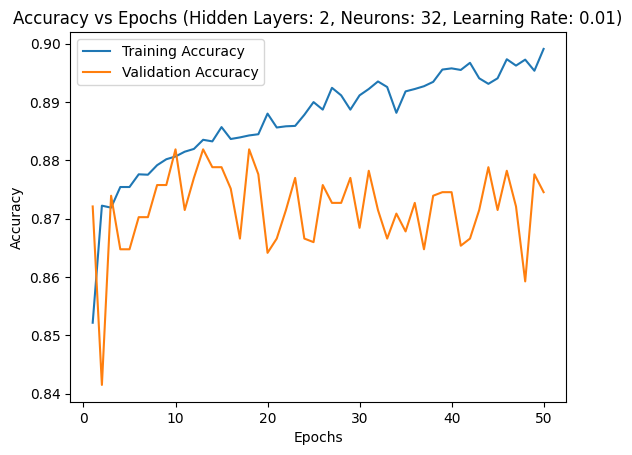

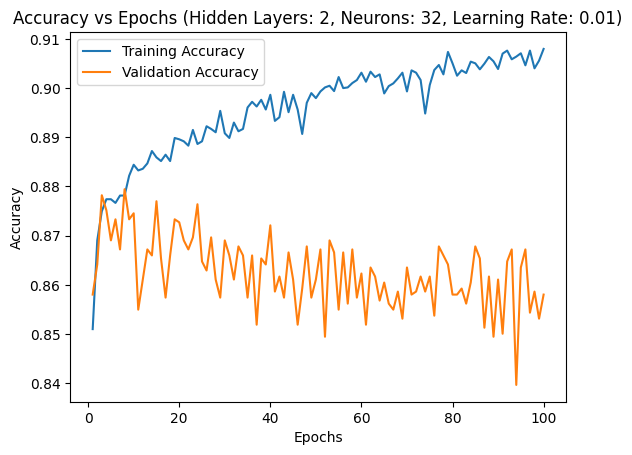

---------------------------------------------------------------


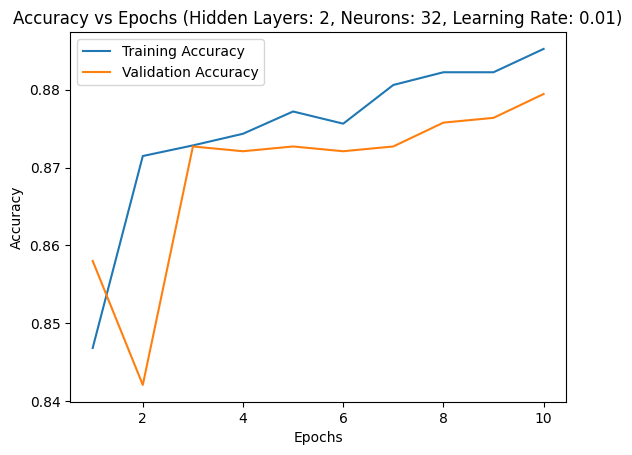

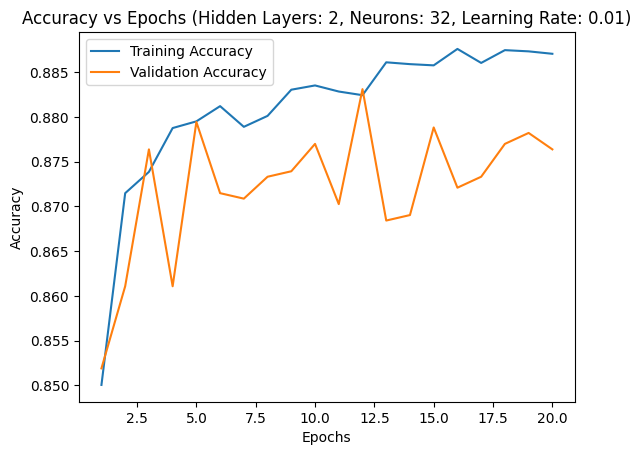

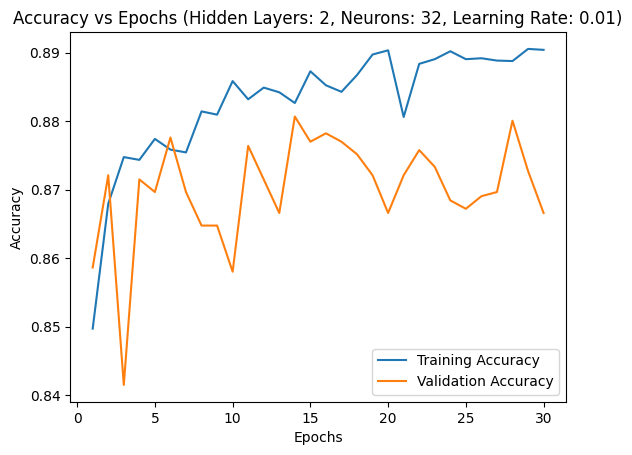

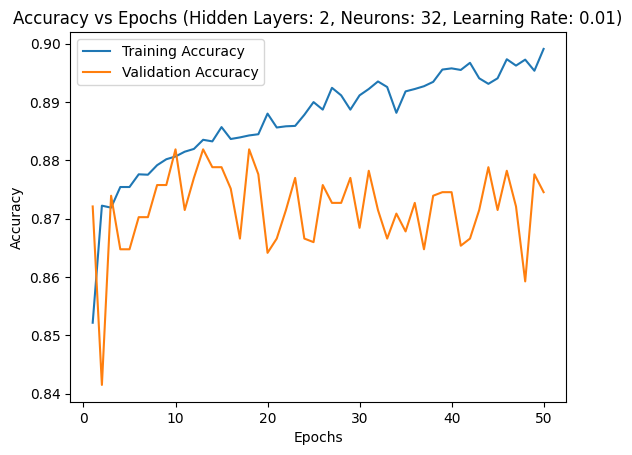

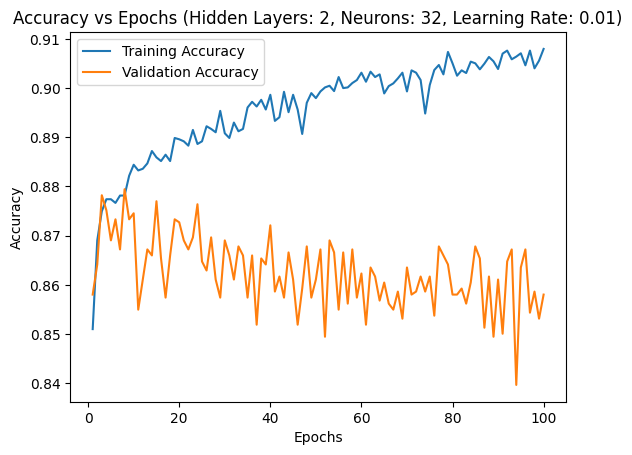

---------------------------------------------------------------


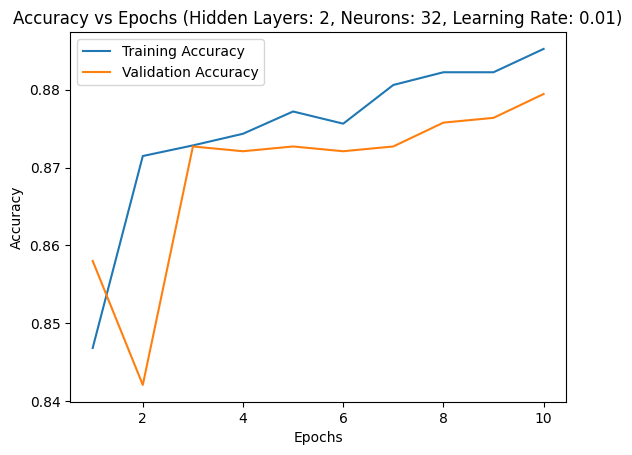

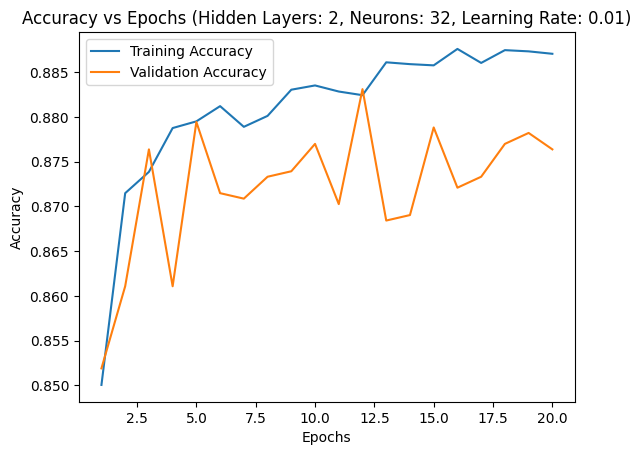

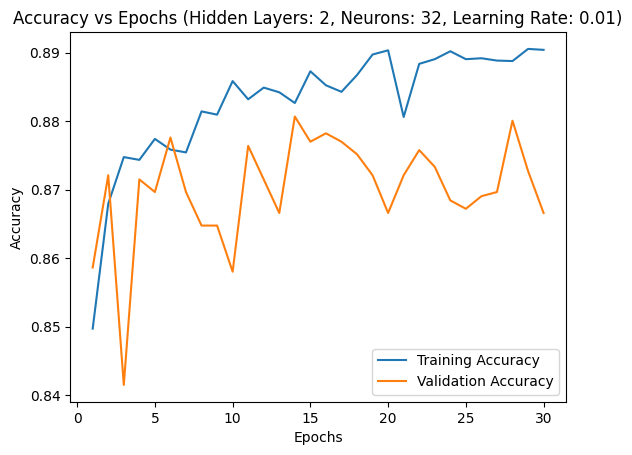

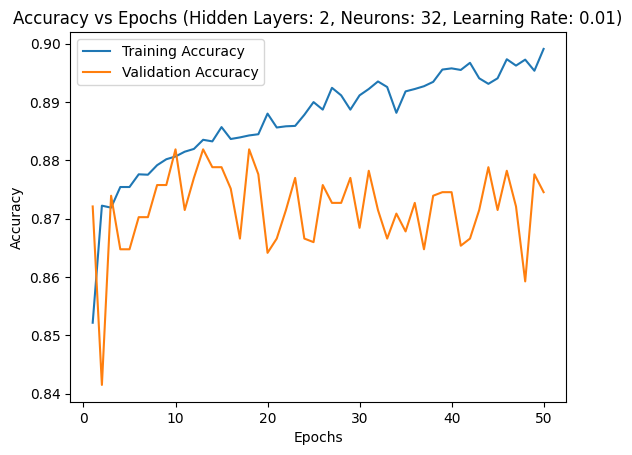

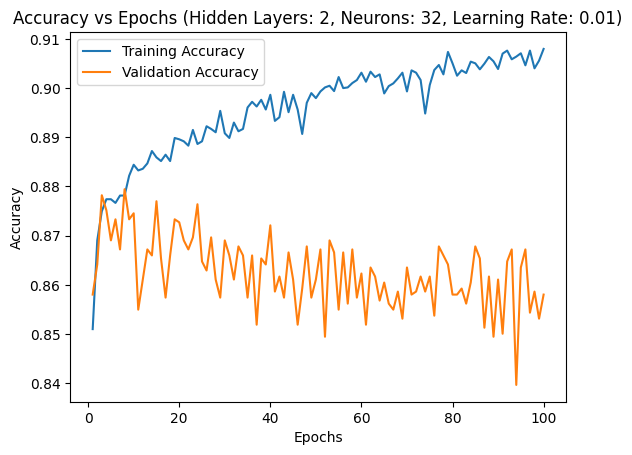

---------------------------------------------------------------


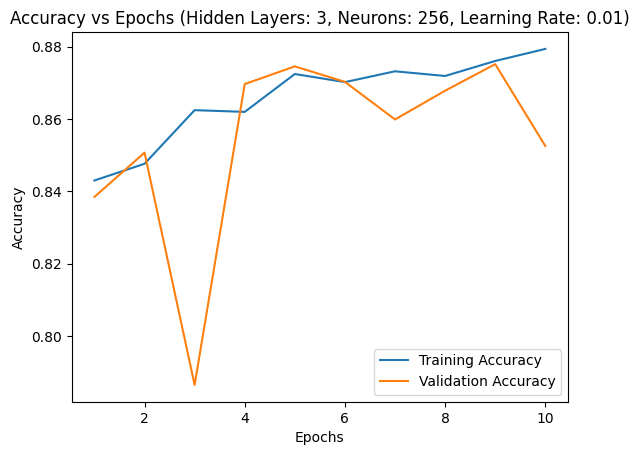

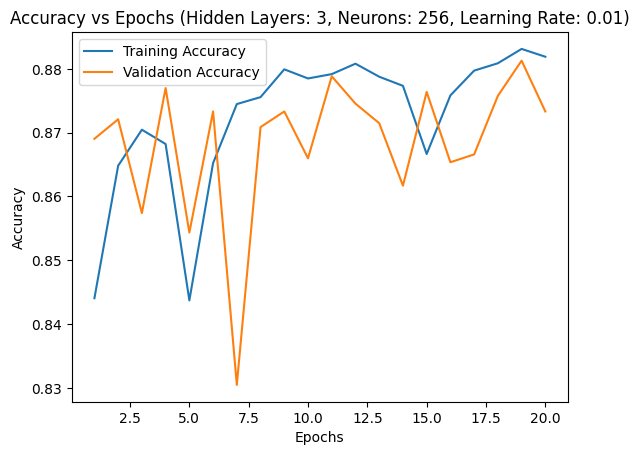

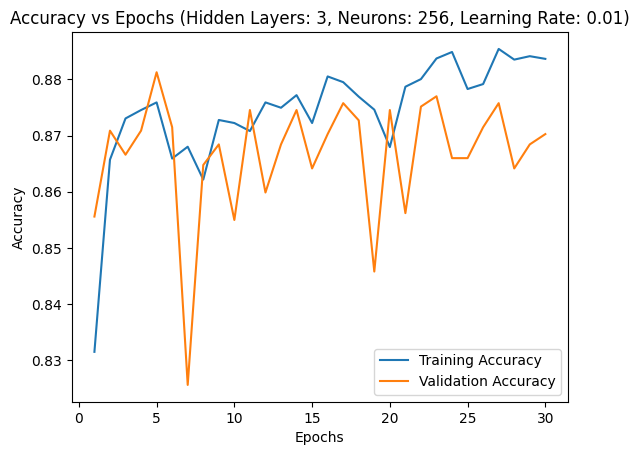

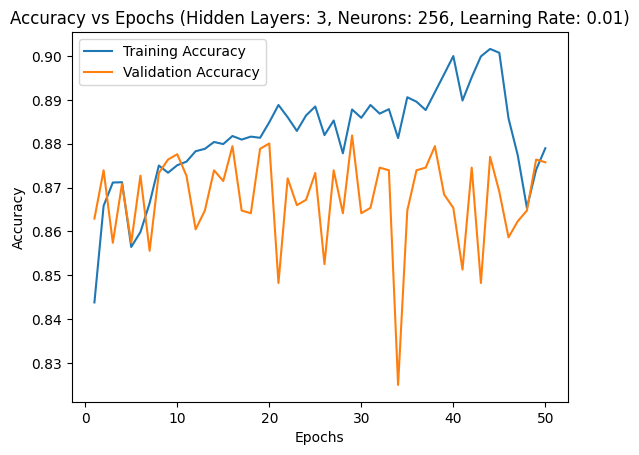

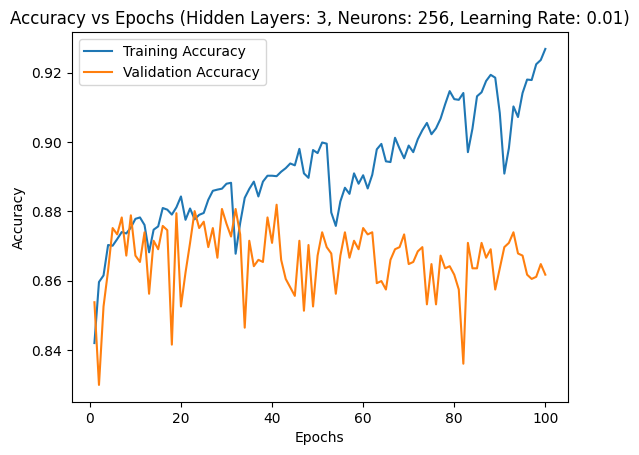

---------------------------------------------------------------


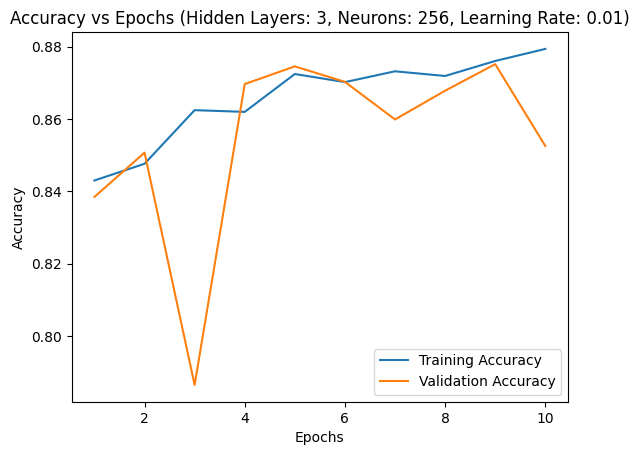

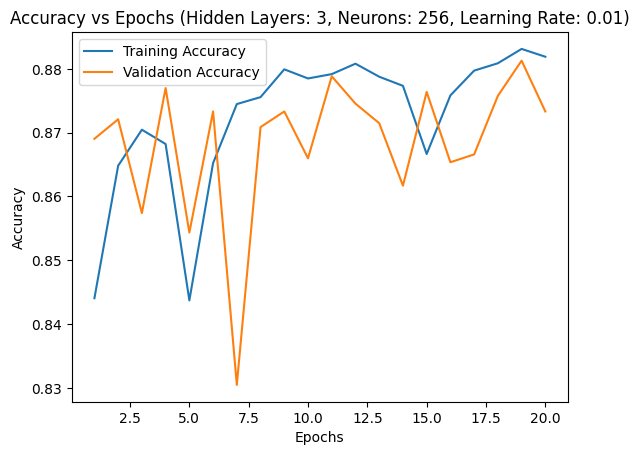

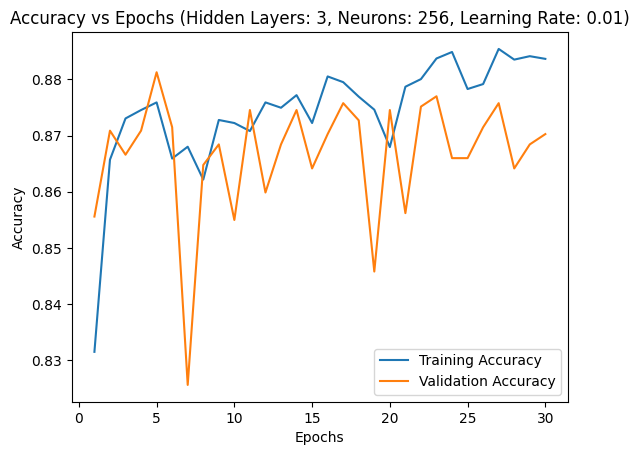

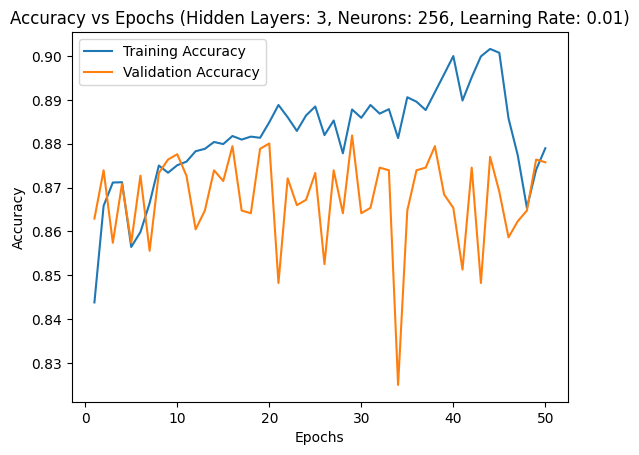

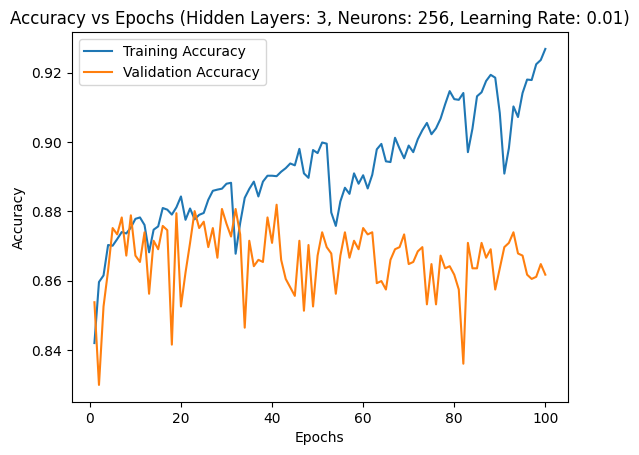

---------------------------------------------------------------


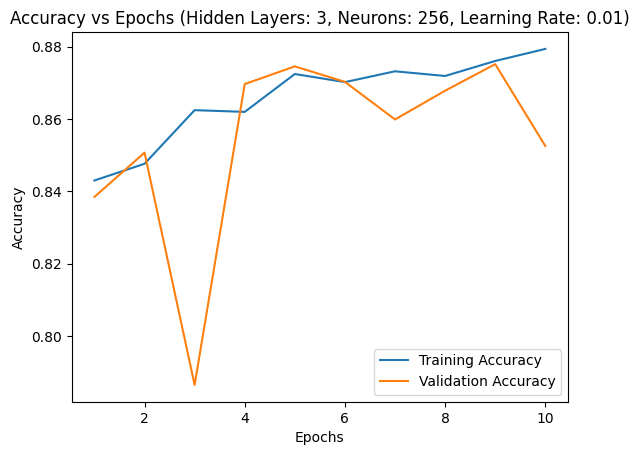

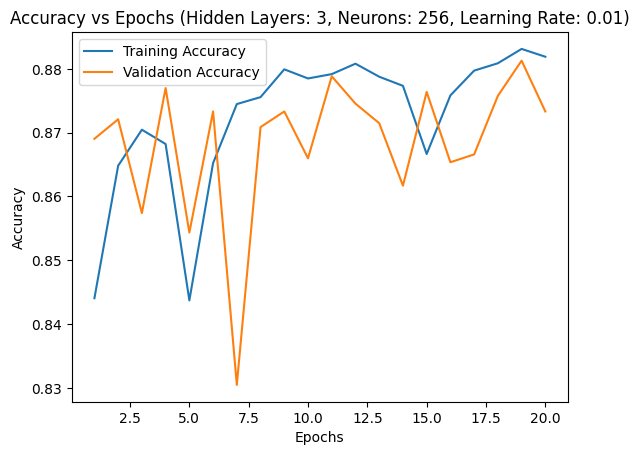

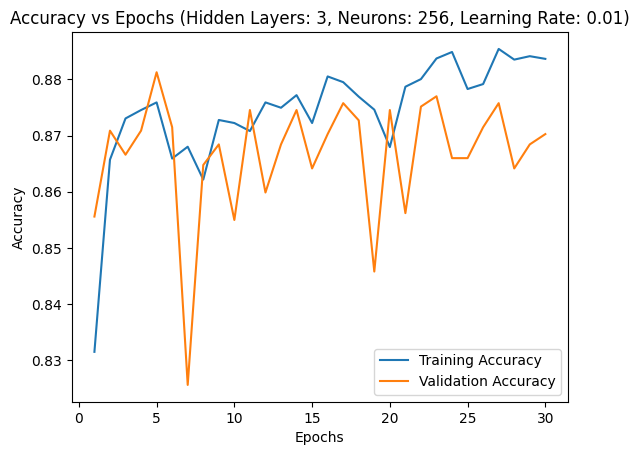

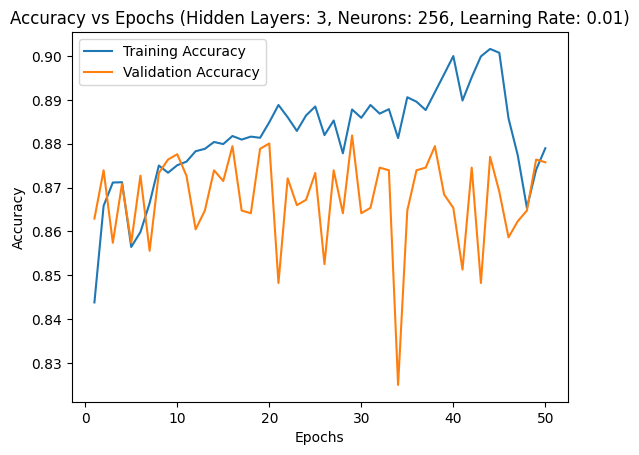

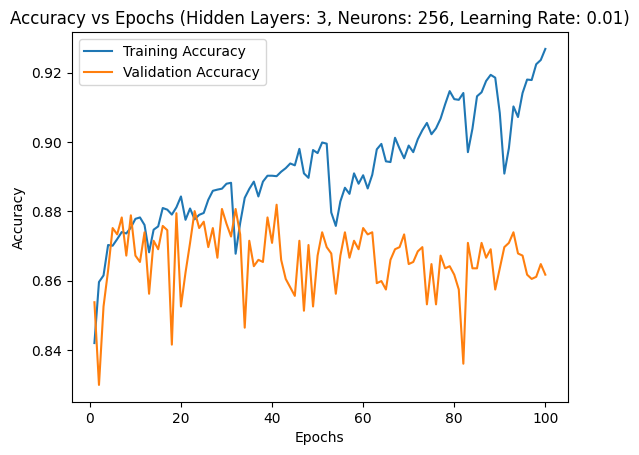

---------------------------------------------------------------


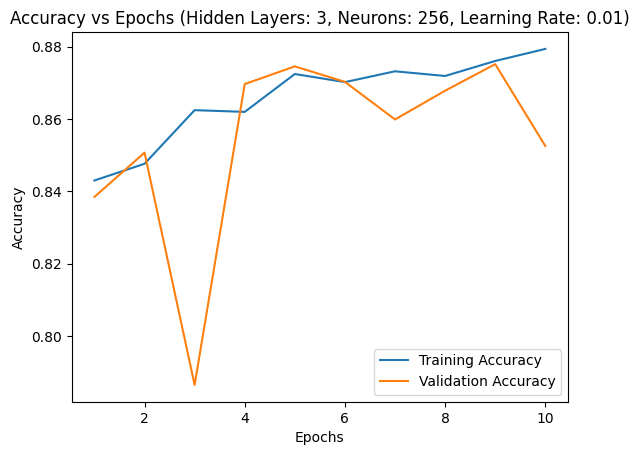

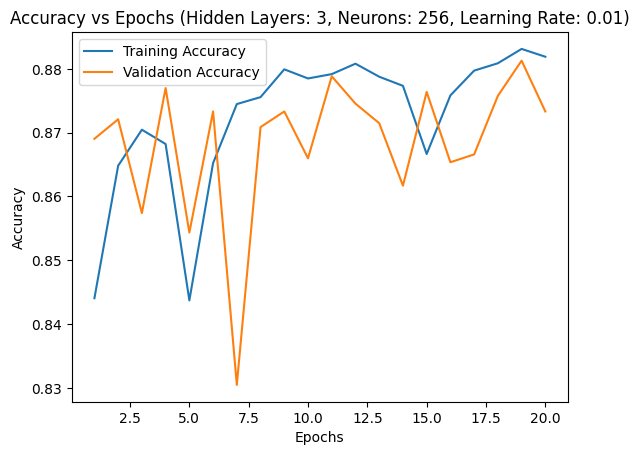

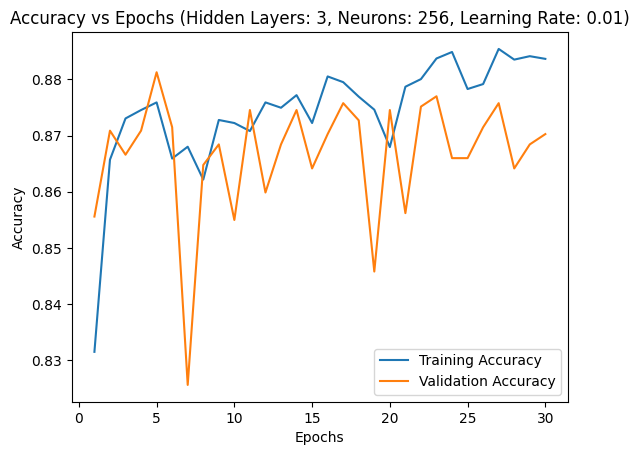

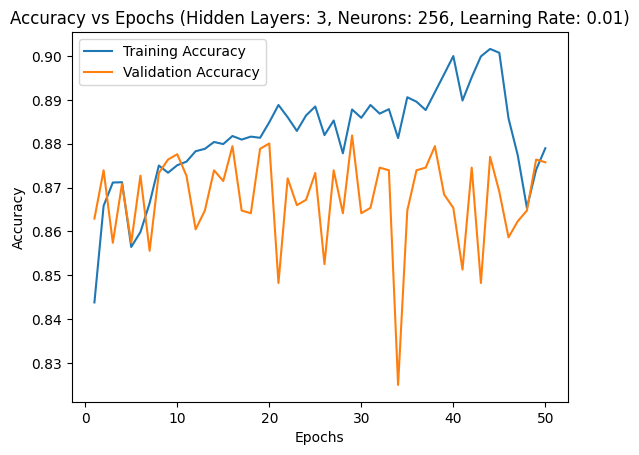

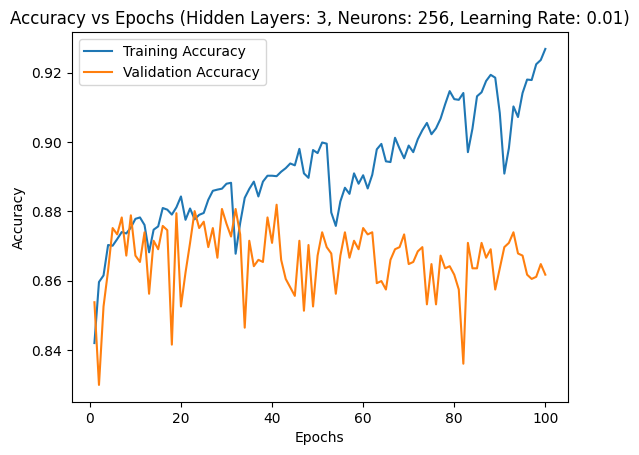

---------------------------------------------------------------


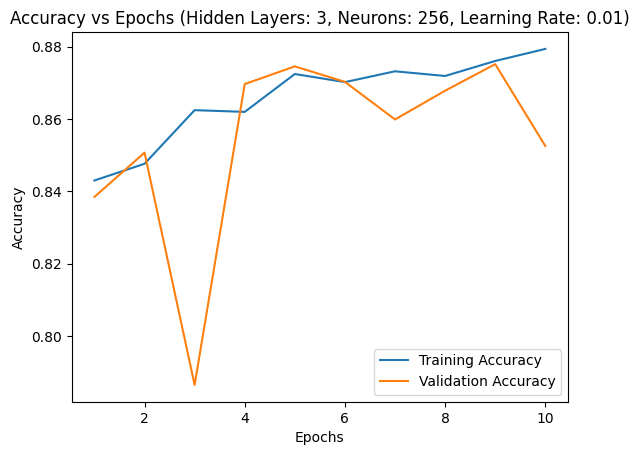

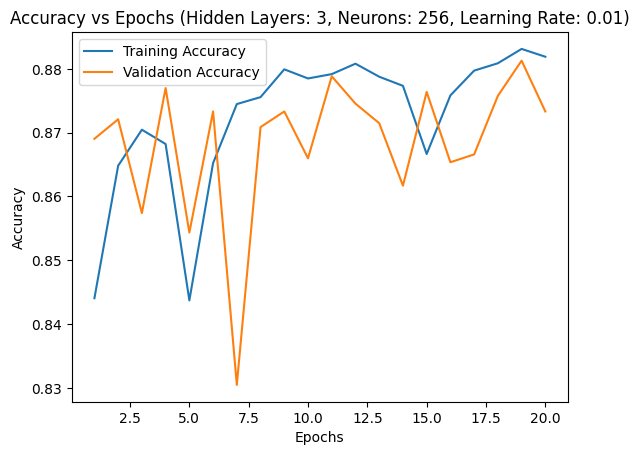

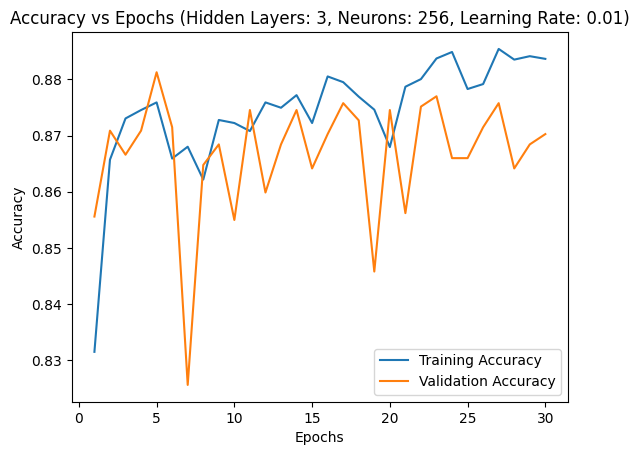

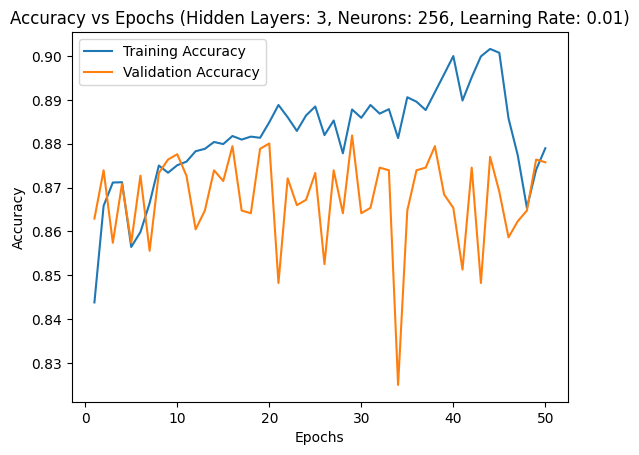

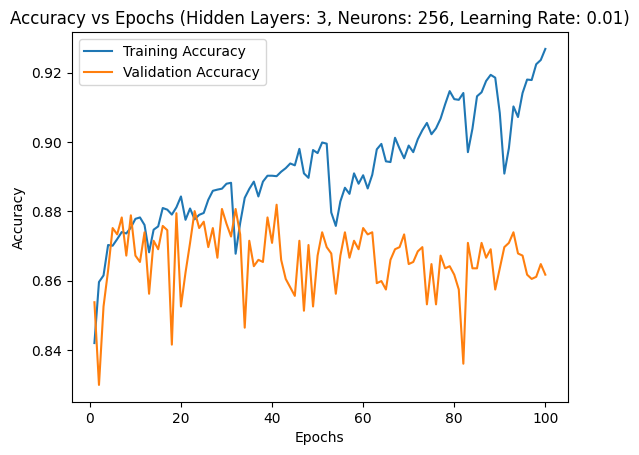

---------------------------------------------------------------


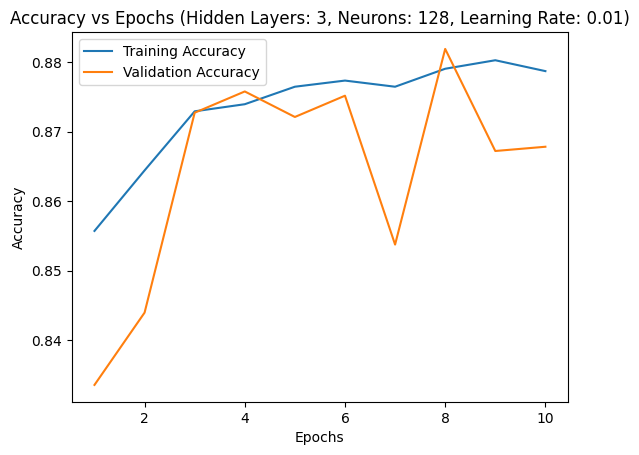

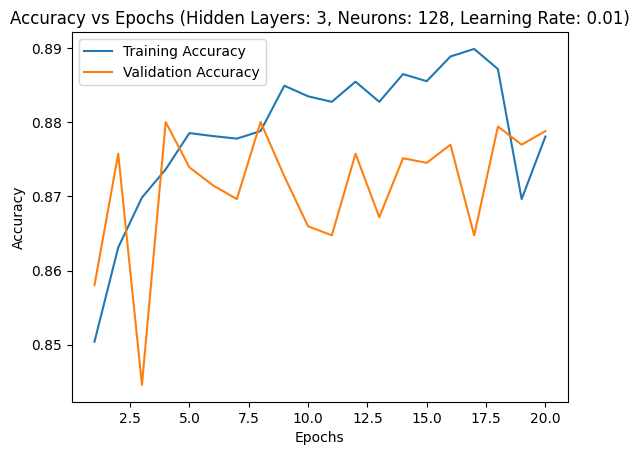

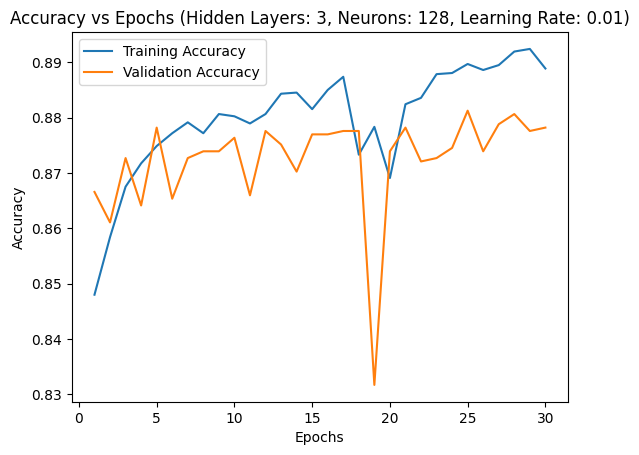

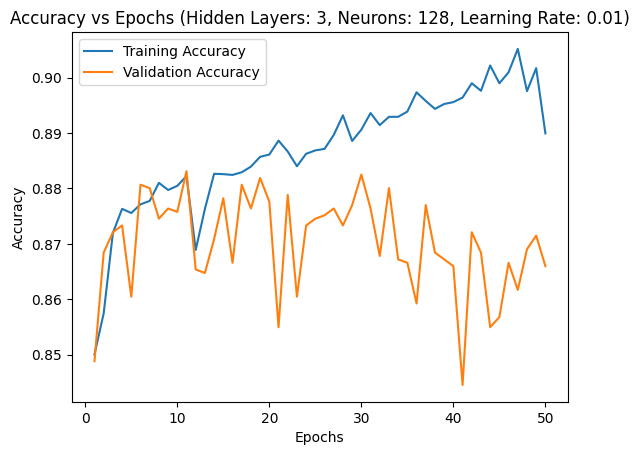

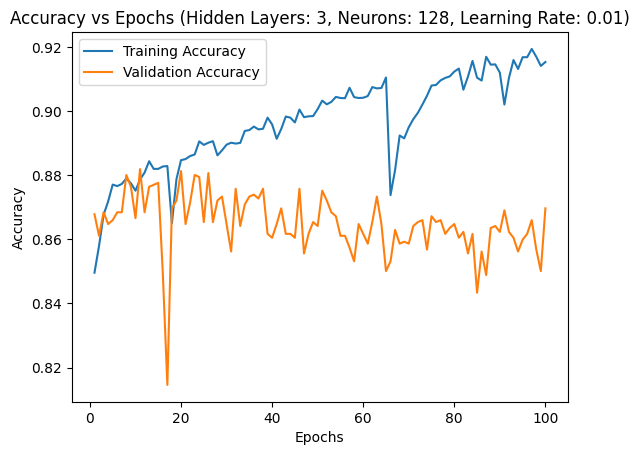

---------------------------------------------------------------


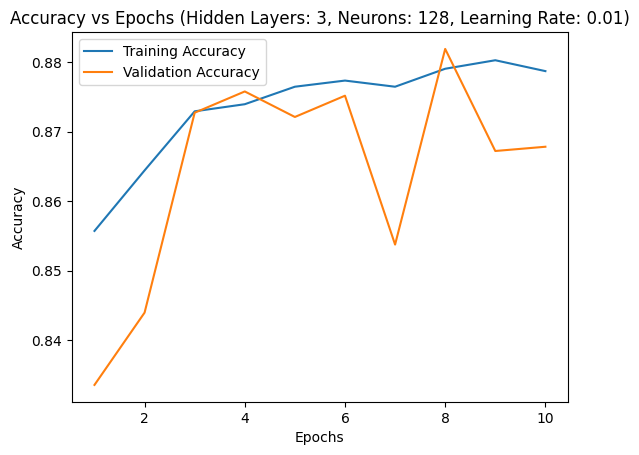

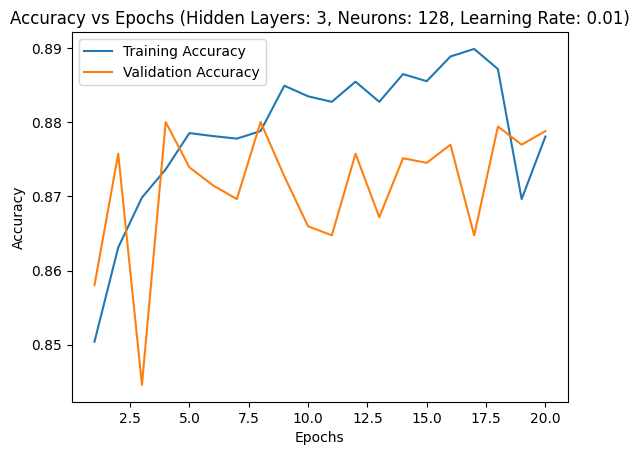

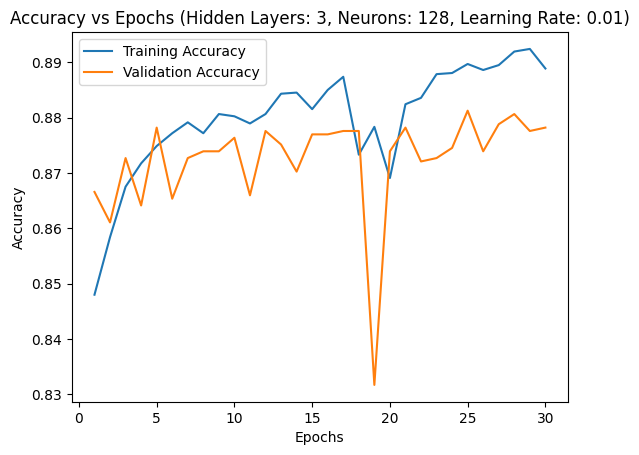

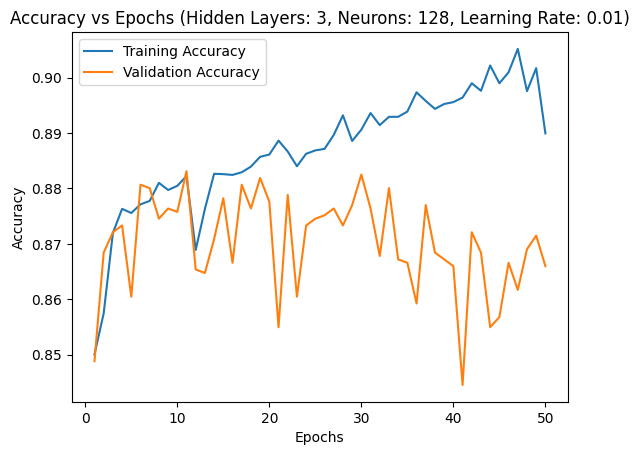

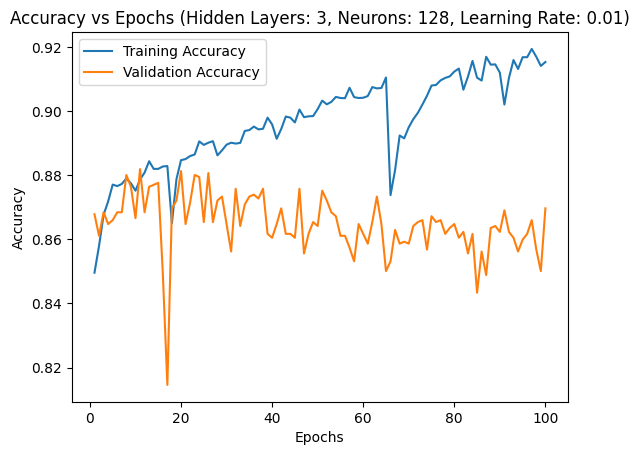

---------------------------------------------------------------


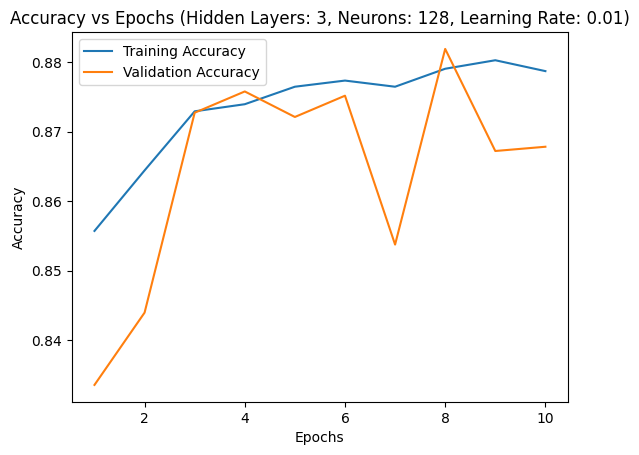

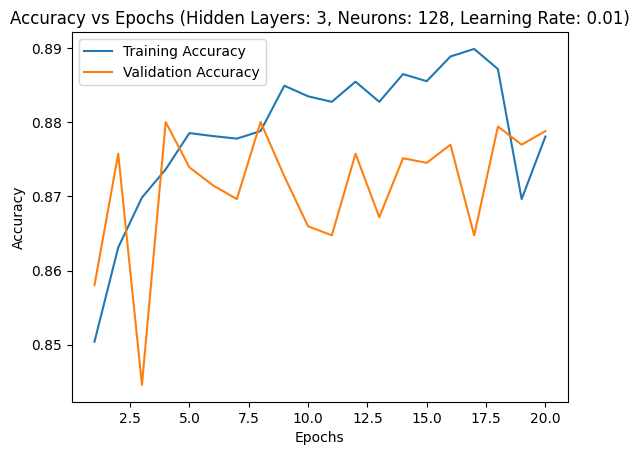

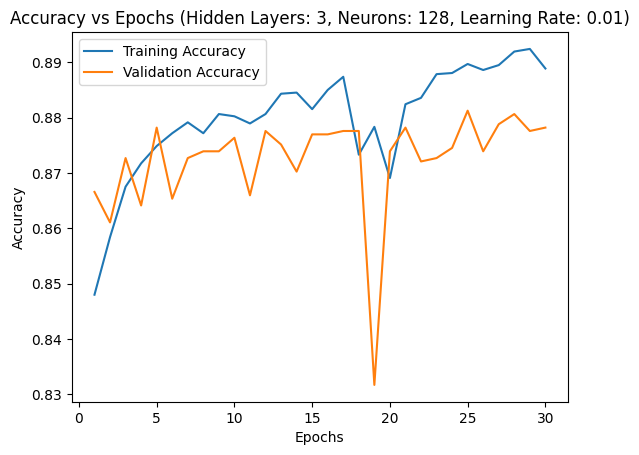

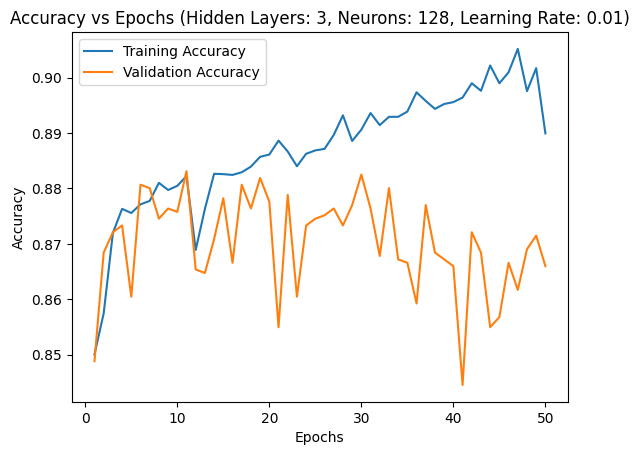

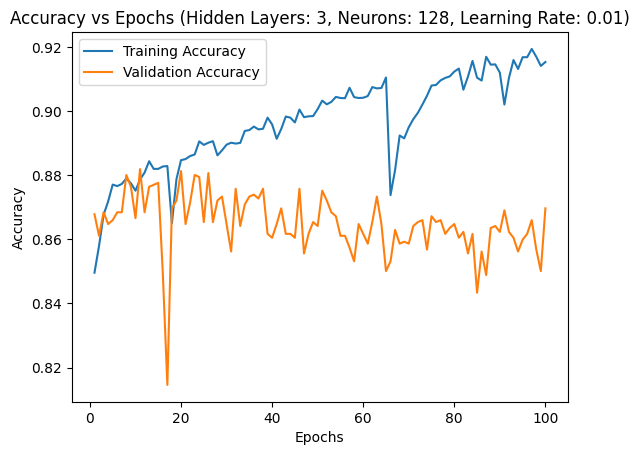

---------------------------------------------------------------


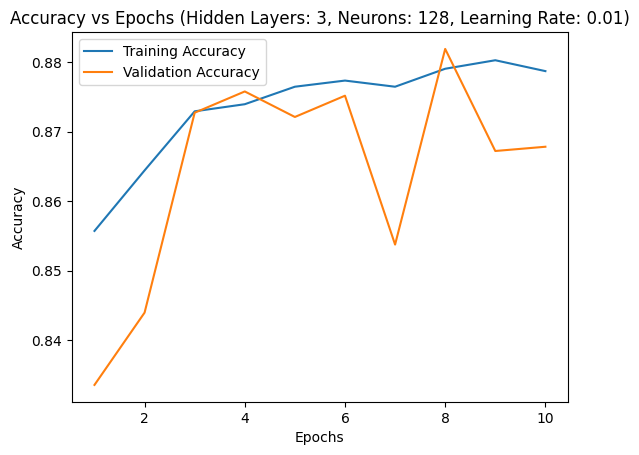

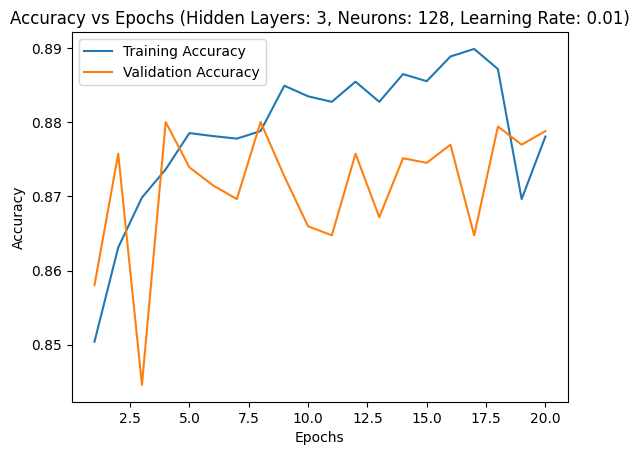

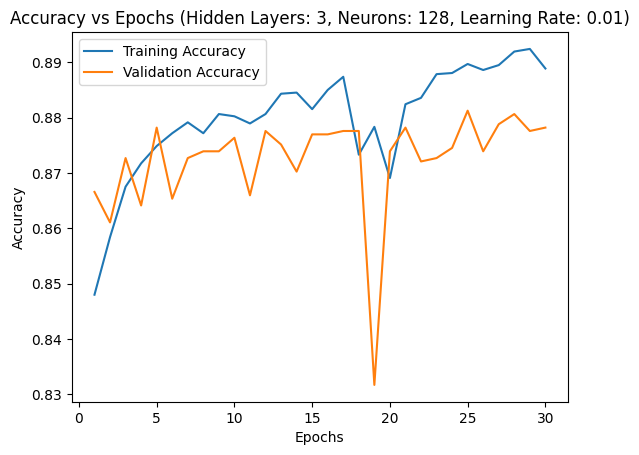

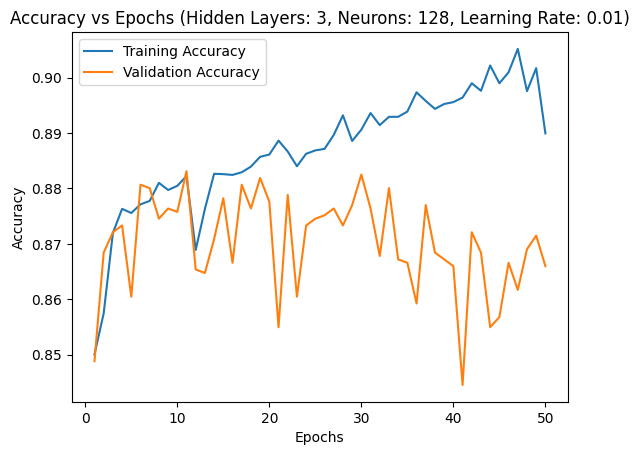

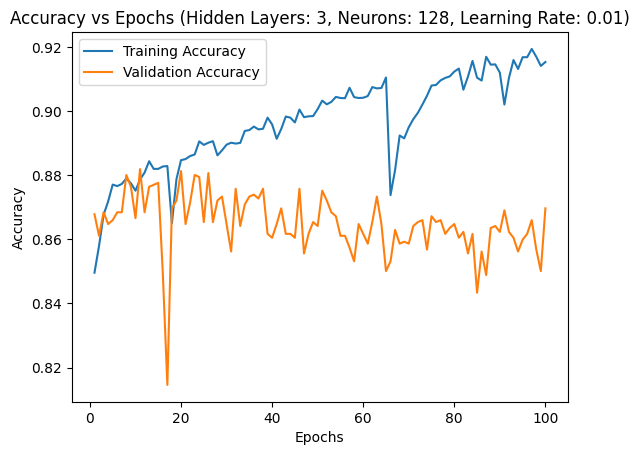

---------------------------------------------------------------


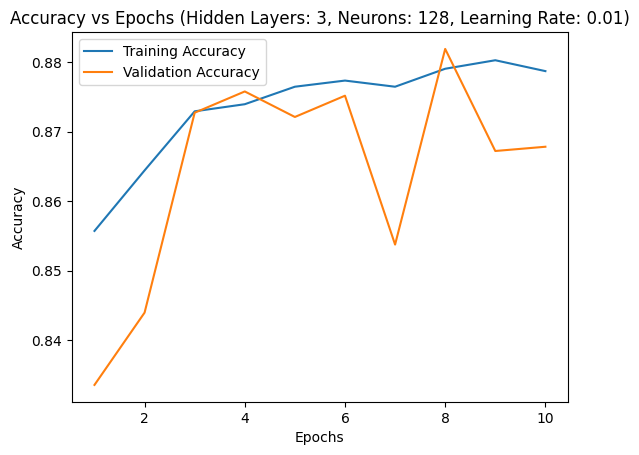

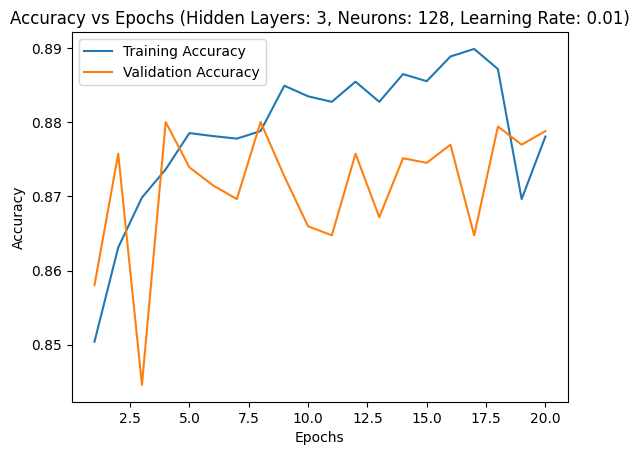

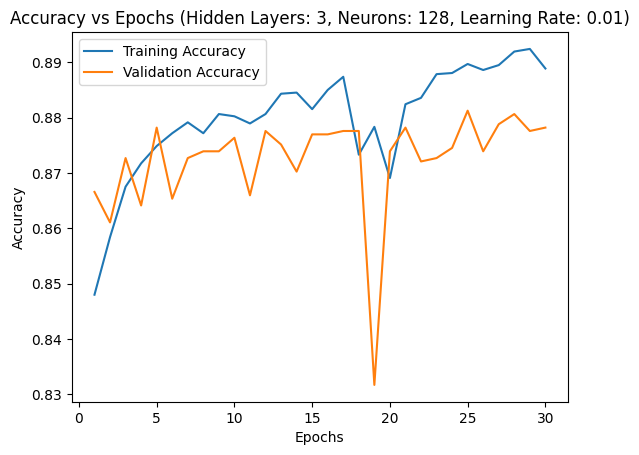

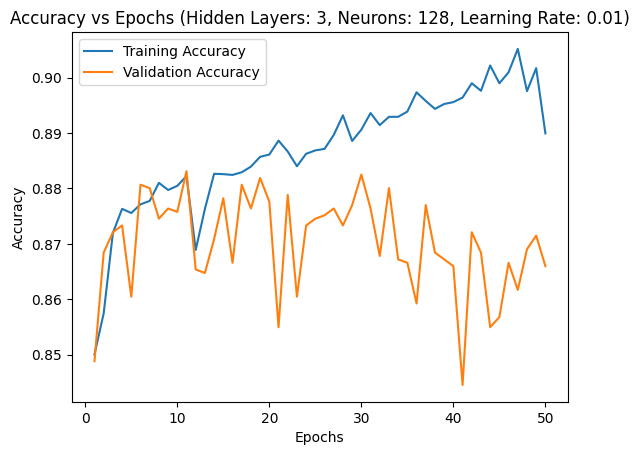

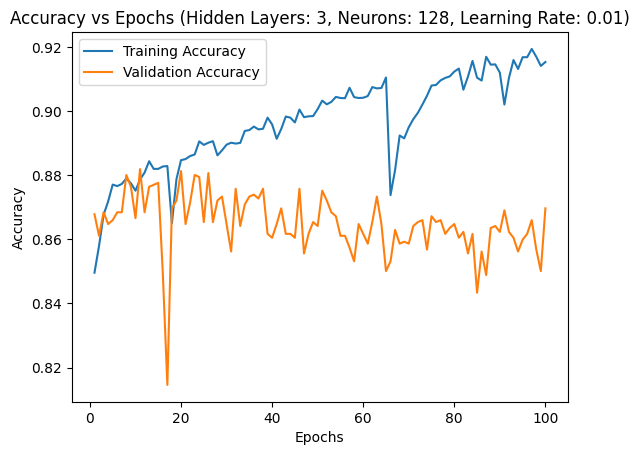

---------------------------------------------------------------


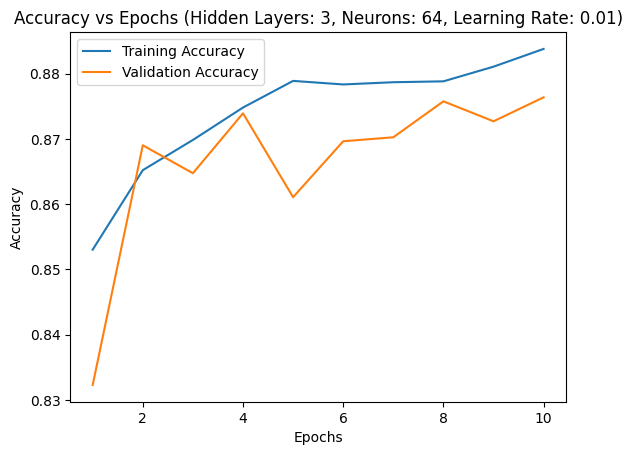

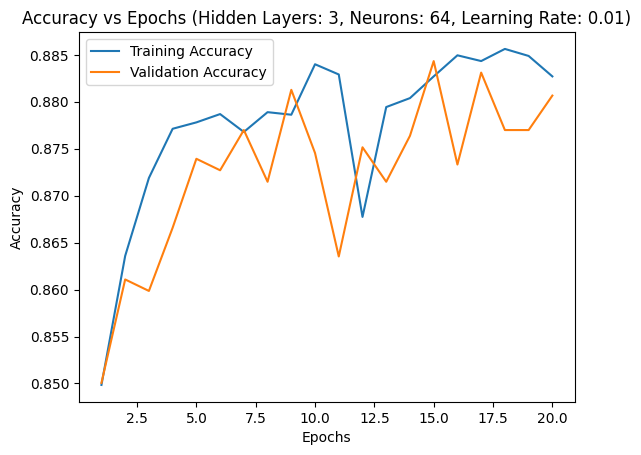

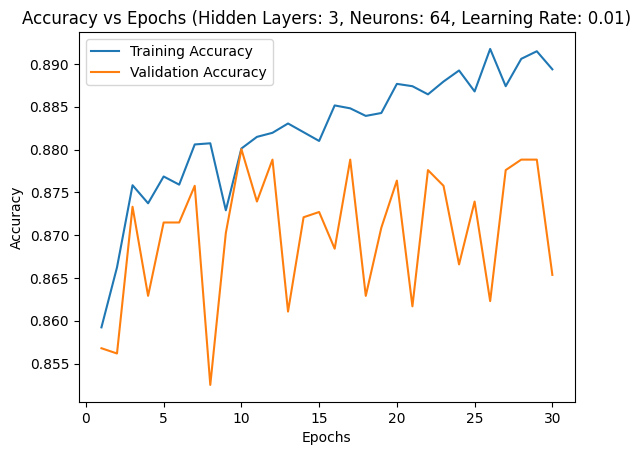

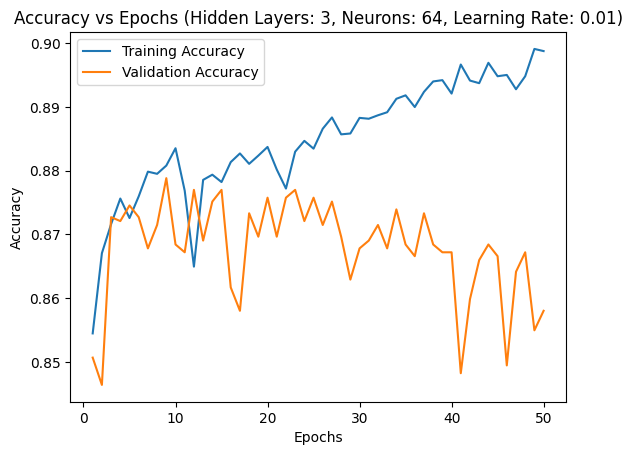

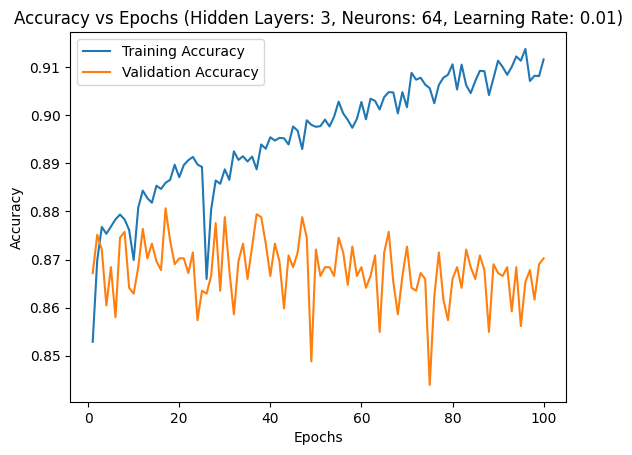

---------------------------------------------------------------


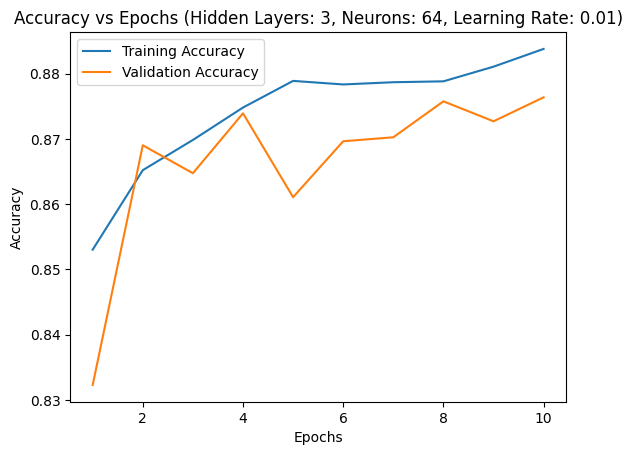

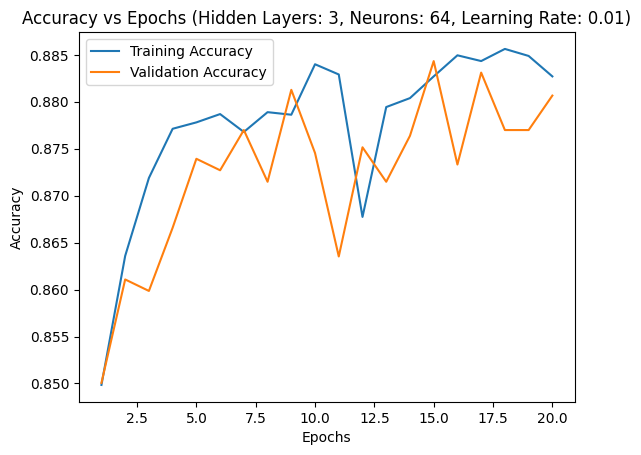

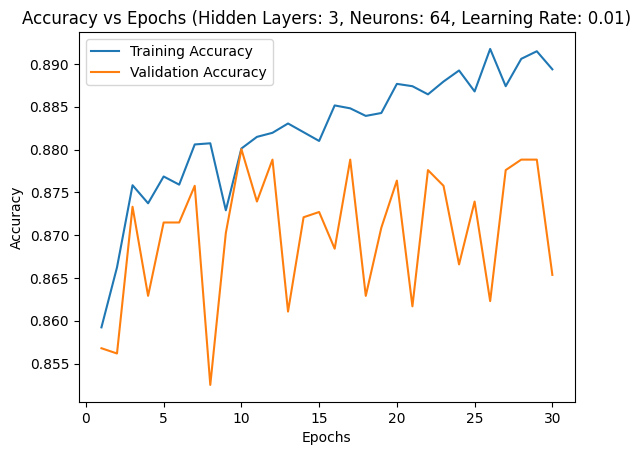

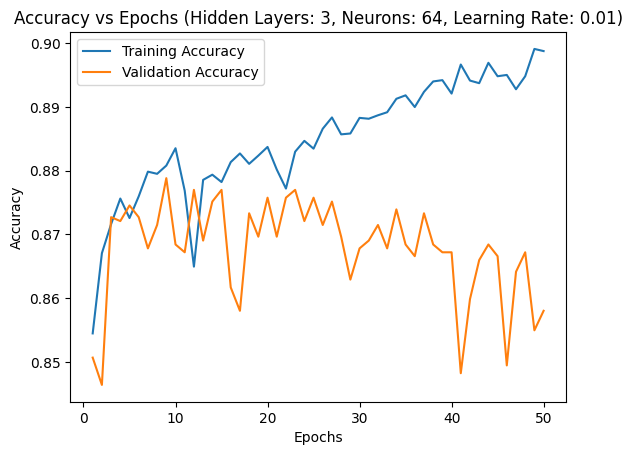

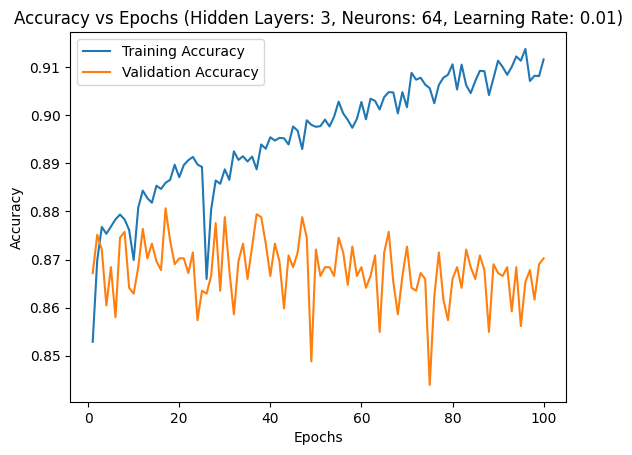

---------------------------------------------------------------


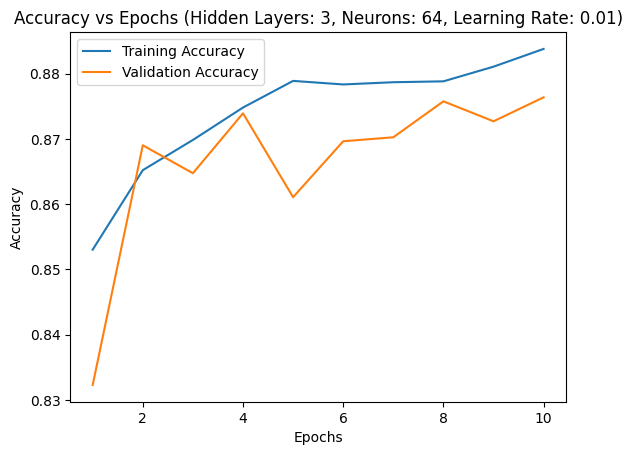

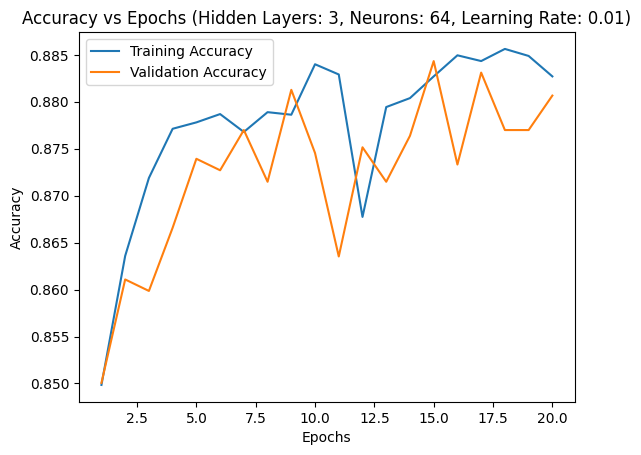

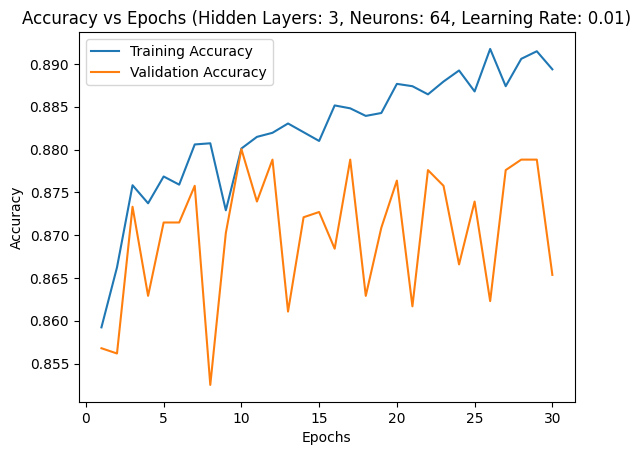

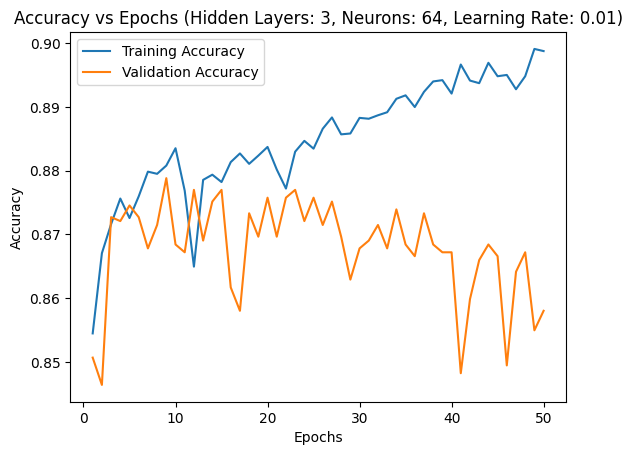

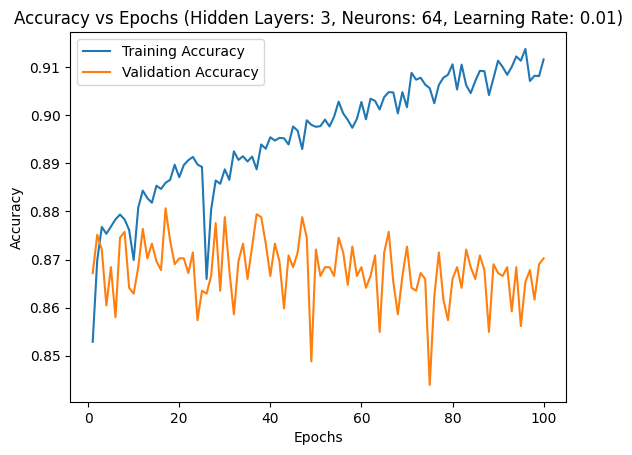

---------------------------------------------------------------


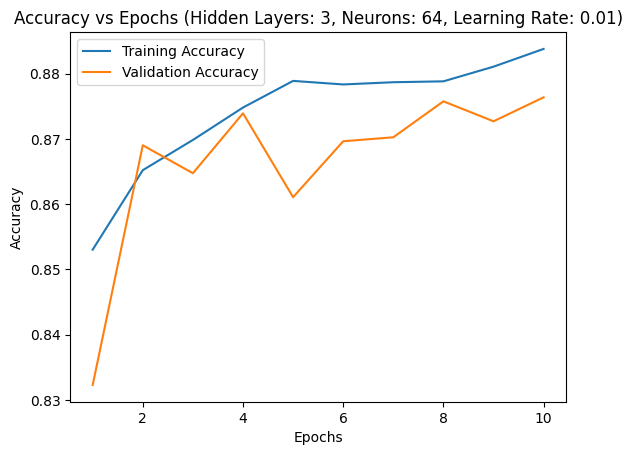

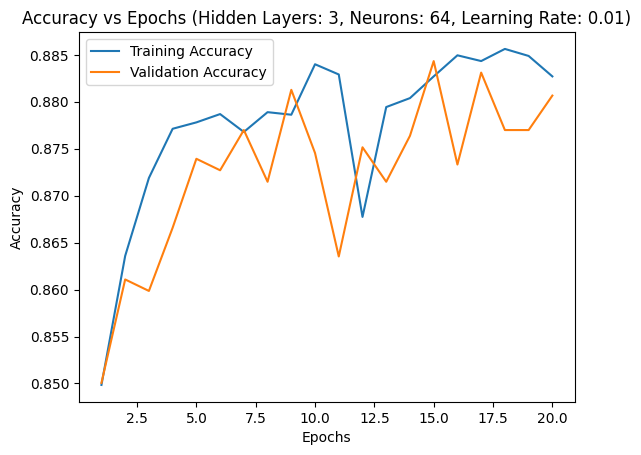

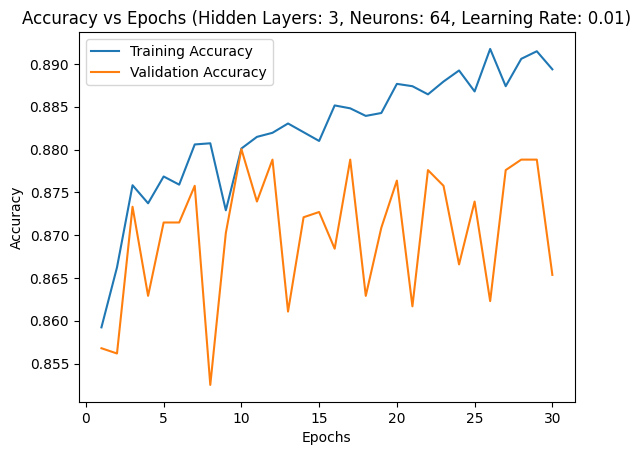

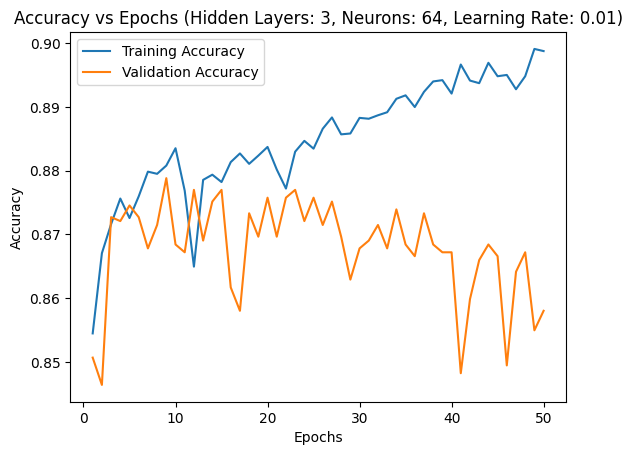

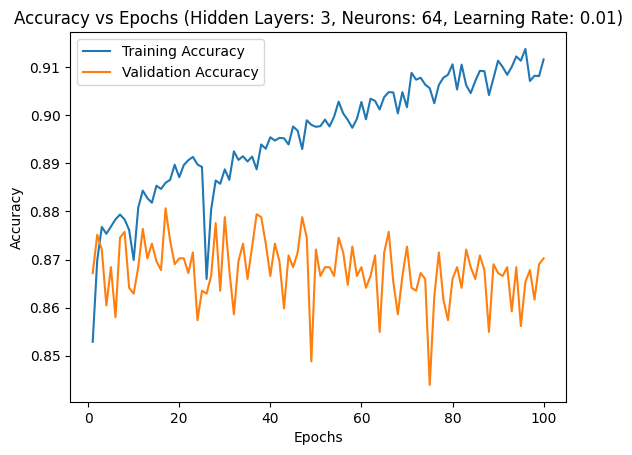

---------------------------------------------------------------


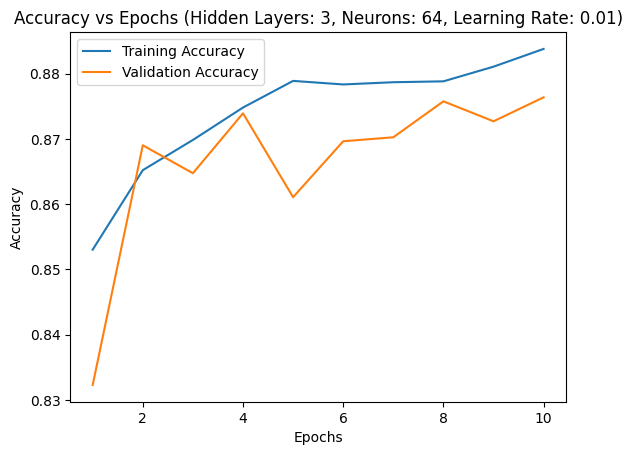

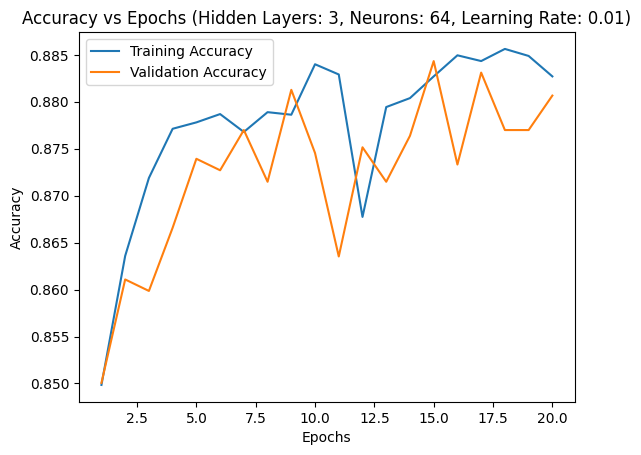

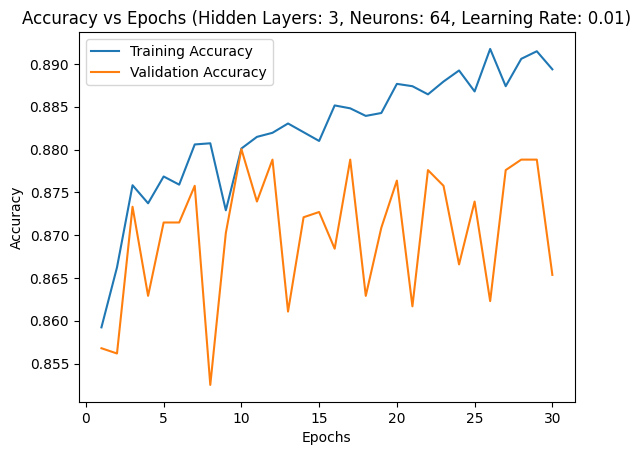

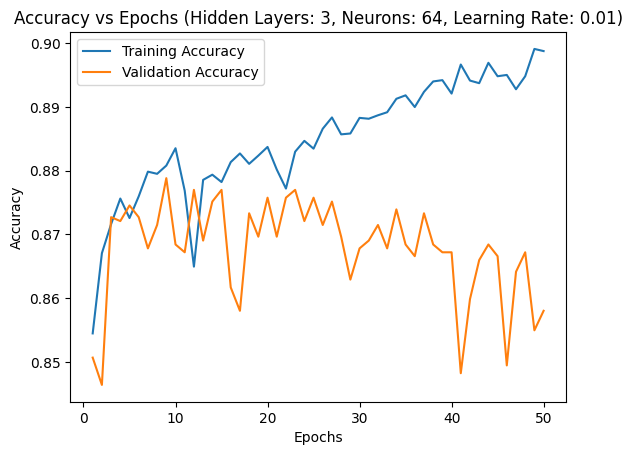

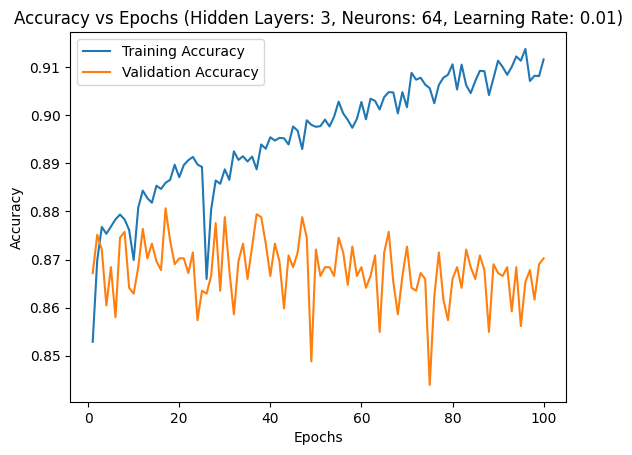

---------------------------------------------------------------


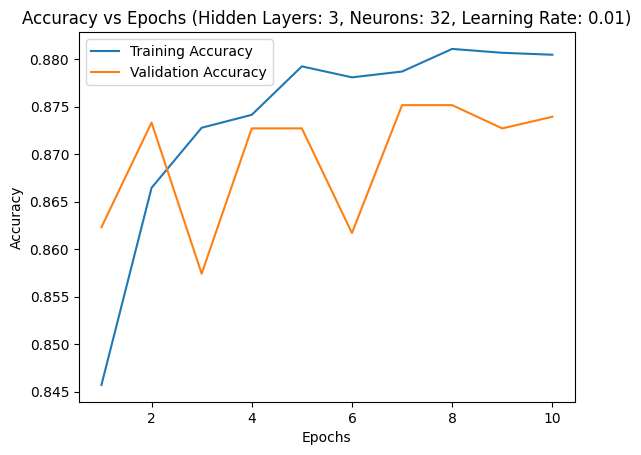

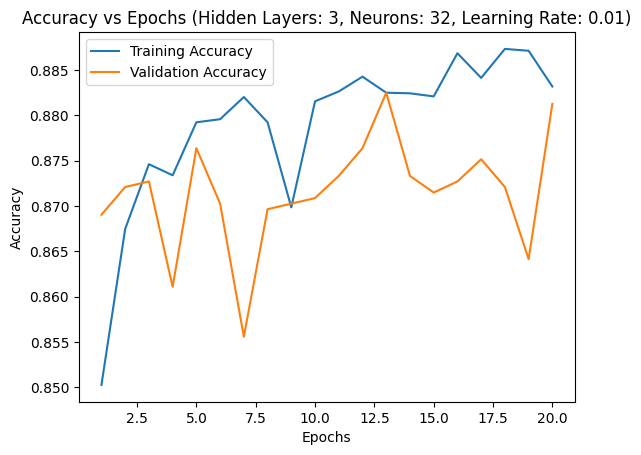

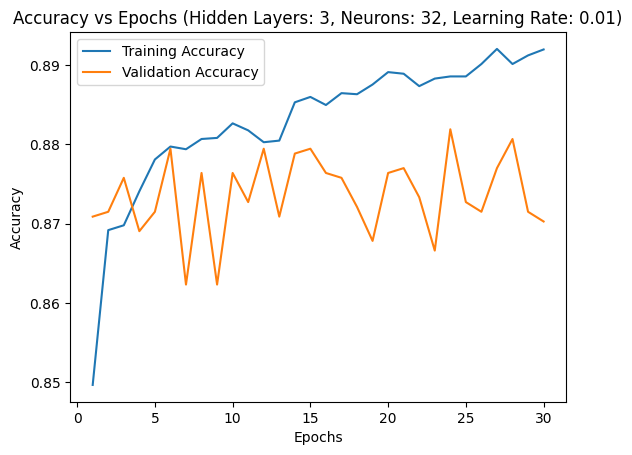

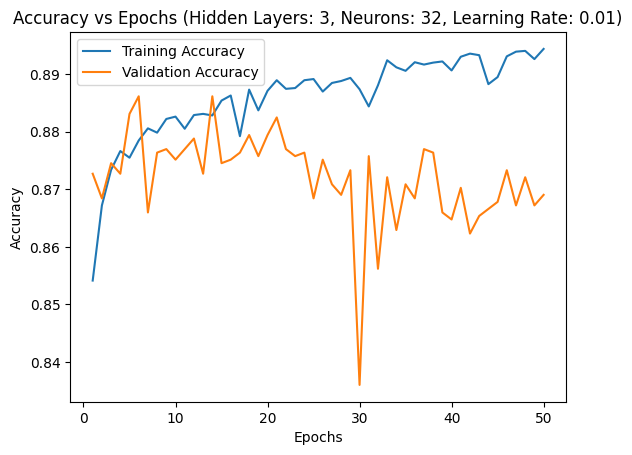

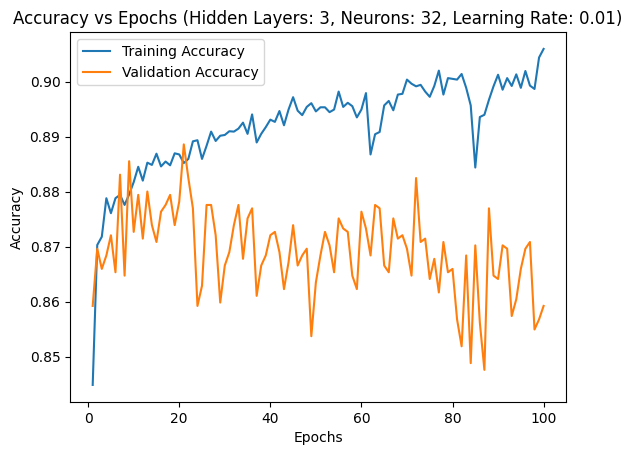

---------------------------------------------------------------


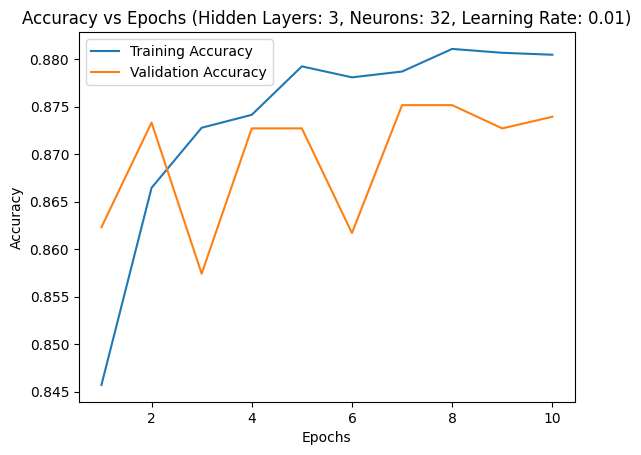

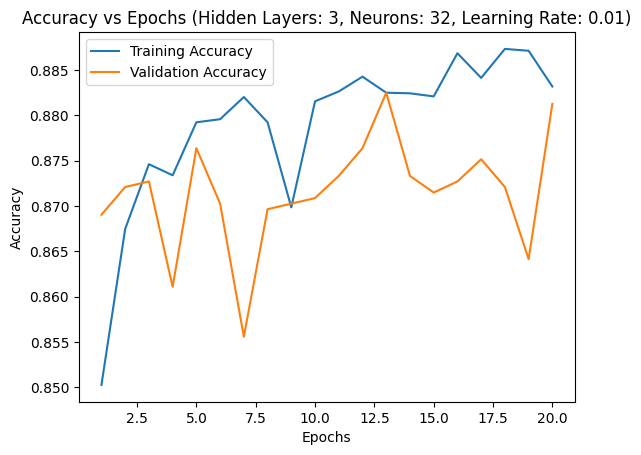

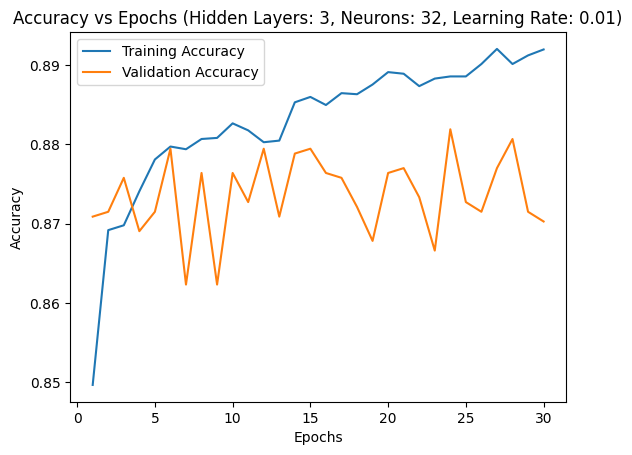

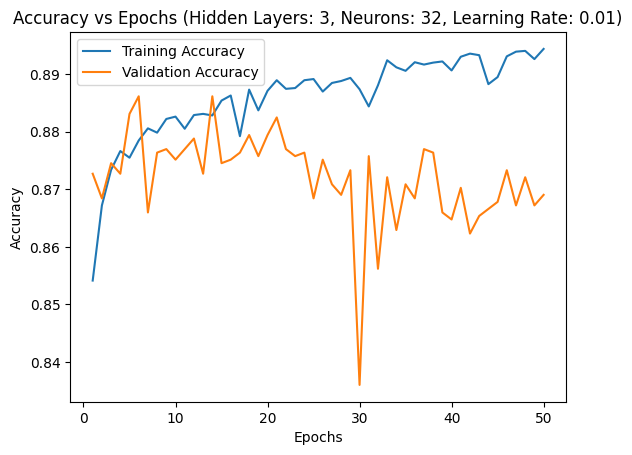

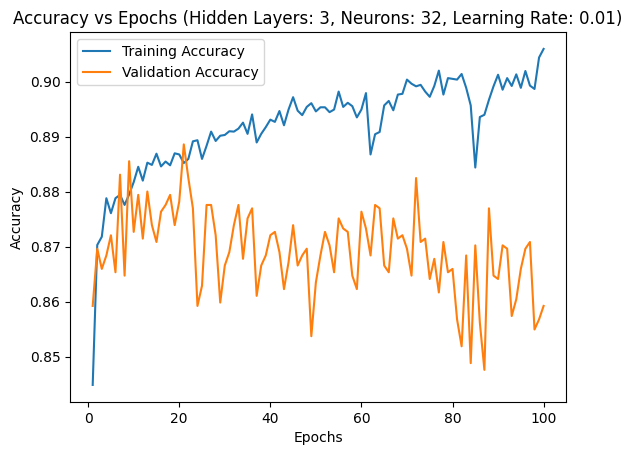

---------------------------------------------------------------


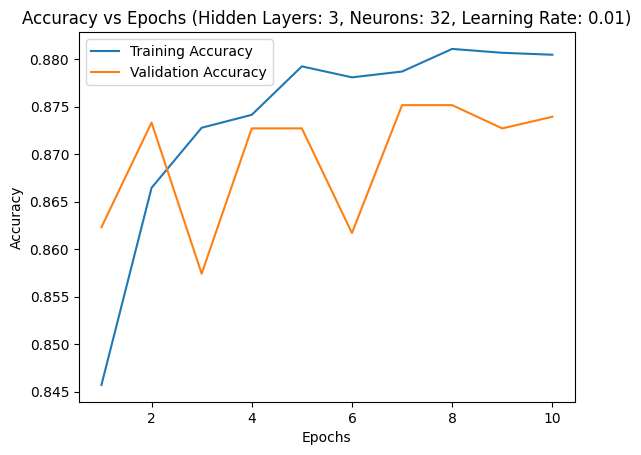

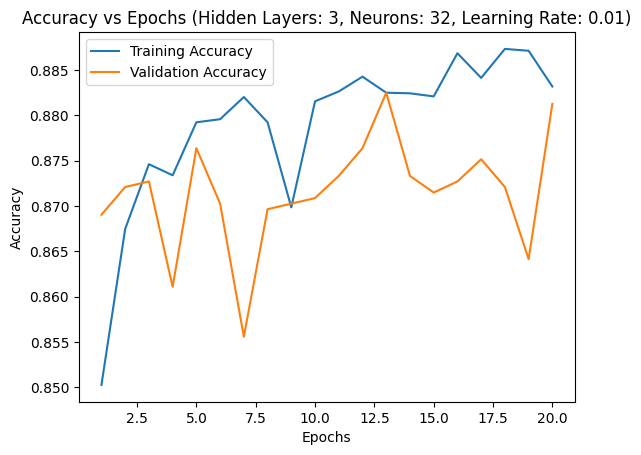

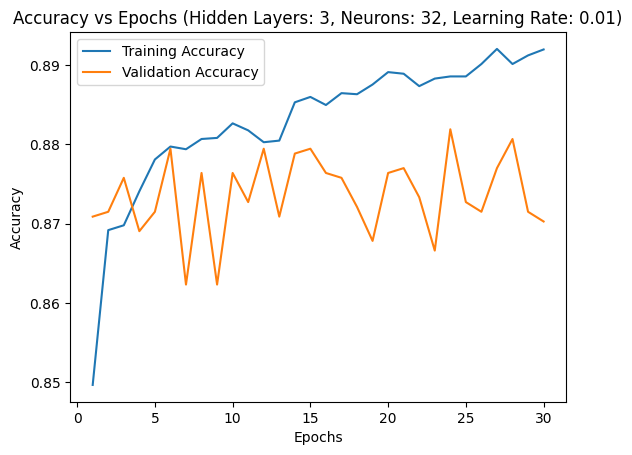

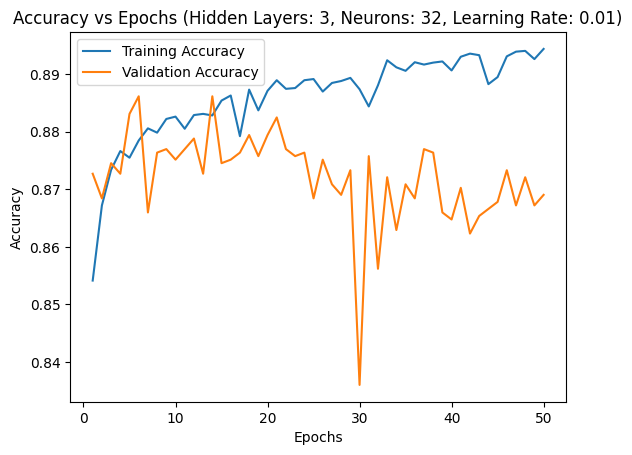

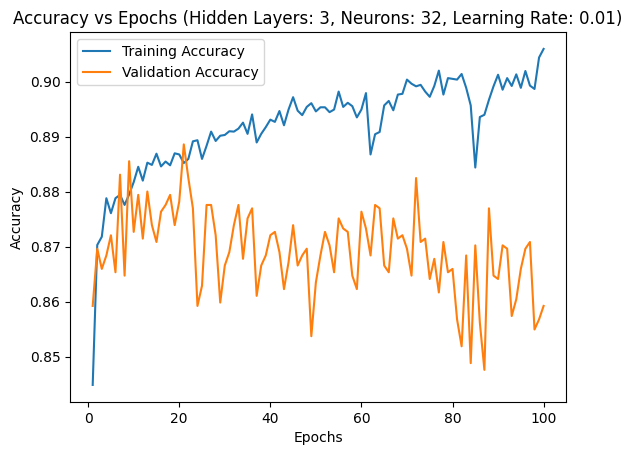

---------------------------------------------------------------


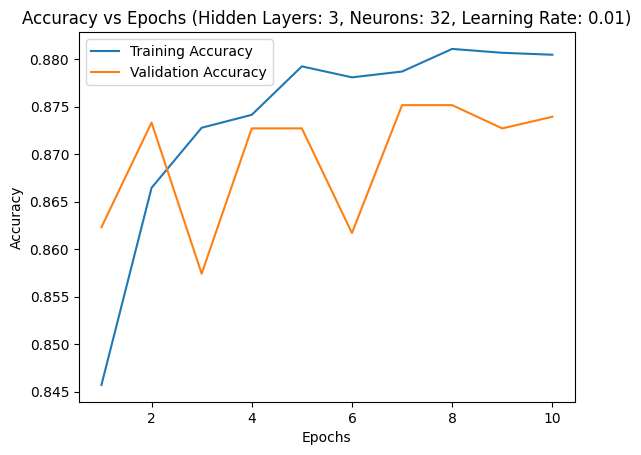

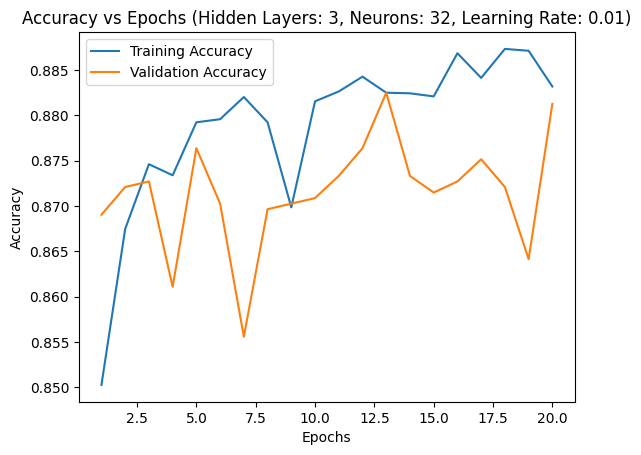

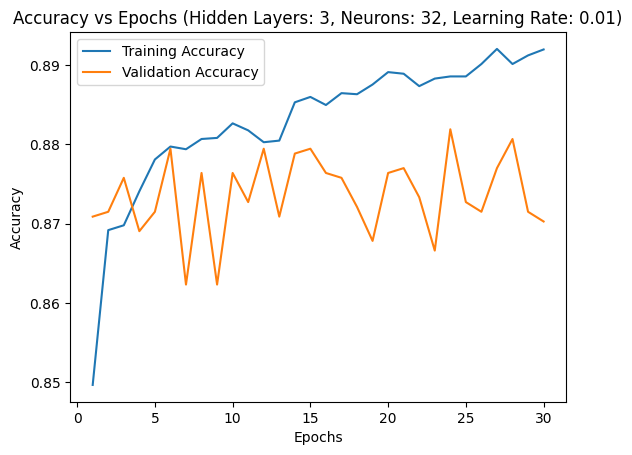

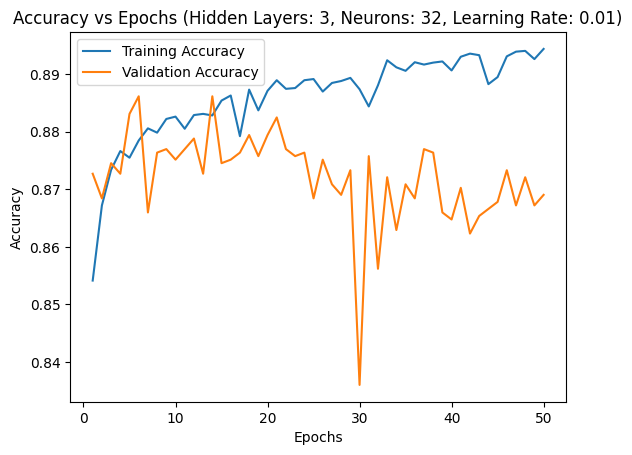

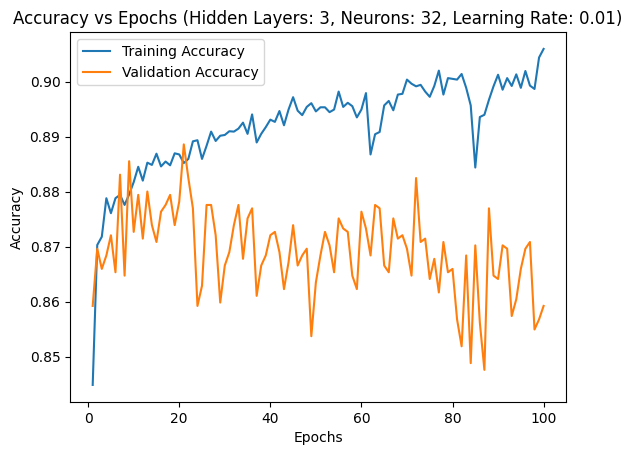

---------------------------------------------------------------


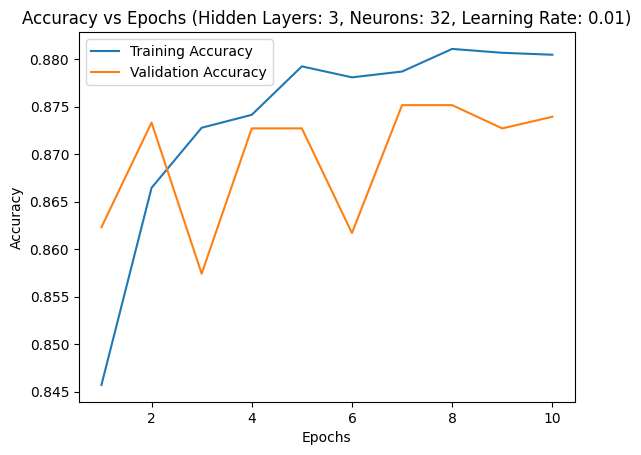

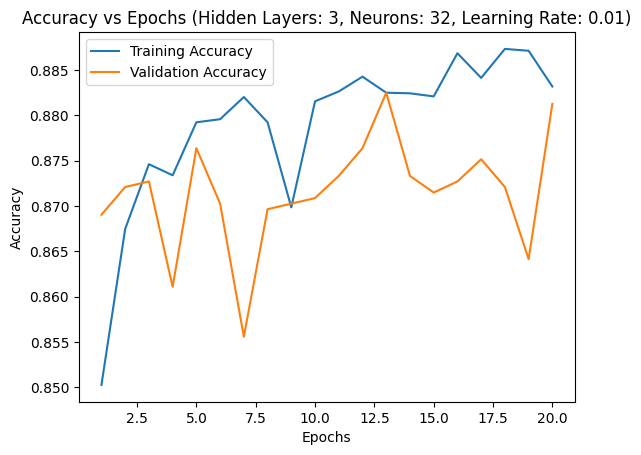

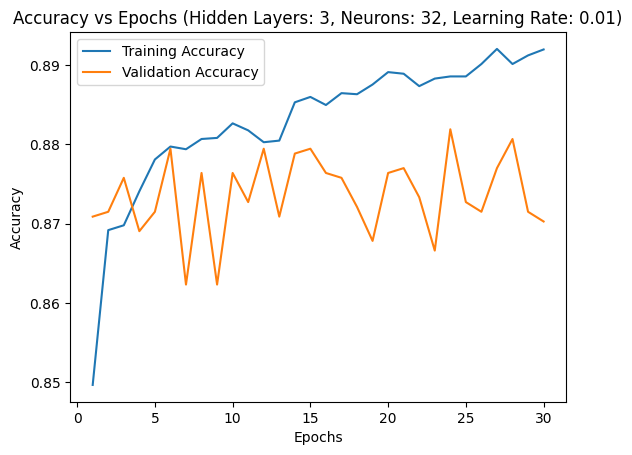

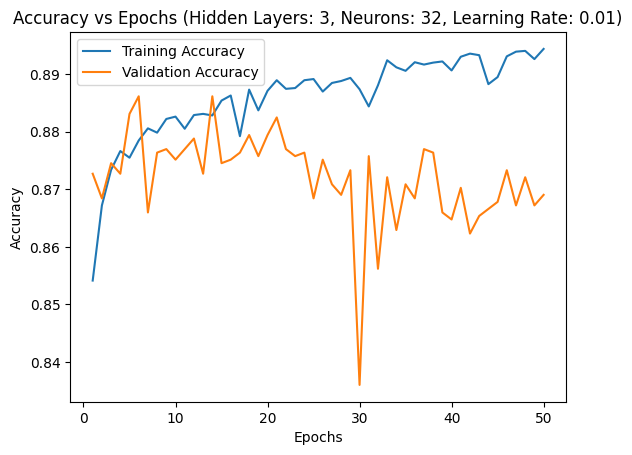

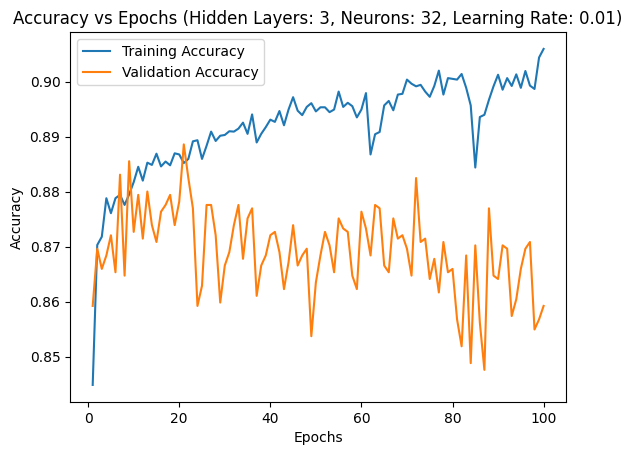

---------------------------------------------------------------


In [59]:
# plot for each layer the epochs and accuracy plot
hidden_layers = [1,2,3]
no_of_neurons = [256,128,64,32]
no_of_epochs = [10,20,30,50,100]
learning_rate = 0.01
for i in hidden_layers:
    for j in no_of_neurons:
        for k in no_of_epochs:
            plot_accuracy_vs_epochs(epochs_accuracy, i, j, k)
            print('---------------------------------------------------------------')

# The Best among all the models

In [38]:
# Group by the number of hidden layers and neurons and find the maximum validation accuracy
optimal_neurons = performance_df.groupby(['Hidden Layers', 'Neurons'])['Validation Accuracy'].max().reset_index()

# Find the configuration with the highest validation accuracy
best_configuration = performance_df.loc[performance_df['Validation Accuracy'].idxmax()]

print("Best Configuration:")
print(best_configuration)


Best Configuration:
Hidden Layers            1.000000
Neurons                 64.000000
Epochs                  10.000000
Learning Rate            0.010000
Training Loss            0.284074
Training Accuracy        0.884202
Training Precision       0.884615
Training Recall          0.882569
Validation Loss          0.315511
Validation Accuracy      0.883109
Validation Precision     0.885206
Validation Recall        0.882497
Test Loss                0.275300
Test Accuracy            0.888705
Test Recall              0.887603
Test Precision           0.891040
Name: 10, dtype: float64


##### The Best Configuration is of model with 1 hidden layer with 64 neurons and epochs as 10

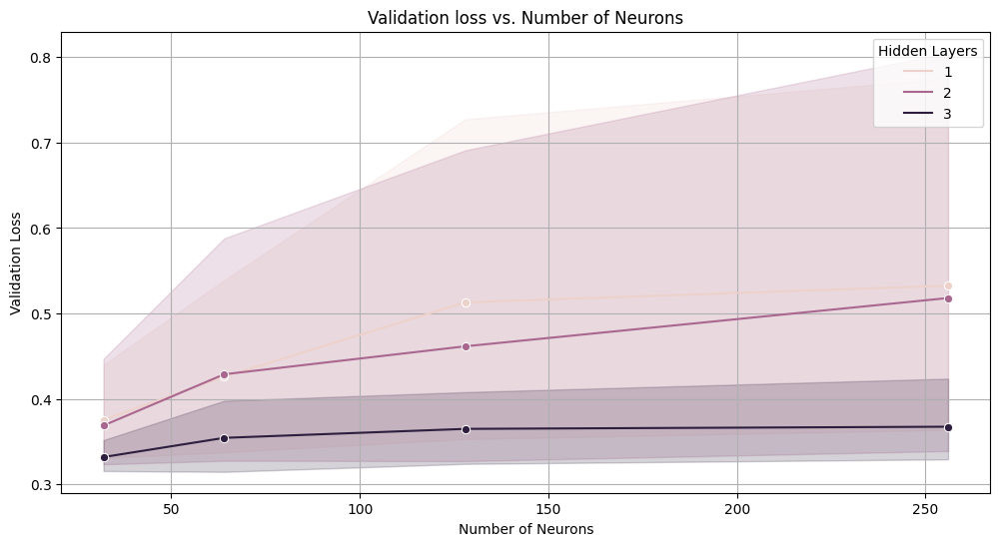

In [93]:
import matplotlib.pyplot as plt
import seaborn as sns

# Plot validation accuracy for different neuron configurations
plt.figure(figsize=(12, 6))
sns.lineplot(data=performance_df, x='Neurons', y='Validation Loss', hue='Hidden Layers', marker='o')
plt.title('Validation loss vs. Number of Neurons')
plt.xlabel('Number of Neurons')
plt.ylabel('Validation Loss')
plt.legend(title='Hidden Layers')
plt.grid(True)
plt.show()


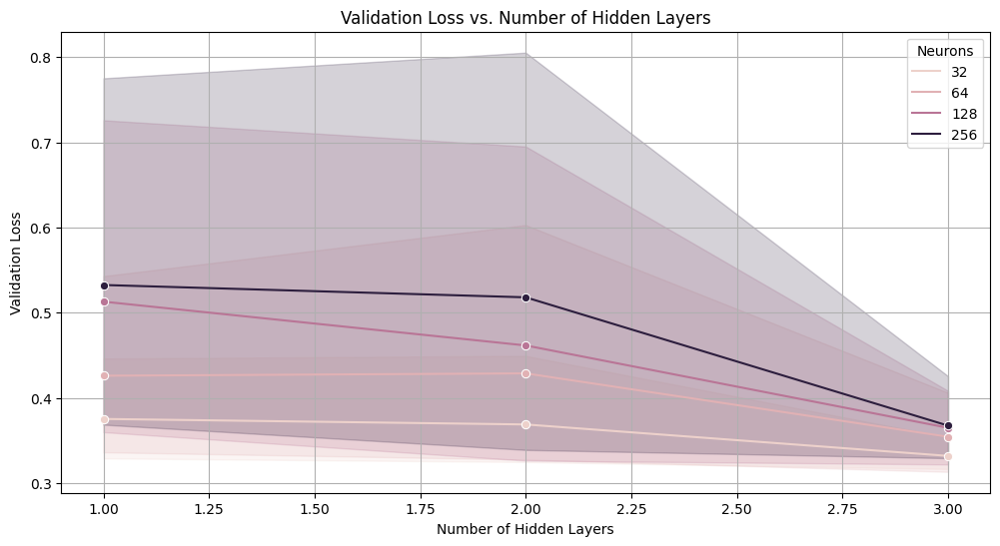

In [88]:
# Plot validation accuracy for different numbers of hidden layers
plt.figure(figsize=(12, 6))
sns.lineplot(data=performance_df, x='Hidden Layers', y='Validation Loss', hue='Neurons', marker='o')
plt.title('Validation Loss vs. Number of Hidden Layers')
plt.xlabel('Number of Hidden Layers')
plt.ylabel('Validation Loss')
plt.legend(title='Neurons')
plt.grid(True)
plt.show()


##### We see that the validation loss is minimum when the number of neurons is 32 and hidden layer is 3

## Finding the optimal Neurons for each layer

In [43]:
optimal_neurons

,Hidden Layers,Neurons,Validation Accuracy
0,1,32,0.876989
1,1,64,0.883109
2,1,128,0.878825
3,1,256,0.873929
4,2,32,0.879437
5,2,64,0.876377
6,2,128,0.870257
7,2,256,0.876377
8,3,32,0.881273
9,3,64,0.880661


In [46]:
#function to do for each layer finding the best neurons to work with
def find_best_neurons(optimal_neurons):
    hidden_layers = [1,2,3]
    for i in hidden_layers:
        hidden_df= optimal_neurons[optimal_neurons['Hidden Layers']==i]
        best_configuration = hidden_df.loc[hidden_df['Validation Accuracy'].idxmax()]
        print(f'Best Configuration for the hidden layer {i} wrt the neurons is:')
        print(best_configuration)

In [47]:
find_best_neurons(optimal_neurons)

Best Configuration for the hidden layer 1 is:
Hidden Layers           1.000000
Neurons                64.000000
Validation Accuracy     0.883109
Name: 1, dtype: float64
Best Configuration for the hidden layer 2 is:
Hidden Layers           2.000000
Neurons                32.000000
Validation Accuracy     0.879437
Name: 4, dtype: float64
Best Configuration for the hidden layer 3 is:
Hidden Layers           3.000000
Neurons                32.000000
Validation Accuracy     0.881273
Name: 8, dtype: float64


#### we can see that for the hidden layer 1 the best case is with 64 neurons and for 2 and 3 layers with the 32 neurons

## Finding the optimal Epochs for each layer

In [80]:
# Group by the number of hidden layers and neurons and find the maximum validation accuracy
optimal_epochs = performance_df.groupby(['Hidden Layers', 'Neurons','Epochs'])[['Validation Loss','Validation Accuracy']].min().reset_index()

In [81]:
optimal_epochs

,Hidden Layers,Neurons,Epochs,Validation Loss,Validation Accuracy
0,1,32,10,0.315693,0.870869
1,1,32,20,0.334544,0.873929
2,1,32,30,0.344095,0.876989
3,1,32,50,0.374829,0.863525
4,1,32,100,0.506939,0.854957
5,1,64,10,0.315511,0.883109
6,1,64,20,0.336134,0.874541
7,1,64,30,0.370131,0.879437
8,1,64,50,0.472720,0.856793
9,1,64,100,0.635286,0.851897


In [82]:
def find_best_epochs(optimal_epochs):
    hidden_layers = [1,2,3]
    for i in hidden_layers:
        hidden_df= optimal_epochs[optimal_epochs['Hidden Layers']==i]
        best_configuration = hidden_df.loc[hidden_df['Validation Loss'].idxmin()]
        print(f'Best Configuration for the hidden layer {i} wrt the epochs is:')
        print(best_configuration)

In [83]:
find_best_epochs(optimal_epochs)

Best Configuration for the hidden layer 1 wrt the epochs is:
Hidden Layers            1.000000
Neurons                128.000000
Epochs                  10.000000
Validation Loss          0.306862
Validation Accuracy      0.878825
Name: 10, dtype: float64
Best Configuration for the hidden layer 2 wrt the epochs is:
Hidden Layers           2.000000
Neurons                64.000000
Epochs                 10.000000
Validation Loss         0.307437
Validation Accuracy     0.876377
Name: 25, dtype: float64
Best Configuration for the hidden layer 3 wrt the epochs is:
Hidden Layers           3.000000
Neurons                64.000000
Epochs                 20.000000
Validation Loss         0.305780
Validation Accuracy     0.880661
Name: 46, dtype: float64


##### The optimal epochs for layer 1 and layer 2 comes to be 10 and for layer 3 with 20

### Evaluating Each Model accuracy,precision and recall and printing the classification report for each wrt Test Data

In [94]:
# Function to display classification report for each model
def display_classification_reports(classification_reports, hidden_layer, neurons, epochs, learning_rate):
    for record in classification_reports:
        hl, n, ep, lr, report = record
        if hl == hidden_layer and n == neurons and ep == epochs and lr == learning_rate:
            print(f'Classification Report (Hidden Layers: {hl}, Neurons: {n}, Epochs: {ep}, Learning Rate: {lr})')
            print(report)
            print('---------------------------------------------------------------')

In [95]:
# show for each the classification report
for i in hidden_layers:
    for j in no_of_neurons:
        for k in no_of_epochs:
            display_classification_reports(test_set_classification_report, i, j, k, learning_rate)
            print('---------------------------------------------------------------')

Classification Report (Hidden Layers: 1, Neurons: 256, Epochs: 10, Learning Rate: 0.01)
              precision    recall  f1-score   support

           0       0.92      0.92      0.92       563
           1       0.85      0.78      0.82       315
           2       1.00      1.00      1.00       207
           3       0.85      0.88      0.87       730

    accuracy                           0.89      1815
   macro avg       0.91      0.90      0.90      1815
weighted avg       0.89      0.89      0.89      1815

---------------------------------------------------------------
---------------------------------------------------------------
Classification Report (Hidden Layers: 1, Neurons: 256, Epochs: 20, Learning Rate: 0.01)
              precision    recall  f1-score   support

           0       0.92      0.92      0.92       563
           1       0.81      0.83      0.82       315
           2       1.00      1.00      1.00       207
           3       0.87      0.85      0.86 

#### Seeing the classification report through all the models for class 2 i.e GoalKeeper the Prediction seems to be good followed by Defender,Forward and then MidFielder

In [96]:
Test_set_data = performance_df[['Hidden Layers','Neurons','Epochs','Learning Rate','Test Loss','Test Accuracy','Test Recall','Test Precision']]
Test_set_data

,Hidden Layers,Neurons,Epochs,Learning Rate,Test Loss,Test Accuracy,Test Recall,Test Precision
0,1,256,10,0.01,0.267382,0.891460,0.890358,0.892325
1,1,256,20,0.01,0.302701,0.887052,0.885950,0.888889
2,1,256,30,0.01,0.370954,0.862259,0.861157,0.863059
3,1,256,50,0.01,0.376330,0.869972,0.868870,0.869829
4,1,256,100,0.01,0.565538,0.871074,0.869972,0.872858
5,1,128,10,0.01,0.268157,0.894215,0.894215,0.895201
6,1,128,20,0.01,0.308991,0.879890,0.878788,0.882678
7,1,128,30,0.01,0.324514,0.880441,0.880441,0.882385
8,1,128,50,0.01,0.426712,0.874380,0.874380,0.874862
9,1,128,100,0.01,0.724202,0.858953,0.858953,0.860850


In [105]:
optimal_loss = Test_set_data.groupby(['Hidden Layers', 'Neurons','Epochs'])['Test Loss'].min().reset_index()
optimal_accuracy = Test_set_data.groupby(['Hidden Layers', 'Neurons','Epochs'])['Test Accuracy'].max().reset_index()
optimal_precision = Test_set_data.groupby(['Hidden Layers', 'Neurons','Epochs'])['Test Precision'].max().reset_index()

In [108]:
def find_best_test_loss(optimal_loss):
    hidden_layers = [1,2,3]
    for i in hidden_layers:
        hidden_df= optimal_loss[optimal_loss['Hidden Layers']==i]
        best_configuration = hidden_df.loc[hidden_df['Test Loss'].idxmin()]
        print(f'Best Configuration for the hidden layer {i} wrt the Test Loss is:')
        print(best_configuration)
def find_best_test_accuracy(optimal_accuracy):
    hidden_layers = [1,2,3]
    for i in hidden_layers:
        hidden_df= optimal_accuracy[optimal_accuracy['Hidden Layers']==i]
        best_configuration = hidden_df.loc[hidden_df['Test Accuracy'].idxmin()]
        print(f'Best Configuration for the hidden layer {i} wrt the Test Accuracy is:')
        print(best_configuration)
def find_best_test_precision(optimal_precision):
    hidden_layers = [1,2,3]
    for i in hidden_layers:
        hidden_df= optimal_precision[optimal_precision['Hidden Layers']==i]
        best_configuration = hidden_df.loc[hidden_df['Test Precision'].idxmin()]
        print(f'Best Configuration for the hidden layer {i} wrt the Test Precision is:')
        print(best_configuration)

In [103]:
find_best_test_loss(optimal_loss)

Best Configuration for the hidden layer 1 wrt the Test Loss is:
Hidden Layers     1.000000
Neurons          32.000000
Epochs           20.000000
Test Loss         0.266046
Name: 1, dtype: float64
Best Configuration for the hidden layer 2 wrt the Test Loss is:
Hidden Layers     2.000000
Neurons          32.000000
Epochs           10.000000
Test Loss         0.263045
Name: 20, dtype: float64
Best Configuration for the hidden layer 3 wrt the Test Loss is:
Hidden Layers      3.00000
Neurons          128.00000
Epochs            30.00000
Test Loss          0.26565
Name: 52, dtype: float64


#### So with respect to test set Loss the best model for Hidden Layer 1 is with 32 neurons and 20 epochs and for layer 2 is 32 neurons and 10 epochs and for 3 layer is 128 neurons and 30 epochs

In [109]:
find_best_test_accuracy(optimal_accuracy)

Best Configuration for the hidden layer 1 wrt the Test Accuracy is:
Hidden Layers      1.000000
Neurons          128.000000
Epochs           100.000000
Test Accuracy      0.858953
Name: 14, dtype: float64
Best Configuration for the hidden layer 2 wrt the Test Accuracy is:
Hidden Layers      2.000000
Neurons          128.000000
Epochs           100.000000
Test Accuracy      0.856198
Name: 34, dtype: float64
Best Configuration for the hidden layer 3 wrt the Test Accuracy is:
Hidden Layers      3.00000
Neurons          128.00000
Epochs            10.00000
Test Accuracy      0.87438
Name: 50, dtype: float64


#### So with respect to test set Accuracy the best model for Hidden Layer 1 is with 128 neurons and 100 epochs and for layer 2 is 128 neurons and 100 epochs and for 3 layer is 128 neurons and 10 epochs

In [110]:
find_best_test_precision(optimal_precision)

Best Configuration for the hidden layer 1 wrt the Test Precision is:
Hidden Layers       1.00000
Neurons           128.00000
Epochs            100.00000
Test Precision      0.86085
Name: 14, dtype: float64
Best Configuration for the hidden layer 2 wrt the Test Precision is:
Hidden Layers       2.00000
Neurons           128.00000
Epochs            100.00000
Test Precision      0.85667
Name: 34, dtype: float64
Best Configuration for the hidden layer 3 wrt the Test Precision is:
Hidden Layers       3.000000
Neurons           128.000000
Epochs             10.000000
Test Precision      0.874862
Name: 50, dtype: float64


#### So with respect to test set Precision the best model for Hidden Layer 1 is with 128 neurons and 100 epochs and for layer 2 is 128 neurons and 100 epochs and for 3 layer is 128 neurons and 10 epochs